In [1]:
from astropy.io import fits
import os
import matplotlib.pyplot as plt
import numpy as np
from scipy.optimize import curve_fit
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline
np.seterr(divide='ignore', invalid='ignore');
plt.rcParams.update({'figure.max_open_warning': 0})
import scipy.stats as stats
import astropy.units as u
from astropy.table import Table, Column, MaskedColumn, join
from tqdm import tqdm
from bisect import bisect_left
c = 2.998e10
k = 1.38e-16
h = 6.626e-27
plt.rcParams.update({'font.size': 22})
halpha = 6564.61
hbeta = 4862.68
hgamma = 4341.68
hdelta = 4102.89
plt.rcParams['figure.figsize'] = [15, 10]
from IPython.display import Audio, display
def allDone():
    display(Audio(filename='beep.mp3', autoplay=True))
from scipy.interpolate import interp1d,InterpolatedUnivariateSpline
import lmfit

def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return idx
import emcee
import corner
import numdifftools
from scipy.ndimage import interpolation
from scipy.signal import medfilt
from scipy.interpolate import interp1d
from multiprocessing import Pool
import pickle
import h5py
import scipy

In [2]:
def get_spectrum(source_id):
    path = wdtable[wdtable['source_id'] == source_id][0]['specpath']
    try:
        f = fits.open(path)
        flux = f[1].data['flux']
        loglam = f[1].data['loglam']
        f.close()
        lam = 10**loglam
    except:
        print('Spectrum file missing...')
        return
    return lam,flux

In [3]:
wdtable = Table.read('linefits.fits')

In [4]:
wdtable['g_abs'] = wdtable['phot_g_mean_mag'] + 5*np.log10(wdtable['parallax']) - 10
wdtable['bp_rp'] = wdtable['phot_bp_mean_mag'] - wdtable['phot_rp_mean_mag']

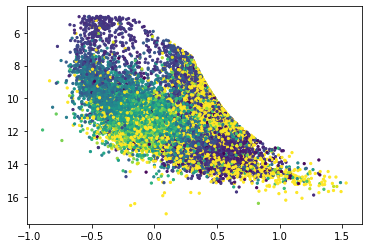

In [5]:
plt.scatter(wdtable['bp_rp'],wdtable['g_abs'], s = 5, c = wdtable['fwhm_b'],vmax=100)
plt.gca().invert_yaxis()

In [6]:
DA = (wdtable['spectral_class'] == 'DA')*(~np.isnan(wdtable['Teff']))*(~np.isnan(wdtable['log_g']))*\
        (wdtable['S/N'] > 20) * (wdtable['Teff'] < 50000)
DB = (wdtable['spectral_class'] == 'DB')*(~np.isnan(wdtable['Teff']))*(~np.isnan(wdtable['log_g']))*\
        (wdtable['S/N'] > 5) * (wdtable['Teff'] < 50000)
DAwdtable = wdtable[DA]
DBwdtable = wdtable[DB]

print(len(DAwdtable))
print(len(DBwdtable))

4099
1102


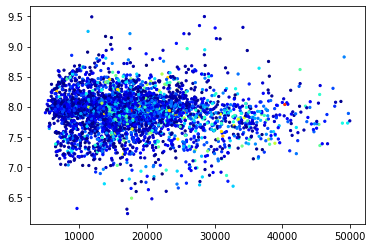

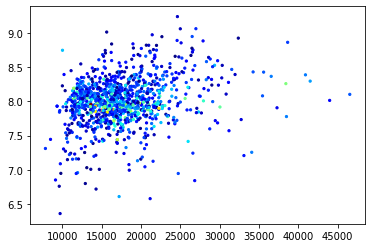

In [7]:
plt.scatter(DAwdtable['Teff'],DAwdtable['log_g'], s = 5, c = DAwdtable['S/N'], vmax = 100, cmap = 'jet')
plt.figure()
plt.scatter(DBwdtable['Teff'],DBwdtable['log_g'], s = 5, c = DBwdtable['S/N'], cmap = 'jet')

In [8]:
DAinterpfluxs = [];
lamgrid = np.arange(4000,7000)
for i in tqdm(range(len(DAwdtable))):
    spec = get_spectrum(DAwdtable['source_id'][i])
    lam  = spec[0]
    flux = spec[1]
    trans = ((DAwdtable['center_b'][i] - hbeta)+(DAwdtable['center_a'][i]-halpha))/2
    shiftedflux = interpolation.shift(flux,-trans,cval=np.nan)
    func = interp1d(lam,shiftedflux,kind='linear',assume_sorted = False,fill_value='extrapolate')
    interpflux = func(lamgrid)
    DAinterpfluxs.append(interpflux)

100%|██████████| 4099/4099 [13:00<00:00,  5.25it/s]  


In [9]:
DBinterpfluxs = [];
lamgrid = np.arange(4000,7000)
for i in tqdm(range(len(DBwdtable))):
    spec = get_spectrum(DBwdtable['source_id'][i])
    lam  = spec[0]
    flux = spec[1]
    trans = ((DBwdtable['center_b'][i] - hbeta)+(DBwdtable['center_a'][i]-halpha))/2
    shiftedflux = interpolation.shift(flux,-trans,cval=np.nan)
    func = interp1d(lam,shiftedflux,kind='linear',assume_sorted = False,fill_value='extrapolate')
    interpflux = func(lamgrid)
    DBinterpfluxs.append(interpflux)

100%|██████████| 1102/1102 [04:00<00:00,  8.93it/s]


In [10]:
DAspectra = np.asarray(DAinterpfluxs)
DBspectra = np.asarray(DBinterpfluxs)

where = np.isnan(DAspectra)
DAspectra[where] = 0
where = np.isnan(DBspectra)
DBspectra[where] = 0

In [11]:
lam = lamgrid
lamgrid = lam
lines = ((lam > hbeta-150) & (lam < hbeta + 150)) | ((lam > halpha-100) & (lam < halpha + 100))\
        | ((lam > hgamma-90) & (lam < hgamma + 120))| ((lam > hdelta-70) & (lam < hdelta + 70))

mask = ~lines
def quadratic(array,c1,c2,c3,c4):
    return c1 + c2*array + c3*array**2 + c4*array**3

In [12]:
DAnormspec = [];

for i in tqdm(range(len(DAspectra))):
    p,cov = curve_fit(quadratic,lamgrid[mask],DAspectra[i][mask],p0=[-25,1e-2,1e-5,1e-10])
    contcorr = (DAspectra[i]/quadratic(lam,p[0],p[1],p[2],p[3]))
    skylinemask = (lamgrid > 5578.5 - 10)*(lamgrid < 5578.5 + 10) + (lamgrid > 5894.6 - 10)*(lamgrid < 5894.6 + 10)\
        + (lamgrid > 6301.7 - 10)*(lamgrid < 6301.7 + 10) + (lamgrid > 7246.0 - 10)*(lamgrid < 7246.0 + 10)
    contcorr[skylinemask] = 1
    where = np.isnan(contcorr)
    contcorr[where] = 1
    DAnormspec.append(contcorr)
DAnormspec = np.asarray(DAnormspec)
len(DAnormspec)

100%|██████████| 4099/4099 [00:11<00:00, 368.22it/s]


4099

In [13]:
DBnormspec = [];

for i in tqdm(range(len(DBspectra))):
    p,cov = curve_fit(quadratic,lamgrid[mask],DBspectra[i][mask],p0=[-25,1e-2,1e-5,1e-10])
    contcorr = (DBspectra[i]/quadratic(lam,p[0],p[1],p[2],p[3]))
    skylinemask = (lamgrid > 5578.5 - 10)*(lamgrid < 5578.5 + 10) + (lamgrid > 5894.6 - 10)*(lamgrid < 5894.6 + 10)\
        + (lamgrid > 6301.7 - 10)*(lamgrid < 6301.7 + 10) + (lamgrid > 7246.0 - 10)*(lamgrid < 7246.0 + 10)
    contcorr[skylinemask] = 1
    where = np.isnan(contcorr)
    contcorr[where] = 1
    DBnormspec.append(contcorr)
DBnormspec = np.asarray(DBnormspec)
len(DBnormspec)

100%|██████████| 1102/1102 [00:02<00:00, 372.01it/s]


1102

In [14]:
where = (DAnormspec > 1.5) + (DAnormspec < 0)
DAnormspec[where] = 1

where = (DBnormspec > 1.5) + (DBnormspec < 0)
DBnormspec[where] = 1

In [15]:
import numpy as np
from keras.models import *
from keras.layers import *
from keras.optimizers import *
from keras.callbacks import ModelCheckpoint, LearningRateScheduler
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import normalize,scale,MinMaxScaler,StandardScaler
import multiprocessing

Using TensorFlow backend.


In [16]:
DAteffs = np.asarray(DAwdtable['Teff'])
DAloggs = np.asarray(DAwdtable['log_g'])

In [17]:
DAsc = MinMaxScaler()
DAmsc = MinMaxScaler()
DAX = DAsc.fit_transform(np.stack((DAteffs,DAloggs)).transpose())
DAt = DAmsc.fit_transform(DAnormspec)

In [20]:
def DA_generator():
    x = Input(shape=(2,))
    y = Dense(256,activation='relu')(x)
    y = Dropout(0.5)(y)
    y = Dense(256,activation='relu')(y)
    y = Dropout(0.5)(y)
    out = Dense(3000,activation='linear')(y)
    
    model = Model(inputs = x, outputs = out)
    model.compile(optimizer = Adam(lr=0.0001), loss = 'mse', \
                  metrics = ['mean_absolute_percentage_error'])
    return model
DAmodel = DA_generator()
print(DAmodel.summary())
DAmodel.load_weights('DA_model.h5')

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         (None, 2)                 0         
_________________________________________________________________
dense_7 (Dense)              (None, 256)               768       
_________________________________________________________________
dropout_5 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_8 (Dense)              (None, 256)               65792     
_________________________________________________________________
dropout_6 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_9 (Dense)              (None, 3000)              771000    
Total params: 837,560
Trainable params: 837,560
Non-trainable params: 0
_________________________________________________________________
None

In [21]:
DBteffs = np.asarray(DBwdtable['Teff'])
DBloggs = np.asarray(DBwdtable['log_g'])

DBsc = MinMaxScaler()
DBmsc = MinMaxScaler()
DBX = DBsc.fit_transform(np.stack((DBteffs,DBloggs)).transpose())
DBt = DBmsc.fit_transform(DBnormspec)

def DB_generator():
    x = Input(shape=(2,))
    y = Dense(256,activation='relu')(x)
    y = Dropout(0.5)(y)
    y = Dense(256,activation='relu')(y)
    y = Dropout(0.5)(y)
    out = Dense(3000,activation='linear')(y)
    
    model = Model(inputs = x, outputs = out)
    model.compile(optimizer = Adam(lr=0.0001), loss = 'mse', \
                  metrics = ['mean_absolute_percentage_error'])
    return model
DBmodel = DB_generator()
print(DBmodel.summary())
DBmodel.load_weights('DB_model.h5')

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         (None, 2)                 0         
_________________________________________________________________
dense_10 (Dense)             (None, 256)               768       
_________________________________________________________________
dropout_7 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_11 (Dense)             (None, 256)               65792     
_________________________________________________________________
dropout_8 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_12 (Dense)             (None, 3000)              771000    
Total params: 837,560
Trainable params: 837,560
Non-trainable params: 0
_________________________________________________________________
None

In [22]:
metabatches = 100
epoch = 50
DAhistory = [];
DBhistory = [];
print('Training for %i total epochs'%(metabatches*epoch))
for jj in tqdm(range(metabatches)):
    batch = len(DAwdtable)
    for i in (range(epoch)):
        h = DAmodel.fit(DAX,DAt,epochs=1,verbose=0,batch_size=batch)
        DAhistory.append(h.history['loss'][0])
    DAmodel.save_weights('DA_model.h5')
    batch = len(DAwdtable)
    for i in (range(epoch)):
        h = DBmodel.fit(DBX,DBt,epochs=1,verbose=0,batch_size=batch)
        DBhistory.append(h.history['loss'][0])
    DBmodel.save_weights('DB_model.h5')

  0%|          | 0/100 [00:00<?, ?it/s]

Training for 5000 total epochs


 18%|█▊        | 18/100 [05:35<25:21, 18.56s/it]

KeyboardInterrupt: 

Text(0.5, 1.0, '0.04 percent improvement')

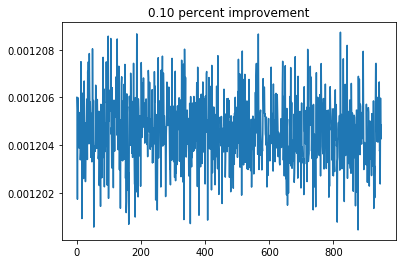

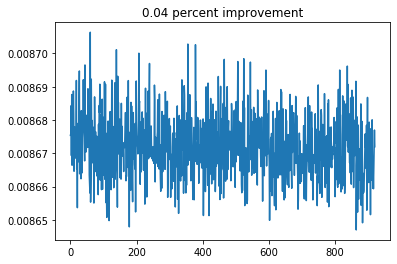

In [23]:
plt.plot(DAhistory)
plt.title('%.2f percent improvement' % -(((DAhistory[-1]-DAhistory[0])/DAhistory[0])*100))
plt.figure()
plt.plot(DBhistory)
plt.title('%.2f percent improvement' % -(((DBhistory[-1]-DBhistory[0])/DBhistory[0])*100))

Text(0.5, 1.0, 'H-Beta Line')

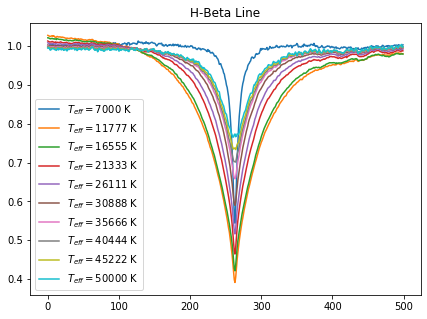

In [22]:
plt.figure(figsize=(7,5))
ts = np.linspace(7000,50000,10)
ls = np.linspace(8,8,10)
samples = DAsc.transform(np.stack((ts,ls)).transpose())
gens = DAmsc.inverse_transform(DAmodel.predict(samples))
tscores = (ts - np.min(ts))/(np.max(ts) - np.min(ts))
for i in range(len(gens)):
    plt.plot(gens[i][600:1100],label='$T_{eff} = %i$ K'%ts[i])
plt.legend(fontsize=10)
plt.title('H-Beta Line')

Text(0.5, 1.0, 'H-Beta Line')

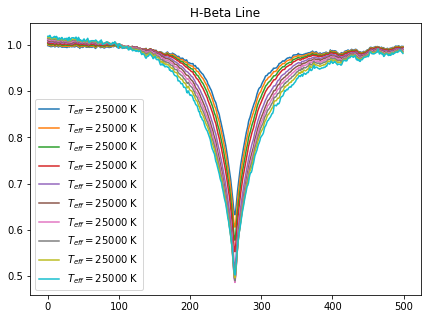

In [23]:
plt.figure(figsize=(7,5))
ts = np.linspace(25000,25000,10)
ls = np.linspace(7,9,10)
samples = DAsc.transform(np.stack((ts,ls)).transpose())
gens = DAmsc.inverse_transform(DAmodel.predict(samples))
tscores = (ts - np.min(ts))/(np.max(ts) - np.min(ts))
for i in range(len(gens)):
    plt.plot(gens[i][600:1100],label='$T_{eff} = %i$ K'%ts[i])
plt.legend(fontsize=10)
plt.title('H-Beta Line')

Text(0.5, 1.0, 'H-Beta Line')

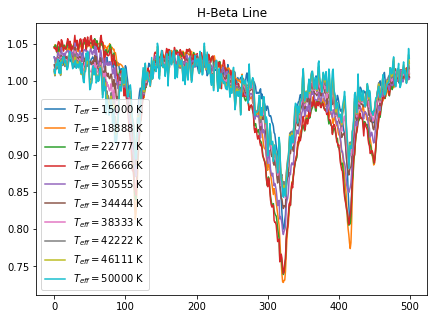

In [24]:
plt.figure(figsize=(7,5))
ts = np.linspace(15000,50000,10)
ls = np.linspace(8,8,10)
samples = DBsc.transform(np.stack((ts,ls)).transpose())
gens = DBmsc.inverse_transform(DBmodel.predict(samples))
tscores = (ts - np.min(ts))/(np.max(ts) - np.min(ts))
for i in range(len(gens)):
    plt.plot(gens[i][600:1100],label='$T_{eff} = %i$ K'%ts[i])
plt.legend(fontsize=10)
plt.title('H-Beta Line')

Text(0.5, 1.0, 'H-Beta Line')

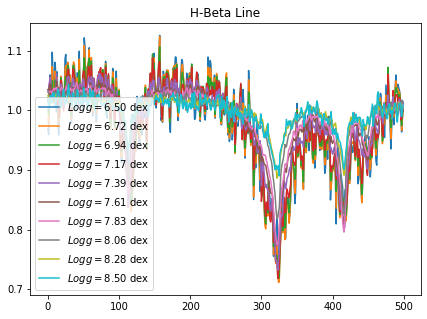

In [25]:
plt.figure(figsize=(7,5))
ts = np.linspace(15000,15000,10)
ls = np.linspace(6.5,8.5,10)
samples = DBsc.transform(np.stack((ts,ls)).transpose())
gens = DBmsc.inverse_transform(DBmodel.predict(samples))
tscores = (ts - np.min(ts))/(np.max(ts) - np.min(ts))
for i in range(len(gens)):
    plt.plot(gens[i][600:1100],label='$Logg = %.2f$ dex'%ls[i])
plt.legend(fontsize=10)
plt.title('H-Beta Line')

In [74]:
from PyAstronomy.pyasl import dopplerShift

def DA_spectrum_sampler(wl,teff,logg,trans):
    label = DAsc.transform(np.asarray(np.stack((teff,logg)).reshape(1,-1)))
    synth = dopplerShift(wl,np.ravel(
                        DAmsc.inverse_transform(
                                DAmodel.predict(label))[0]
                        ), trans
                    )[0]
    return np.ravel(synth).astype('float64')

def DB_spectrum_sampler(wl,teff,logg,trans):
    label = DBsc.transform(np.asarray(np.stack((teff,logg)).reshape(1,-1)))
    synth = dopplerShift(wl,np.ravel(
        DBmsc.inverse_transform(
            DBmodel.predict(label))
        ),trans
    )[0]
    return np.ravel(synth).astype('float64')

modelscaling = 1
from astropy.convolution import Gaussian1DKernel
from scipy.signal import convolve as scipy_convolve

def chisquare(residual):
    return sum(residual**2)

def binary_sampler(wl,teff1,logg1,trans1,teff2,logg2,trans2):
    synth = (0.5*DA_spectrum_sampler(wl,teff1,logg1,trans1) + 0.5*DB_spectrum_sampler(wl,teff2,logg2,trans2))
    return synth

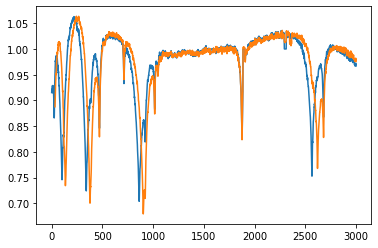

In [75]:
plt.plot(binary_sampler(lamgrid,15000,8.,1,15000,8.,1))
plt.plot(binary_sampler(lamgrid,15000,8.,2500,15000,8.,1))

In [64]:
candidates = wdtable[wdtable['spectral_class'] == 'DAB']['source_id']

normspec = [];
for candidate in candidates:
    spec = get_spectrum(candidate)
    lam  = spec[0]
    flux = spec[1]
    func = interp1d(lam,flux,kind='linear',assume_sorted = False,fill_value='extrapolate')
    interpflux = func(lamgrid)
    p,cov = curve_fit(quadratic,lamgrid[mask],interpflux[mask],p0=[-25,1e-2,1e-5,1e-10])
    contcorr = (interpflux/quadratic(lamgrid,p[0],p[1],p[2],p[3]))
    skylinemask = (lamgrid > 5578.5 - 10)*(lamgrid < 5578.5 + 10) + (lamgrid > 5894.6 - 10)*(lamgrid < 5894.6 + 10)\
        + (lamgrid > 6301.7 - 10)*(lamgrid < 6301.7 + 10) + (lamgrid > 7246.0 - 10)*(lamgrid < 7246.0 + 10)
    contcorr[skylinemask] = 1
    where = np.isnan(contcorr)
    contcorr[where] = 1
    normspec.append(contcorr)
len(normspec)

31

In [72]:
len(synth)

3000

  0%|          | 0/31 [00:00<?, ?it/s]

Fitting with Powell...


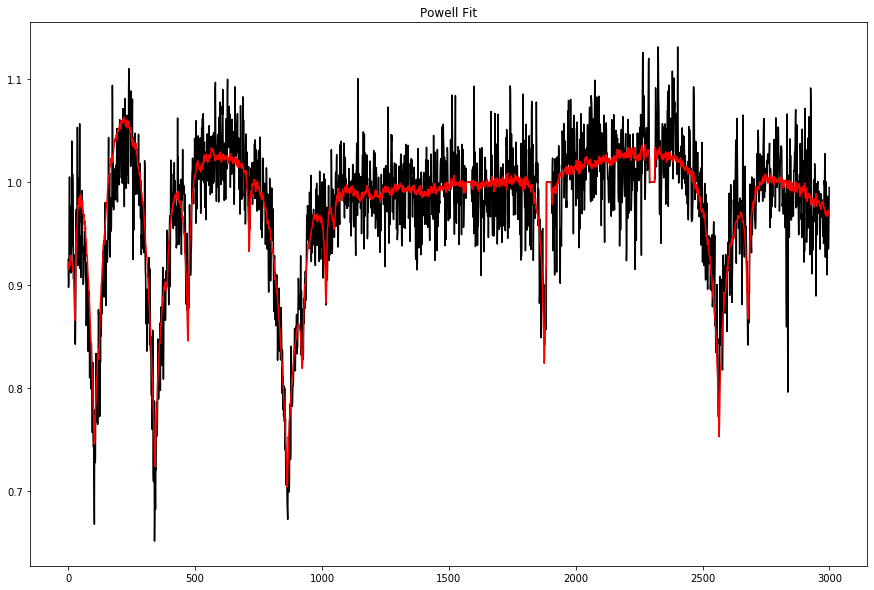

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 362
    # data points      = 2999
    # variables        = 6
    chi-square         = 3.09154369
    reduced chi-square = 0.00103292
    Akaike info crit   = -20613.2135
    Bayesian info crit = -20577.1773
[[Variables]]
    teff1:   13351.0951 +/- 654.258736 (4.90%) (init = 15000)
    logg1:   7.89724792 +/- 0.05220559 (0.66%) (init = 8)
    trans1:  17.7871559 +/- 21.7205141 (122.11%) (init = 0)
    teff2:   15000.0000 +/- 0.13753317 (0.00%) (init = 15000)
    logg2:   8.19546899 +/- 0.02097669 (0.26%) (init = 8)
    trans2:  47.7943719 +/- 19.0751259 (39.91%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, logg1)  =  0.767
    C(trans1, logg2) =  0.104

 Starting Bayesian Sampling................
...Done.


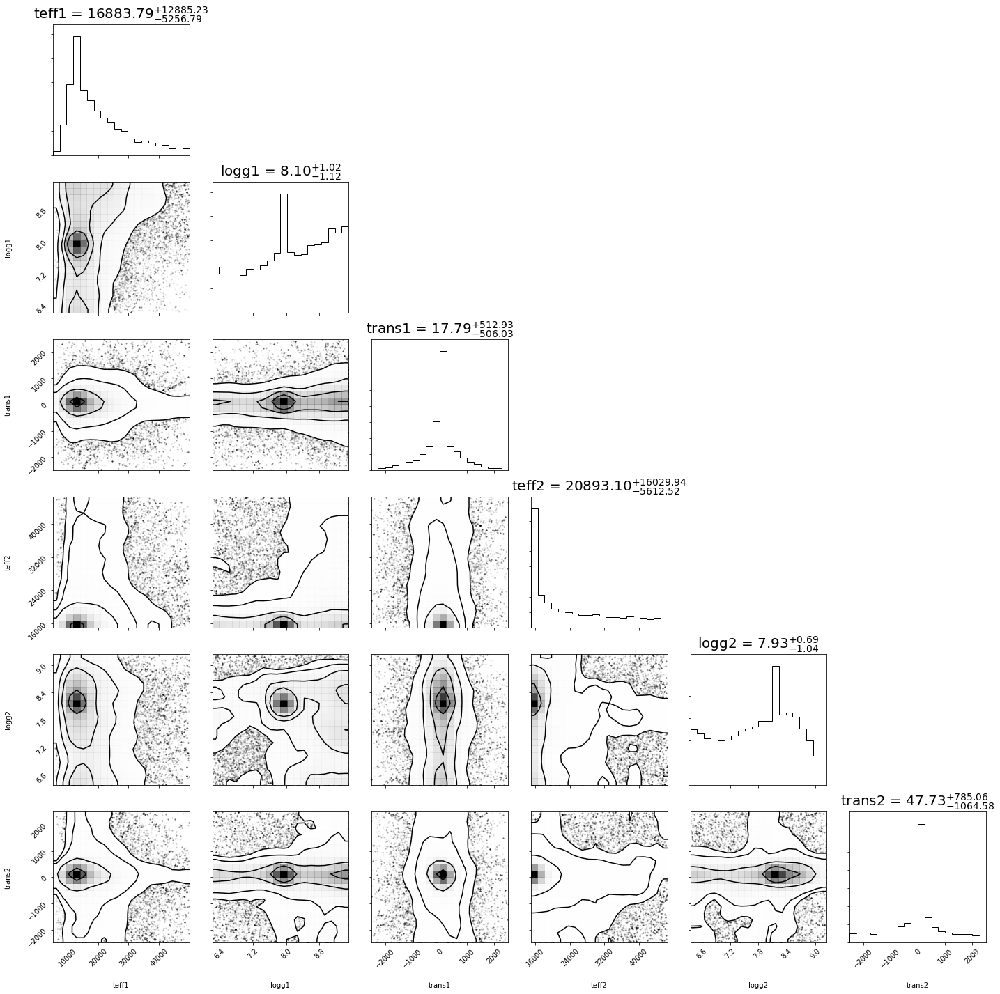

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2999
    # variables        = 6
    chi-square         = 4.04325899
    reduced chi-square = 0.00135091
    Akaike info crit   = -19808.3404
    Bayesian info crit = -19772.3042
[[Variables]]
    teff1:   16883.7939 +/- 9130.25686 (54.08%) (init = 13351.1)
    logg1:   8.10375473 +/- 1.07463703 (13.26%) (init = 7.897248)
    trans1:  17.7871522 +/- 513.359776 (2886.13%) (init = 17.78816)
    teff2:   20893.1002 +/- 10858.6915 (51.97%) (init = 15000)
    logg2:   7.92684538 +/- 0.86816186 (10.95%) (init = 8.195469)
    trans2:  47.7333792 +/- 935.370318 (1959.57%) (init = 47.79437)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, logg1) =  0.219
    C(teff1, teff2) =  0.187
    C(logg1, teff2) =  0.119


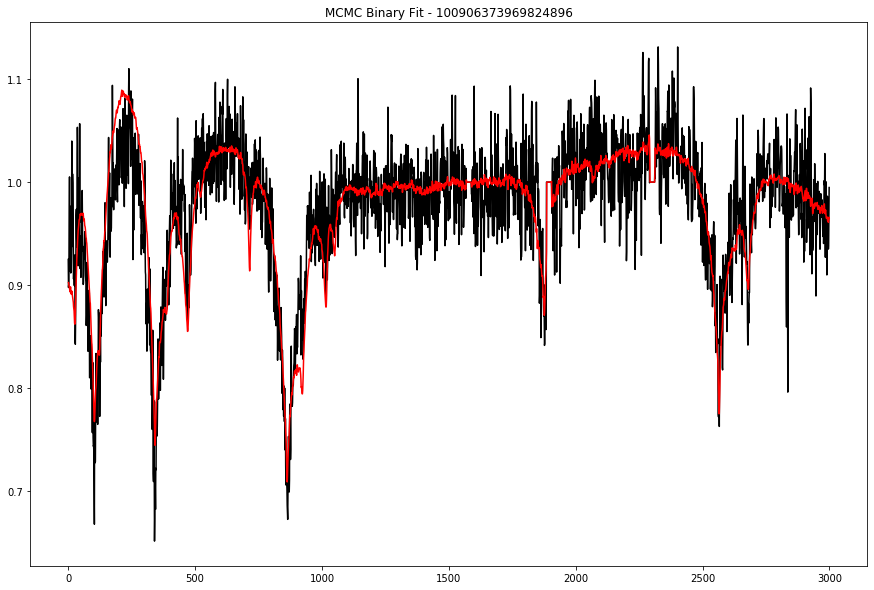

  3%|▎         | 1/31 [00:57<28:59, 57.98s/it]

Fitting with Powell...


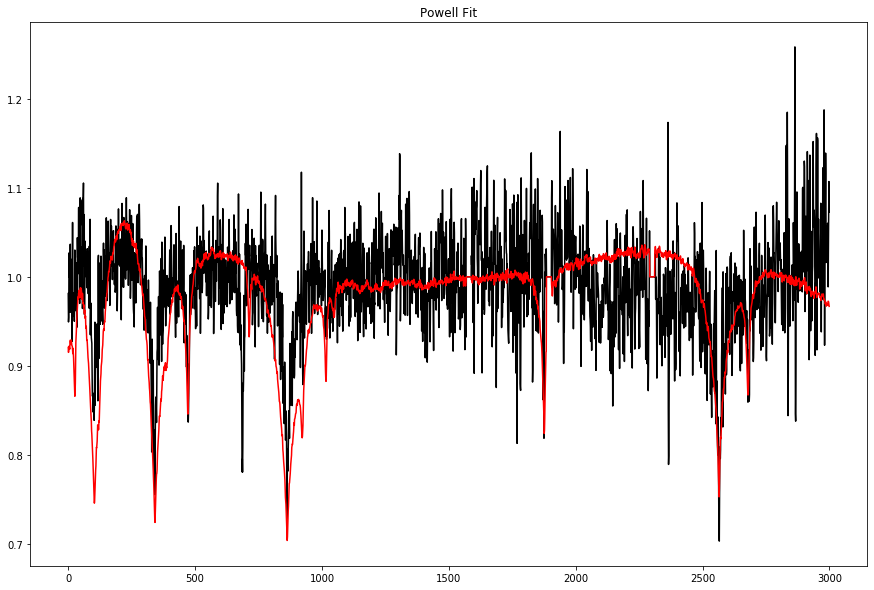

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 879
    # data points      = 2996
    # variables        = 6
    chi-square         = 6.45052457
    reduced chi-square = 0.00215737
    Akaike info crit   = -18386.0522
    Bayesian info crit = -18350.0220
[[Variables]]
    teff1:   43187.9042 +/- 1773.60014 (4.11%) (init = 15000)
    logg1:   8.28612916 +/- 0.08284396 (1.00%) (init = 8)
    trans1: -126.018868 +/- 23.5922729 (18.72%) (init = 0)
    teff2:   15000.0001 +/- 0.05542854 (0.00%) (init = 15000)
    logg2:   8.37129152 +/- 0.02707248 (0.32%) (init = 8)
    trans2:  17.4229968 +/- 54.0398589 (310.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, logg1)  =  0.733
    C(logg2, trans2) = -0.687
    C(teff1, trans1) = -0.186
    C(logg1, trans1) = -0.141

 Starting Bayesian Sampling................
...Done.


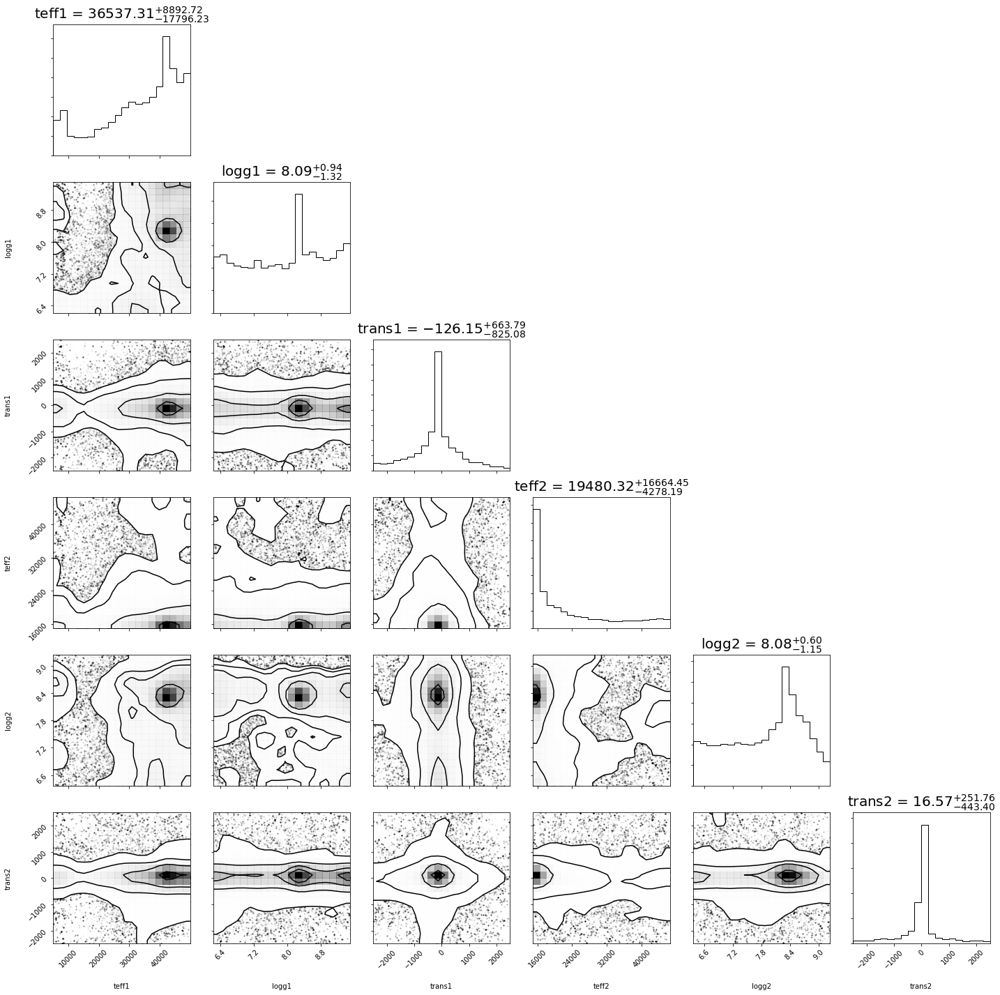

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2996
    # variables        = 6
    chi-square         = 8.17025977
    reduced chi-square = 0.00273253
    Akaike info crit   = -17677.9798
    Bayesian info crit = -17641.9496
[[Variables]]
    teff1:   36537.3116 +/- 13435.0997 (36.77%) (init = 43187.9)
    logg1:   8.08855333 +/- 1.13133073 (13.99%) (init = 8.286129)
    trans1: -126.153052 +/- 751.937575 (596.05%) (init = -126.0179)
    teff2:   19480.3249 +/- 10518.7589 (54.00%) (init = 15000)
    logg2:   8.07579900 +/- 0.87565526 (10.84%) (init = 8.371292)
    trans2:  16.5654245 +/- 355.703926 (2147.27%) (init = 17.423)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, logg1) =  0.182
    C(teff1, teff2) = -0.152
    C(teff2, logg2) = -0.128
    C(logg1, teff2) = -0.125


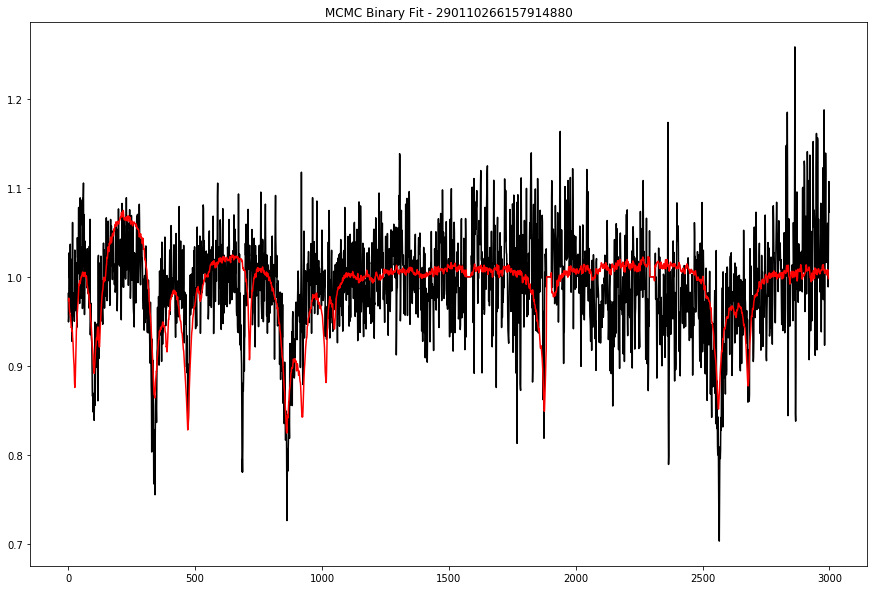

  6%|▋         | 2/31 [01:55<28:00, 57.94s/it]

Fitting with Powell...


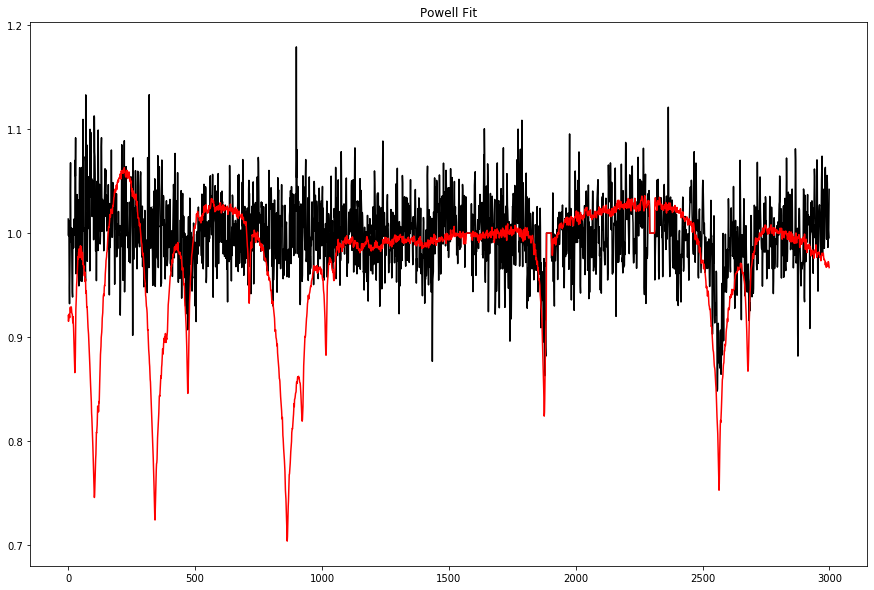

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 703
    # data points      = 2993
    # variables        = 6
    chi-square         = 3.26289661
    reduced chi-square = 0.00109237
    Akaike info crit   = -20404.4986
    Bayesian info crit = -20368.4744
##  Warning: uncertainties could not be estimated:
    teff2:   at initial value
    teff2:   at boundary
[[Variables]]
    teff1:   44744.4251 +/- 774.525653 (1.73%) (init = 15000)
    logg1:   6.32587235 +/- 0.05642096 (0.89%) (init = 8)
    trans1: -171.334452 +/-        nan (nan%) (init = 0)
    teff2:   15000.0000 +/- 0.00375252 (0.00%) (init = 15000)
    logg2:   8.35970452 +/- 0.01426159 (0.17%) (init = 8)
    trans2:  122.080472 +/- 31.8091902 (26.06%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, logg1)  =  0.499
    C(logg1, trans2) = -0.142

 Starting Bayesian Sampling................
...Done.


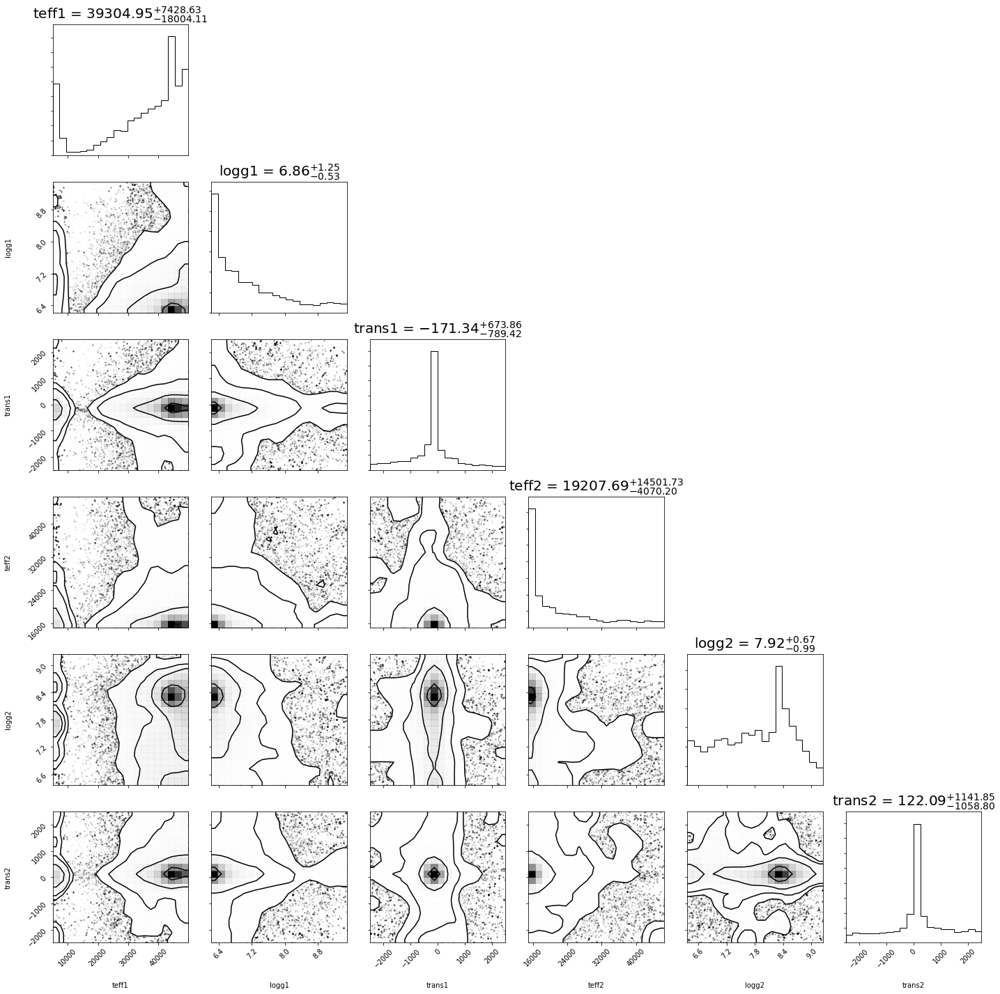

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2993
    # variables        = 6
    chi-square         = 5.30557149
    reduced chi-square = 0.00177622
    Akaike info crit   = -18949.4751
    Bayesian info crit = -18913.4509
[[Variables]]
    teff1:   39304.9495 +/- 12810.4304 (32.59%) (init = 44744.43)
    logg1:   6.85578117 +/- 0.89747024 (13.09%) (init = 6.325872)
    trans1: -171.337780 +/- 739.233126 (431.45%) (init = -171.3335)
    teff2:   19207.6901 +/- 9350.98134 (48.68%) (init = 15000)
    logg2:   7.91922381 +/- 0.83005033 (10.48%) (init = 8.359705)
    trans2:  122.091704 +/- 1108.53160 (907.95%) (init = 122.0805)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff2, logg2) = -0.234
    C(logg1, teff2) =  0.221
    C(logg1, logg2) = -0.175
    C(teff1, teff2) = -0.109
    C(teff1, logg1) = -0.108


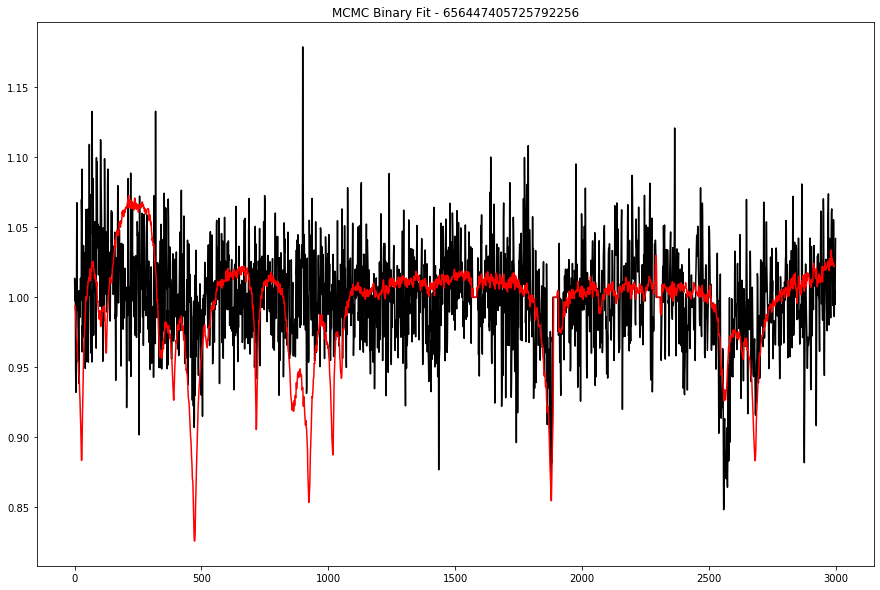

 10%|▉         | 3/31 [02:51<26:42, 57.22s/it]

Fitting with Powell...


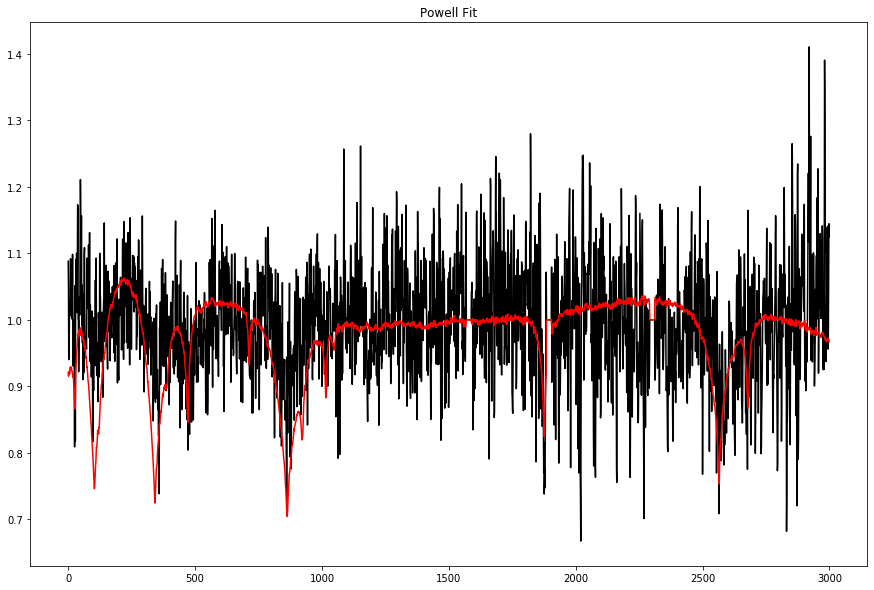

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 381
    # data points      = 2991
    # variables        = 6
    chi-square         = 17.7687352
    reduced chi-square = 0.00595268
    Akaike info crit   = -15319.6345
    Bayesian info crit = -15283.6143
[[Variables]]
    teff1:   49847.9065 +/- 687.546664 (1.38%) (init = 15000)
    logg1:   7.80196417 +/- 0.10579171 (1.36%) (init = 8)
    trans1:  410.542469 +/- 157.899989 (38.46%) (init = 0)
    teff2:   15000.0002 +/- 0.36263931 (0.00%) (init = 15000)
    logg2:   8.33164109 +/- 0.05139824 (0.62%) (init = 8)
    trans2: -113.151040 +/- 57.8275580 (51.11%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(logg2, trans2)  =  0.373
    C(teff1, logg1)   =  0.251
    C(trans1, trans2) =  0.196
    C(trans1, logg2)  =  0.147
    C(logg1, logg2)   = -0.103

 Starting Bayesian Sampling................
...Done.


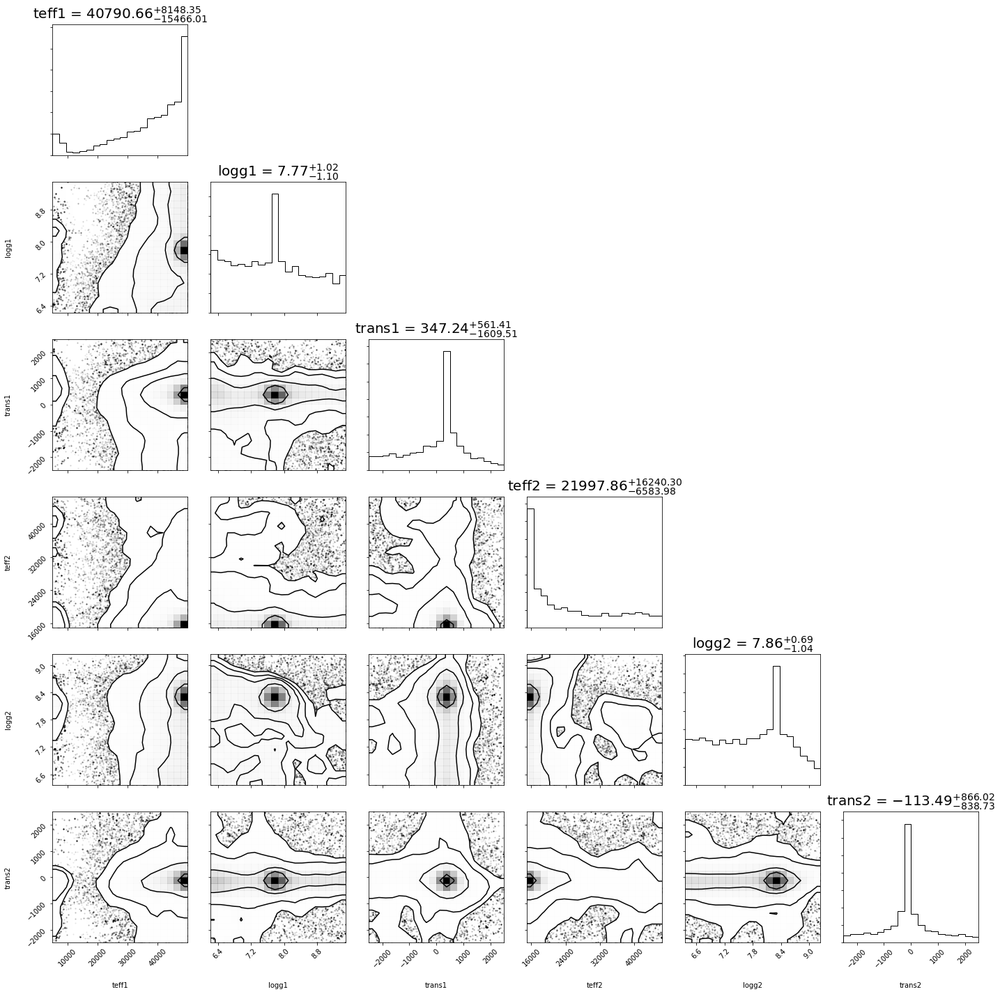

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2992
    # variables        = 6
    chi-square         = 19.3744060
    reduced chi-square = 0.00648841
    Akaike info crit   = -15066.9153
    Bayesian info crit = -15030.8931
[[Variables]]
    teff1:   40790.6556 +/- 11867.3469 (29.09%) (init = 49847.91)
    logg1:   7.76548135 +/- 1.06367139 (13.70%) (init = 7.801964)
    trans1:  347.236221 +/- 1098.50249 (316.36%) (init = 410.5435)
    teff2:   21997.8595 +/- 11457.5573 (52.08%) (init = 15000)
    logg2:   7.86127511 +/- 0.86448969 (11.00%) (init = 8.331641)
    trans2: -113.491145 +/- 864.824450 (762.02%) (init = -113.151)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, teff2)  = -0.320
    C(teff1, logg1)  =  0.178
    C(teff2, logg2)  = -0.170
    C(trans1, teff2) = -0.129


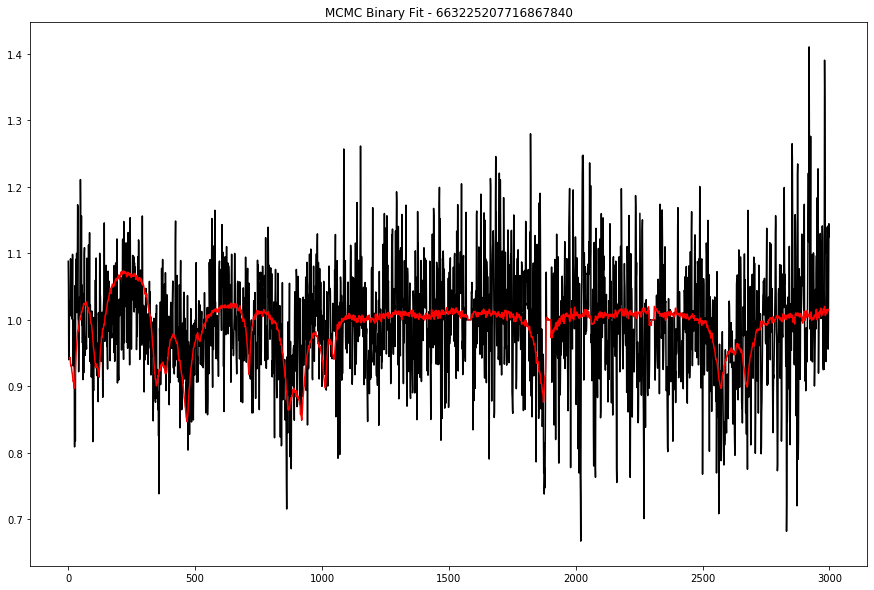

 13%|█▎        | 4/31 [03:47<25:36, 56.92s/it]

Fitting with Powell...


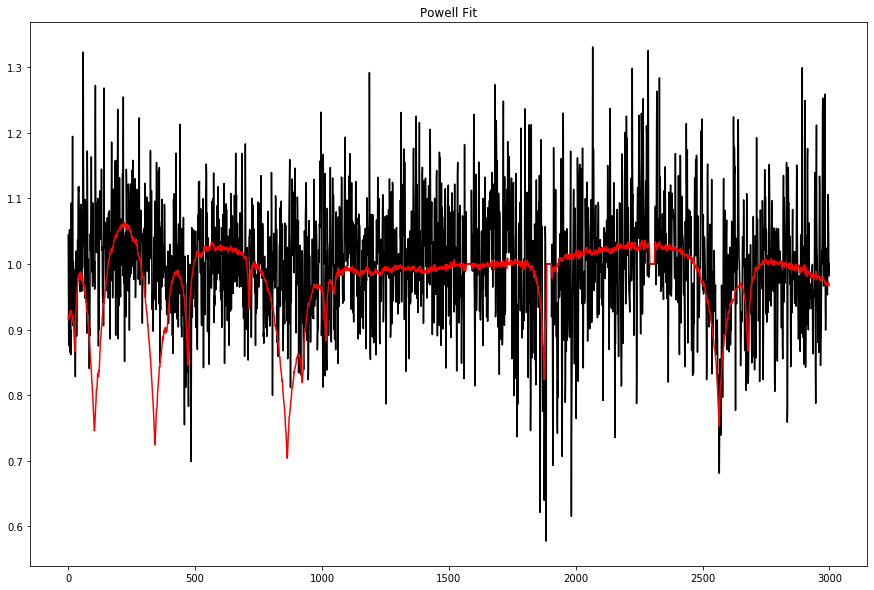

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 477
    # data points      = 2942
    # variables        = 6
    chi-square         = 21.1872064
    reduced chi-square = 0.00721635
    Akaike info crit   = -14502.2022
    Bayesian info crit = -14466.2811
##  Warning: uncertainties could not be estimated:
[[Variables]]
    teff1:   49960.9256 +/-        nan (nan%) (init = 15000)
    logg1:   6.59087553 +/- 0.14390071 (2.18%) (init = 8)
    trans1: -2416.35247 +/- 27.2669395 (1.13%) (init = 0)
    teff2:   15757.5869 +/-        nan (nan%) (init = 15000)
    logg2:   8.16348270 +/-        nan (nan%) (init = 8)
    trans2:  15.1164207 +/- 20.0415340 (132.58%) (init = 0)

 Starting Bayesian Sampling................
...Done.


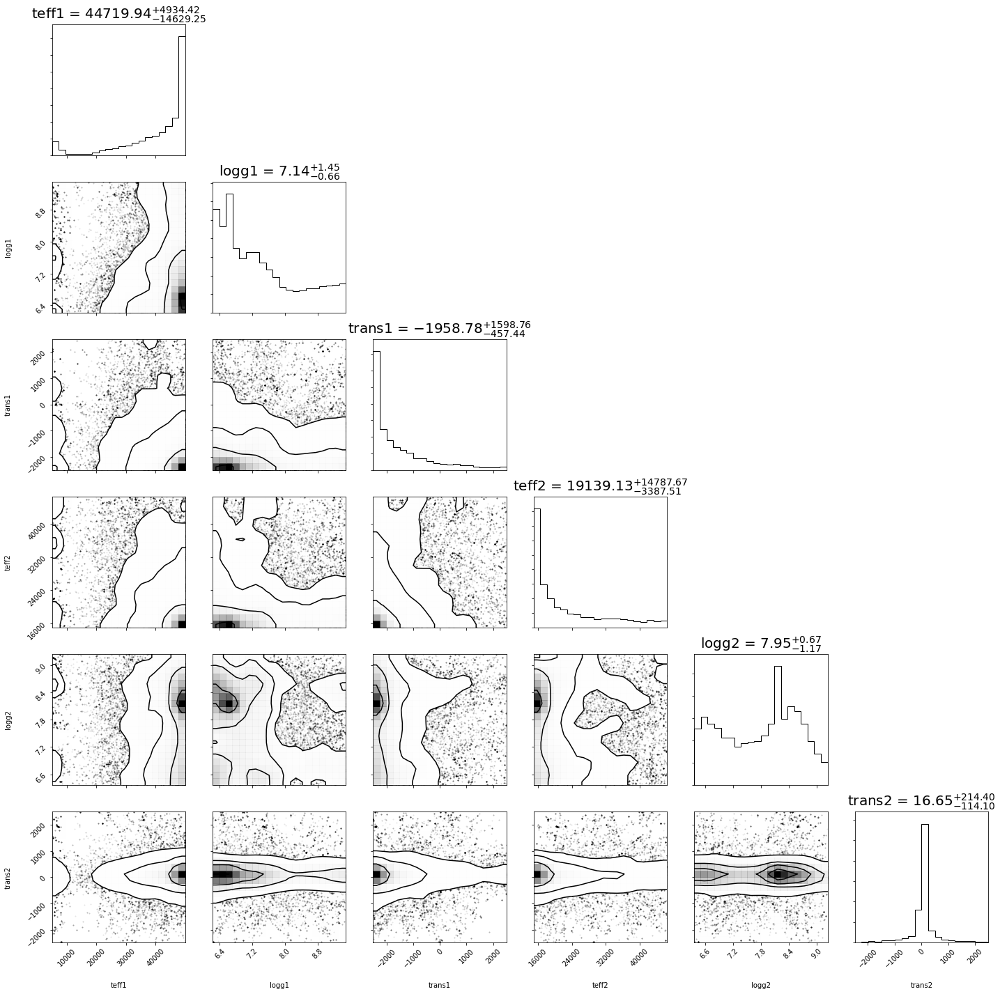

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2953
    # variables        = 6
    chi-square         = 22.0414532
    reduced chi-square = 0.00747929
    Akaike info crit   = -14450.7662
    Bayesian info crit = -14414.8228
[[Variables]]
    teff1:   44719.9413 +/- 9869.67844 (22.07%) (init = 49960.93)
    logg1:   7.13618218 +/- 1.06100090 (14.87%) (init = 6.590876)
    trans1: -1958.77503 +/- 1034.41525 (52.81%) (init = -2416.351)
    teff2:   19139.1305 +/- 9104.04889 (47.57%) (init = 15757.59)
    logg2:   7.94620168 +/- 0.92726652 (11.67%) (init = 8.163483)
    trans2:  16.6450174 +/- 168.124594 (1010.06%) (init = 15.11642)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, teff2)   = -0.464
    C(trans1, teff2)  =  0.368
    C(teff1, trans1)  = -0.349
    C(logg1, trans1)  =  0.148
    C(logg1, teff2)   =  0.142
    C(teff1, logg1)   = -0.118
    C(trans1, trans2) =  0.104
    C(logg1, logg2)   = -0.104


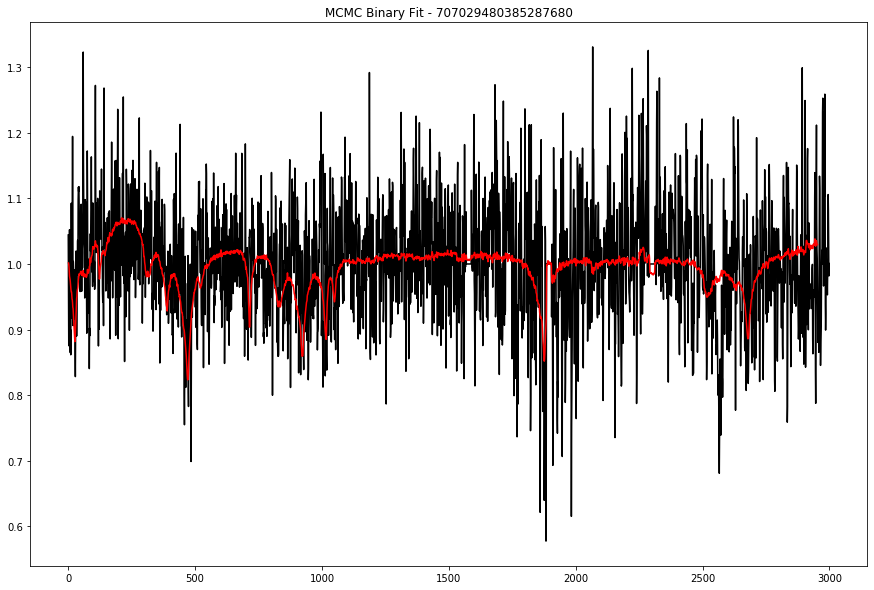

 16%|█▌        | 5/31 [04:44<24:42, 57.02s/it]

Fitting with Powell...


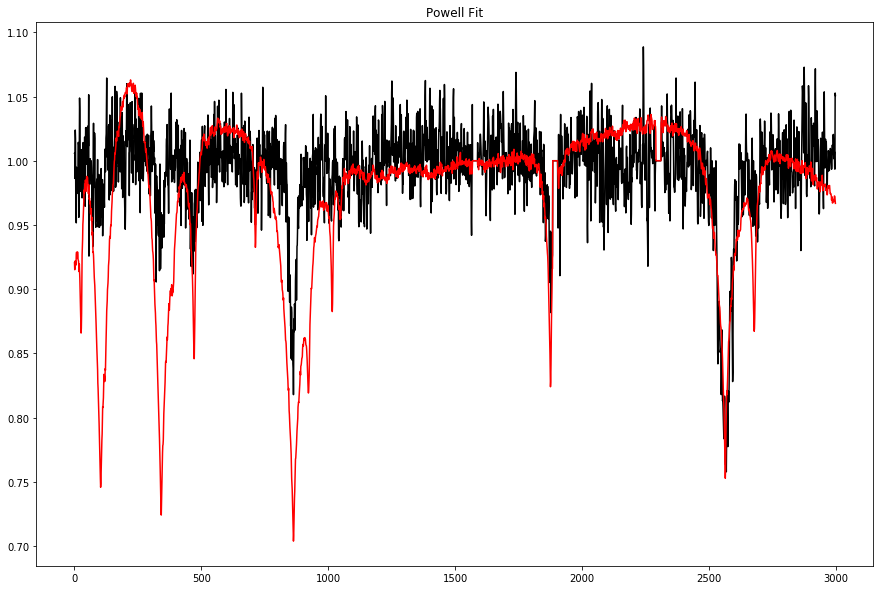

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 555
    # data points      = 2994
    # variables        = 6
    chi-square         = 2.26077359
    reduced chi-square = 7.5662e-04
    Akaike info crit   = -21510.8436
    Bayesian info crit = -21474.8174
[[Variables]]
    teff1:   37770.3061 +/- 537.649106 (1.42%) (init = 15000)
    logg1:   7.76938624 +/- 0.02941446 (0.38%) (init = 8)
    trans1: -130.203902 +/- 34.0729692 (26.17%) (init = 0)
    teff2:   15000.0000 +/- 0.00443977 (0.00%) (init = 15000)
    logg2:   8.35944231 +/- 0.01213289 (0.15%) (init = 8)
    trans2:  64.5153245 +/- 15.3927253 (23.86%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, logg1)  =  0.465
    C(logg2, trans2) =  0.128

 Starting Bayesian Sampling................
...Done.


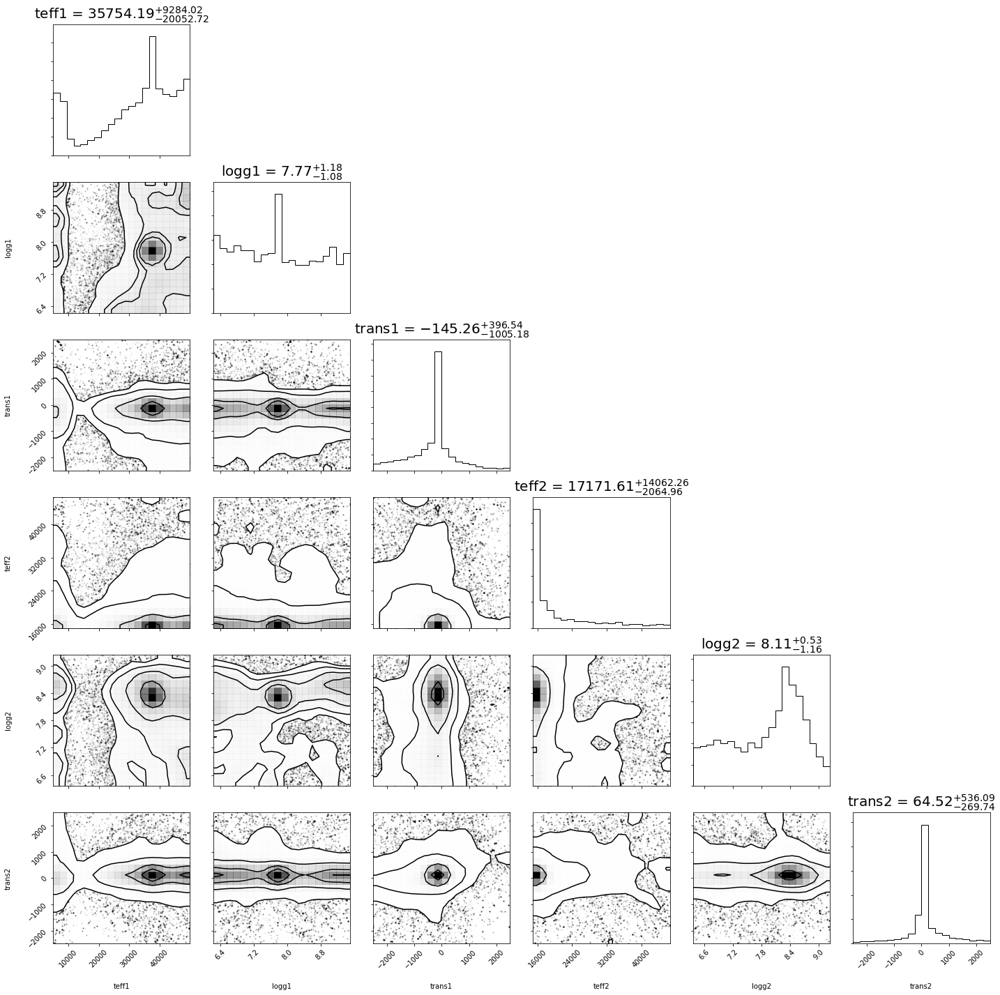

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2995
    # variables        = 6
    chi-square         = 3.03645395
    reduced chi-square = 0.00101588
    Akaike info crit   = -20635.5574
    Bayesian info crit = -20599.5292
[[Variables]]
    teff1:   35754.1864 +/- 14795.2123 (41.38%) (init = 37770.31)
    logg1:   7.76752242 +/- 1.13659380 (14.63%) (init = 7.769386)
    trans1: -145.257001 +/- 707.160353 (486.83%) (init = -130.2029)
    teff2:   17171.6091 +/- 8099.02681 (47.17%) (init = 15000)
    logg2:   8.11174520 +/- 0.85165267 (10.50%) (init = 8.359442)
    trans2:  64.5239996 +/- 408.692999 (633.40%) (init = 64.51532)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff2, logg2)   = -0.200
    C(trans1, trans2) =  0.195
    C(trans1, logg2)  =  0.121


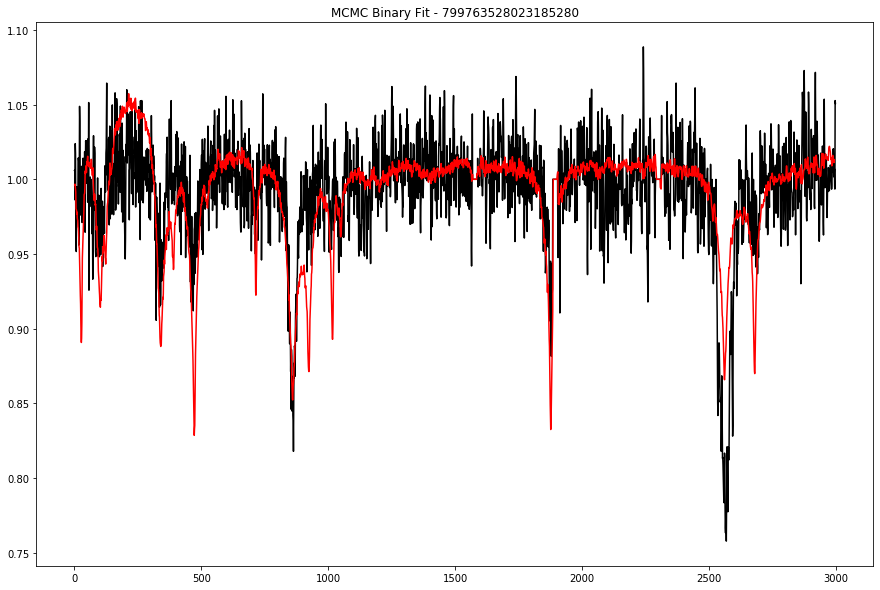

 19%|█▉        | 6/31 [05:42<23:47, 57.08s/it]

Fitting with Powell...


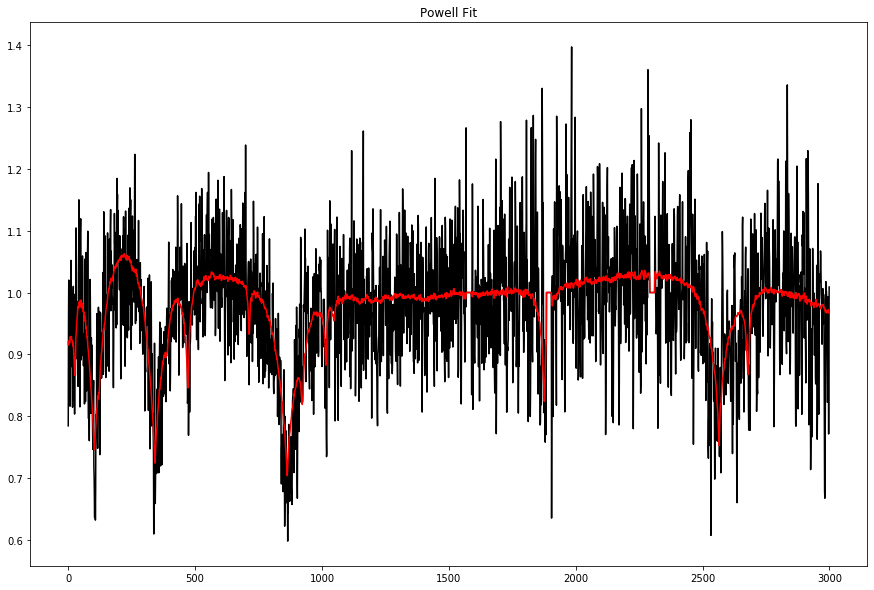

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 596
    # data points      = 2994
    # variables        = 6
    chi-square         = 21.6226896
    reduced chi-square = 0.00723651
    Akaike info crit   = -14750.2833
    Bayesian info crit = -14714.2571
[[Variables]]
    teff1:   12961.7924 +/- 817.694242 (6.31%) (init = 15000)
    logg1:   8.09402609 +/- 0.11874363 (1.47%) (init = 8)
    trans1: -85.6672262 +/- 54.0611895 (63.11%) (init = 0)
    teff2:   15000.0072 +/- 2.85486677 (0.02%) (init = 15000)
    logg2:   8.21969876 +/- 0.04944244 (0.60%) (init = 8)
    trans2:  176.958520 +/- 30.3737909 (17.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(logg2, trans2) =  0.302
    C(teff1, logg1)  =  0.299

 Starting Bayesian Sampling................
...Done.


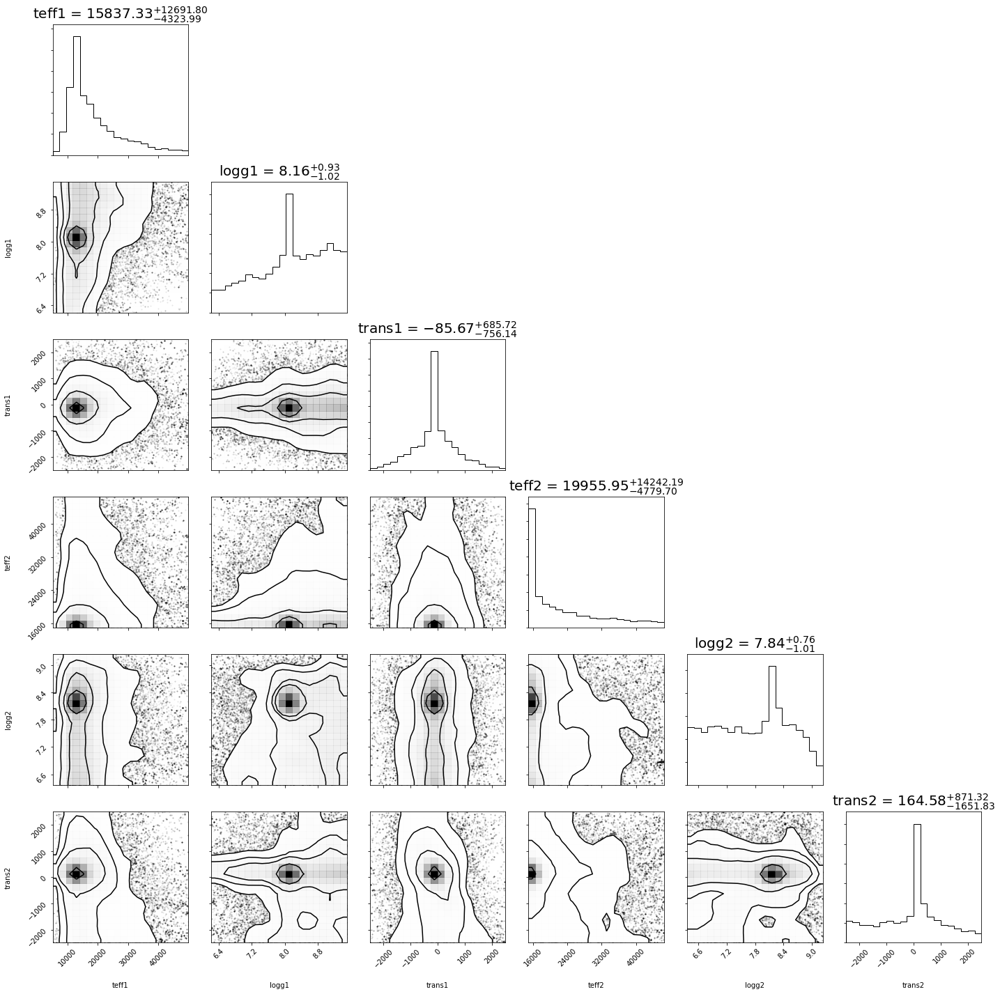

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2994
    # variables        = 6
    chi-square         = 22.7557484
    reduced chi-square = 0.00761571
    Akaike info crit   = -14597.3660
    Bayesian info crit = -14561.3398
[[Variables]]
    teff1:   15837.3326 +/- 8605.92169 (54.34%) (init = 12961.79)
    logg1:   8.15827129 +/- 0.97937284 (12.00%) (init = 8.094026)
    trans1: -85.6729874 +/- 725.738705 (847.10%) (init = -85.66623)
    teff2:   19955.9475 +/- 9540.73364 (47.81%) (init = 15000.01)
    logg2:   7.83917179 +/- 0.89210738 (11.38%) (init = 8.219699)
    trans2:  164.581336 +/- 1271.73663 (772.71%) (init = 176.9585)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, teff2)   =  0.226
    C(teff1, logg1)   =  0.196
    C(teff1, trans2)  = -0.191
    C(trans1, trans2) = -0.160
    C(teff2, logg2)   = -0.109


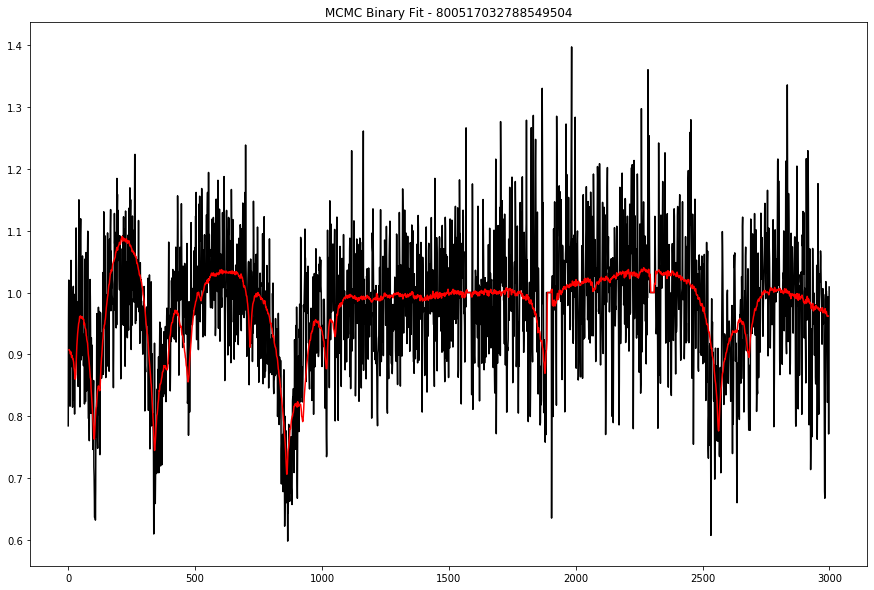

 23%|██▎       | 7/31 [06:42<23:12, 58.01s/it]

Fitting with Powell...


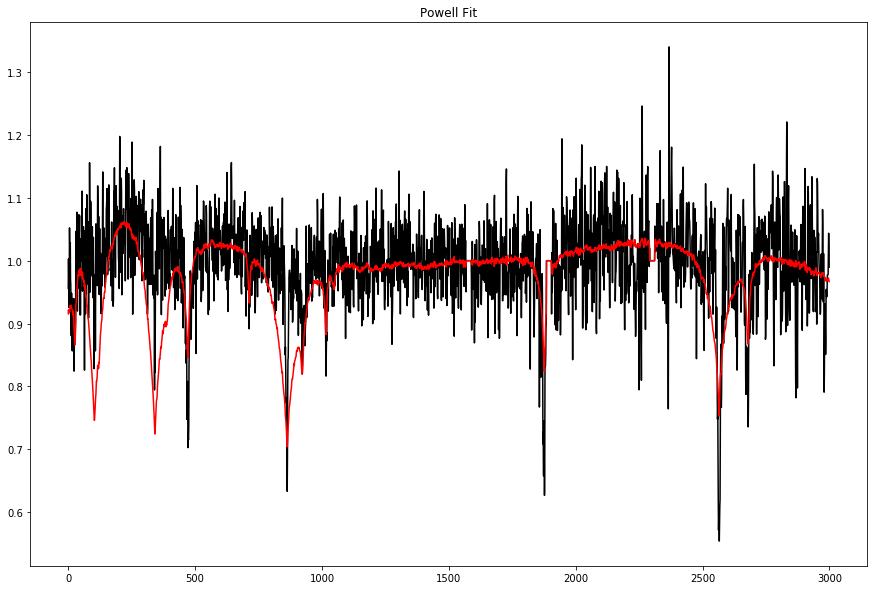

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 310
    # data points      = 2999
    # variables        = 6
    chi-square         = 9.65280096
    reduced chi-square = 0.00322513
    Akaike info crit   = -17198.6194
    Bayesian info crit = -17162.5832
[[Variables]]
    teff1:   7050.63689 +/- 101.953787 (1.45%) (init = 15000)
    logg1:   8.34002486 +/- 0.08107403 (0.97%) (init = 8)
    trans1:  0.00600329 +/- 18.0041767 (299905.34%) (init = 0)
    teff2:   15817.1767 +/- 270.294490 (1.71%) (init = 15000)
    logg2:   8.02038033 +/- 0.03305352 (0.41%) (init = 8)
    trans2: -4.43247188 +/- 18.5531054 (418.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff2, logg2)  =  0.697
    C(teff1, logg1)  =  0.173
    C(logg2, trans2) =  0.103

 Starting Bayesian Sampling................
...Done.


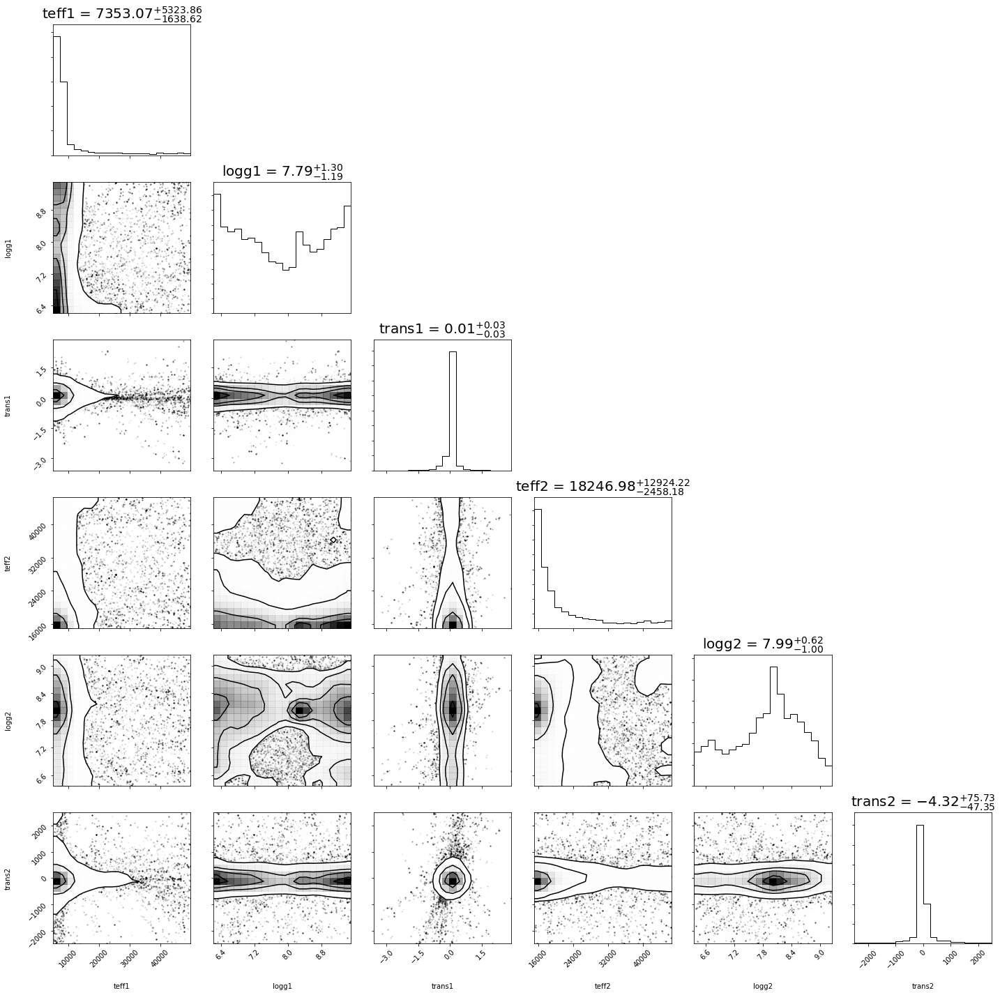

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2998
    # variables        = 6
    chi-square         = 10.1182960
    reduced chi-square = 0.00338178
    Akaike info crit   = -17050.6835
    Bayesian info crit = -17014.6493
[[Variables]]
    teff1:   7353.06602 +/- 3581.38932 (48.71%) (init = 7050.637)
    logg1:   7.79422582 +/- 1.24562478 (15.98%) (init = 8.340025)
    trans1:  0.00706612 +/- 0.03053087 (432.07%) (init = 0.007003286)
    teff2:   18246.9764 +/- 7755.48150 (42.50%) (init = 15817.18)
    logg2:   7.99217266 +/- 0.81525942 (10.20%) (init = 8.02038)
    trans2: -4.32118617 +/- 63.9323095 (1479.51%) (init = -4.432472)
[[Correlations]] (unreported correlations are < 0.100)
    C(trans1, trans2) =  0.370
    C(teff1, teff2)   =  0.315
    C(trans1, logg2)  =  0.103


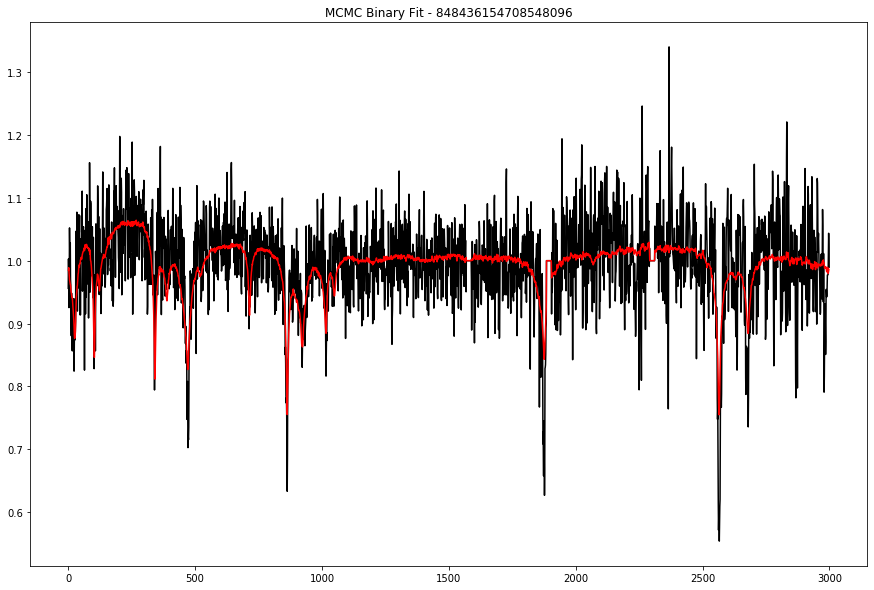

 26%|██▌       | 8/31 [07:38<22:01, 57.44s/it]

Fitting with Powell...


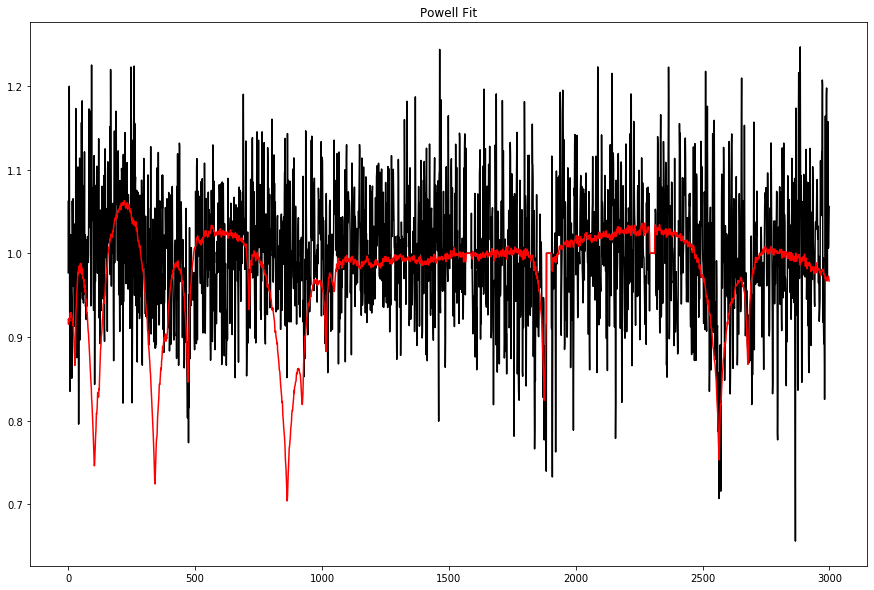

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 427
    # data points      = 2954
    # variables        = 6
    chi-square         = 14.8948646
    reduced chi-square = 0.00505253
    Akaike info crit   = -15614.3615
    Bayesian info crit = -15578.4161
##  Warning: uncertainties could not be estimated:
    teff2:   at initial value
    teff2:   at boundary
[[Variables]]
    teff1:   49961.2136 +/-        nan (nan%) (init = 15000)
    logg1:   6.66674032 +/- 0.12008152 (1.80%) (init = 8)
    trans1: -1863.50932 +/- 136.747751 (7.34%) (init = 0)
    teff2:   15000.0000 +/- 1.0853e-07 (0.00%) (init = 15000)
    logg2:   8.11008748 +/- 0.02639614 (0.33%) (init = 8)
    trans2:  122.307013 +/- 43.3477921 (35.44%) (init = 0)

 Starting Bayesian Sampling................
...Done.


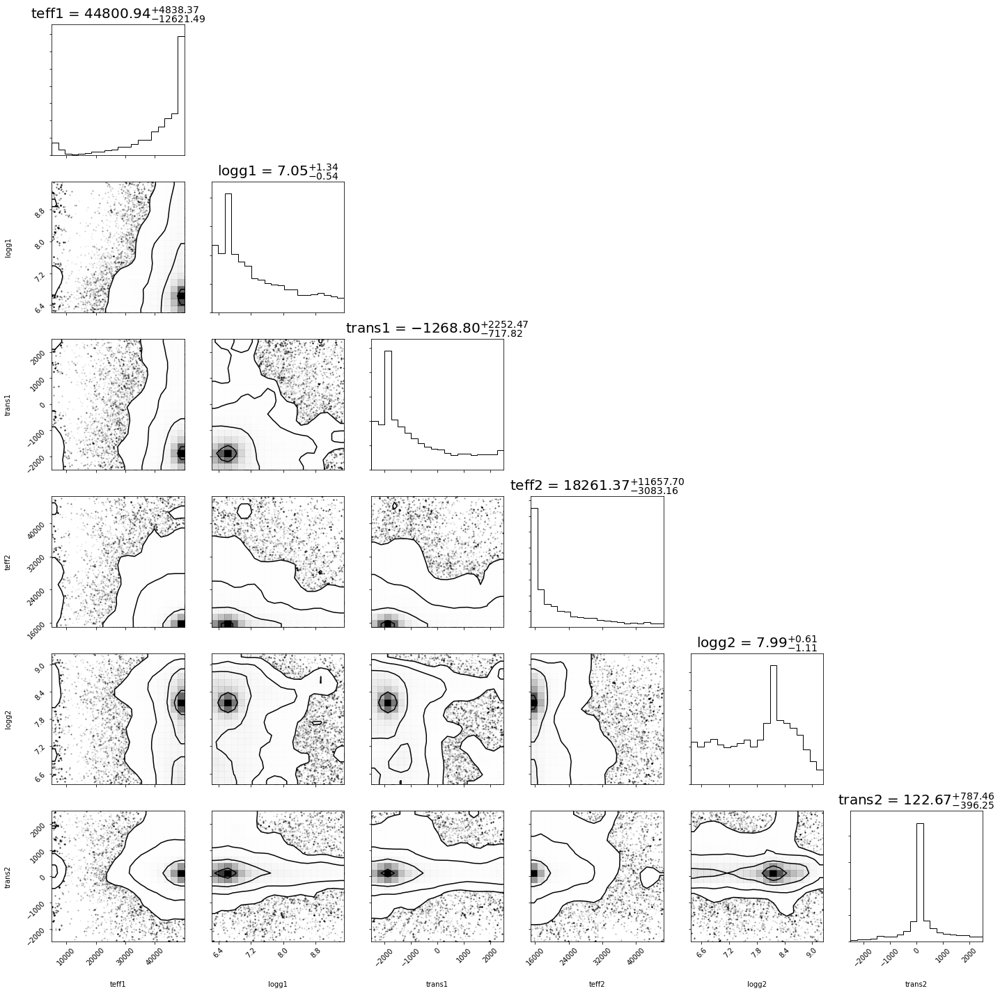

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2968
    # variables        = 6
    chi-square         = 15.8522382
    reduced chi-square = 0.00535187
    Akaike info crit   = -15517.5641
    Bayesian info crit = -15481.5902
[[Variables]]
    teff1:   44800.9358 +/- 8807.96915 (19.66%) (init = 49961.21)
    logg1:   7.05231678 +/- 0.94436612 (13.39%) (init = 6.66674)
    trans1: -1268.79835 +/- 1491.90515 (117.58%) (init = -1863.508)
    teff2:   18261.3735 +/- 7403.53889 (40.54%) (init = 15000)
    logg2:   7.98706666 +/- 0.86133956 (10.78%) (init = 8.110087)
    trans2:  122.673029 +/- 598.601964 (487.97%) (init = 122.307)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, teff2)  = -0.402
    C(trans1, teff2) =  0.183
    C(teff2, logg2)  = -0.160
    C(logg1, trans1) =  0.158
    C(teff1, trans1) = -0.158
    C(logg1, teff2)  =  0.139
    C(teff1, logg1)  = -0.107


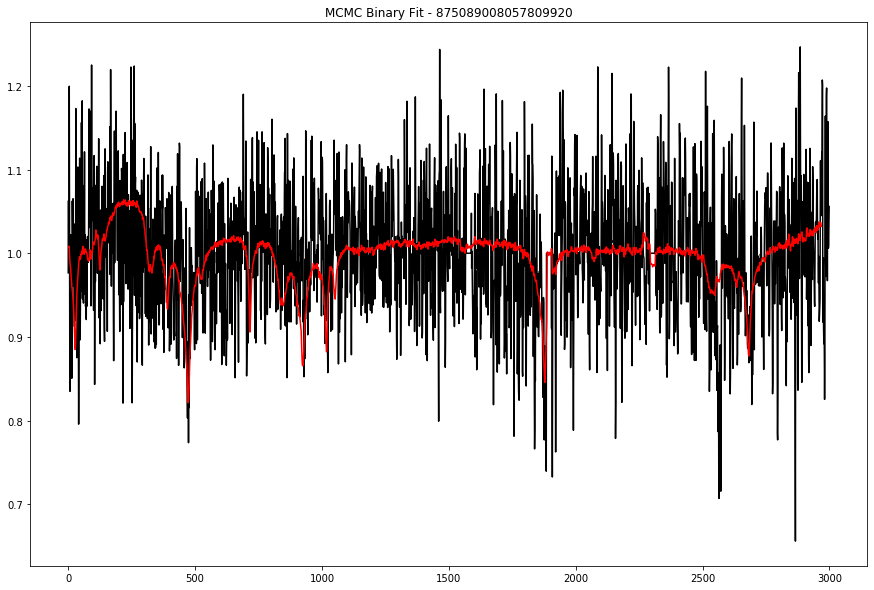

 29%|██▉       | 9/31 [08:32<20:43, 56.51s/it]

Fitting with Powell...


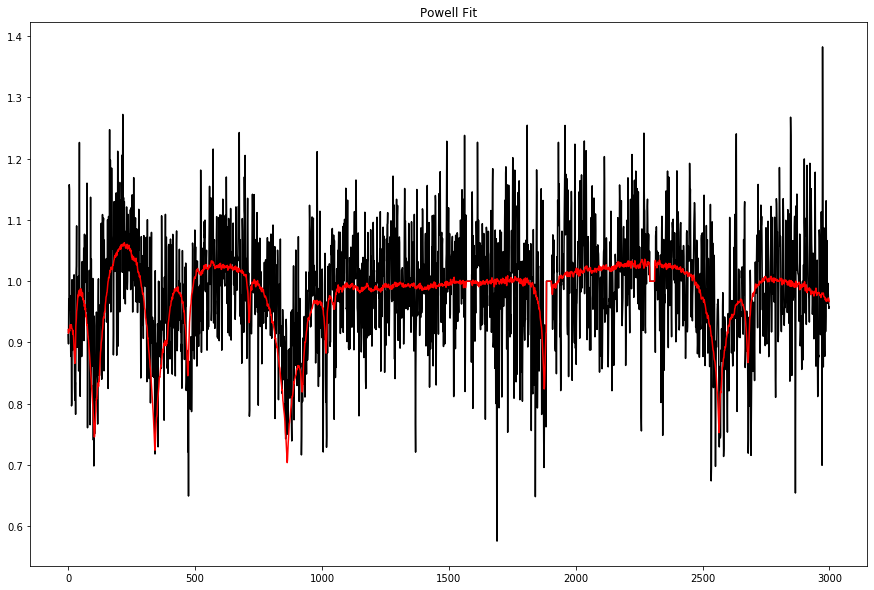

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 430
    # data points      = 2998
    # variables        = 6
    chi-square         = 19.2312564
    reduced chi-square = 0.00642756
    Akaike info crit   = -15125.3930
    Bayesian info crit = -15089.3588
[[Variables]]
    teff1:   28003.4338 +/- 4967.98703 (17.74%) (init = 15000)
    logg1:   7.96550116 +/- 0.46422774 (5.83%) (init = 8)
    trans1:  74.9481162 +/- 76.0438280 (101.46%) (init = 0)
    teff2:   16742.2462 +/- 819.845438 (4.90%) (init = 15000)
    logg2:   7.97471167 +/- 0.06763750 (0.85%) (init = 8)
    trans2:  58.5231102 +/- 26.9254971 (46.01%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, logg1)  =  0.985
    C(teff2, logg2)  =  0.568
    C(trans1, teff2) = -0.212

 Starting Bayesian Sampling................
...Done.


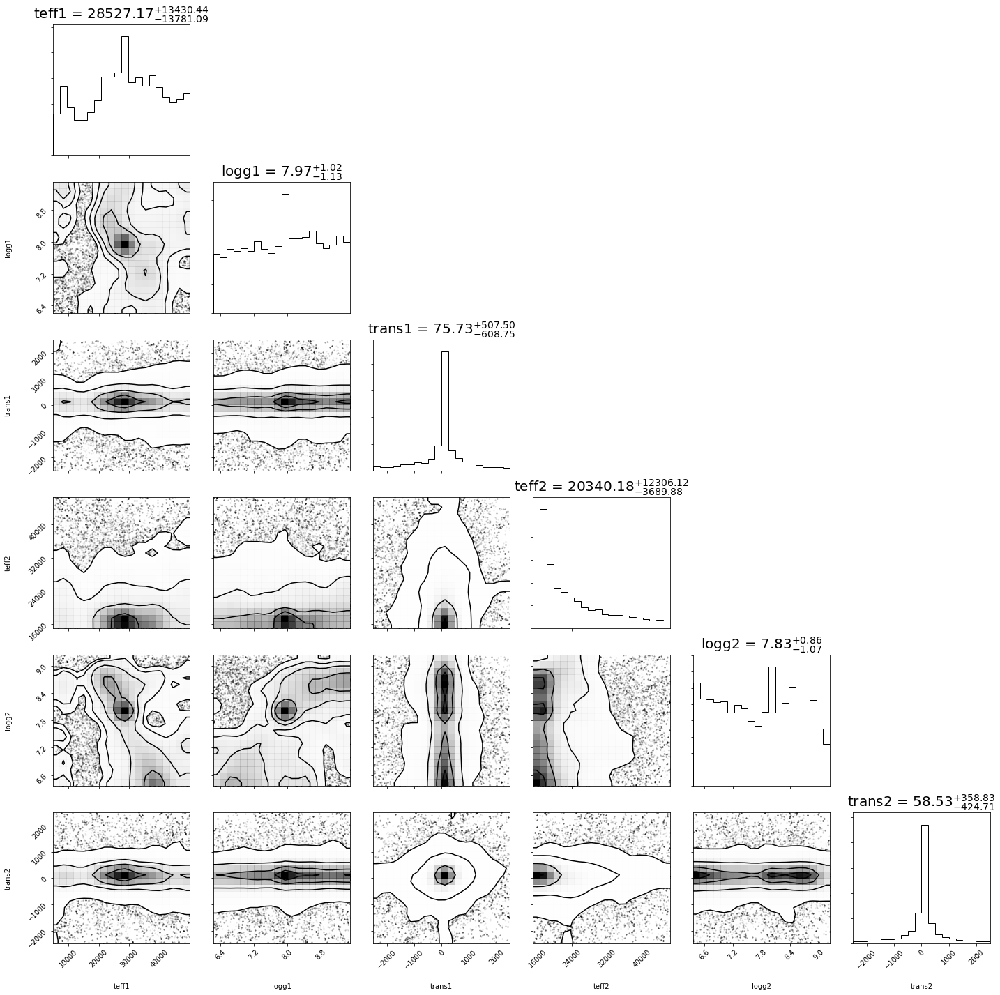

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2998
    # variables        = 6
    chi-square         = 19.5339121
    reduced chi-square = 0.00652871
    Akaike info crit   = -15078.5788
    Bayesian info crit = -15042.5446
[[Variables]]
    teff1:   28527.1717 +/- 13691.0546 (47.99%) (init = 28003.43)
    logg1:   7.96593191 +/- 1.08226190 (13.59%) (init = 7.965501)
    trans1:  75.7262841 +/- 566.036898 (747.48%) (init = 74.94912)
    teff2:   20340.1803 +/- 8075.92377 (39.70%) (init = 16742.25)
    logg2:   7.83128681 +/- 0.96444131 (12.32%) (init = 7.974712)
    trans2:  58.5326384 +/- 395.454218 (675.61%) (init = 58.52311)
[[Correlations]] (unreported correlations are < 0.100)
    C(logg1, logg2)   =  0.224
    C(teff1, logg2)   = -0.148
    C(trans1, trans2) =  0.111


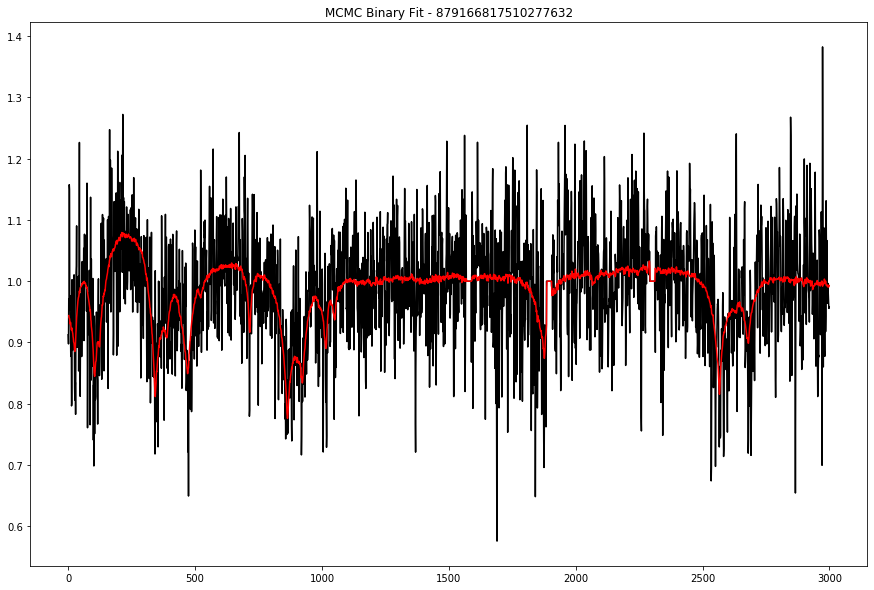

 32%|███▏      | 10/31 [09:30<19:57, 57.02s/it]

Fitting with Powell...


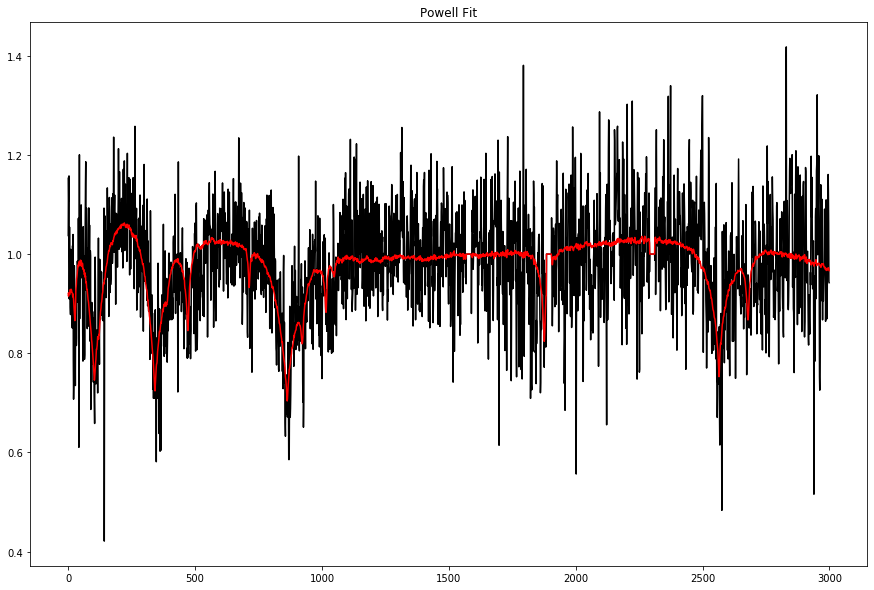

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 456
    # data points      = 2996
    # variables        = 6
    chi-square         = 25.5916553
    reduced chi-square = 0.00855908
    Akaike info crit   = -14257.2500
    Bayesian info crit = -14221.2198
##  Warning: uncertainties could not be estimated:
[[Variables]]
    teff1:   19491.1101 +/-        nan (nan%) (init = 15000)
    logg1:   7.98377554 +/-        nan (nan%) (init = 8)
    trans1:  224.844360 +/- 61.3565339 (27.29%) (init = 0)
    teff2:   17629.9030 +/- 1106.78406 (6.28%) (init = 15000)
    logg2:   7.57086757 +/- 0.13791361 (1.82%) (init = 8)
    trans2:  60.2965860 +/- 80.4663187 (133.45%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff2, logg2)  =  0.834
    C(teff2, trans2) =  0.343
    C(logg2, trans2) =  0.297

 Starting Bayesian Sampling................
...Done.


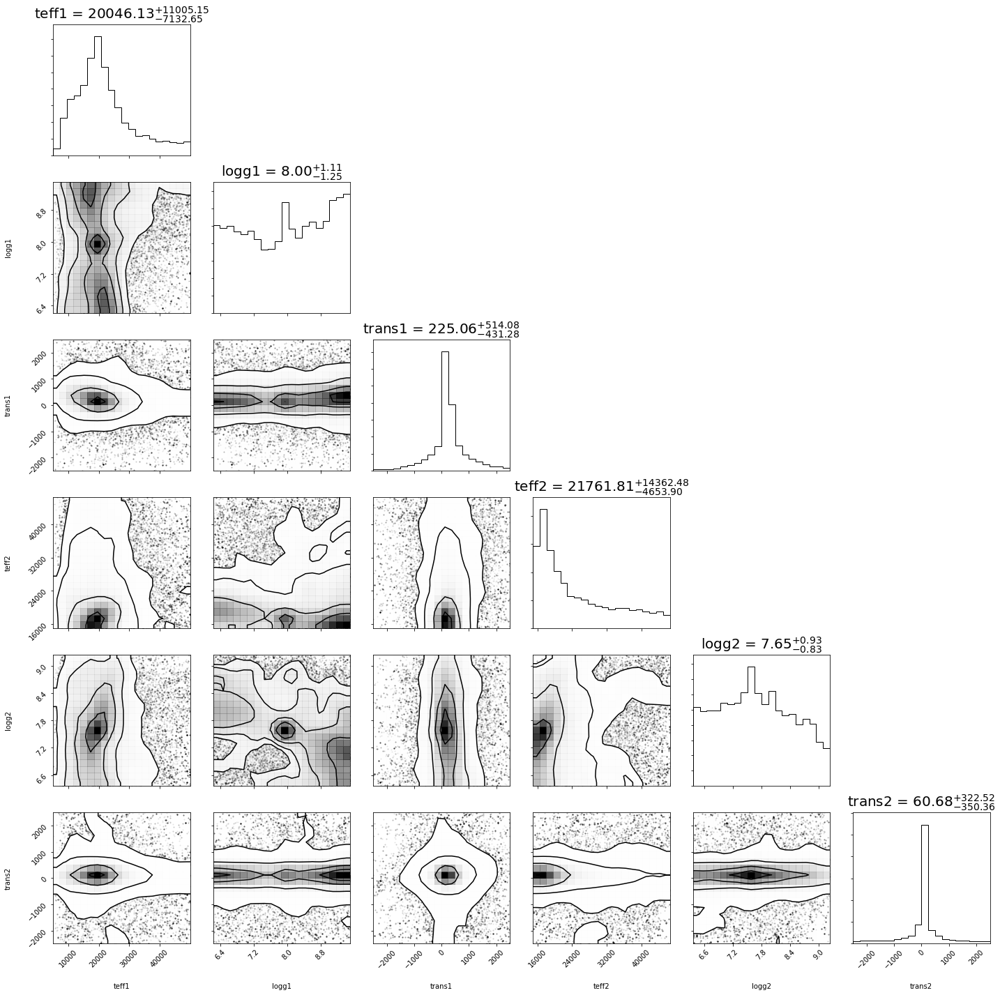

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2996
    # variables        = 6
    chi-square         = 25.6667554
    reduced chi-square = 0.00858420
    Akaike info crit   = -14248.4709
    Bayesian info crit = -14212.4407
[[Variables]]
    teff1:   20046.1251 +/- 9153.80509 (45.66%) (init = 19491.11)
    logg1:   7.99992912 +/- 1.18444487 (14.81%) (init = 7.983776)
    trans1:  225.063641 +/- 477.327330 (212.09%) (init = 224.8454)
    teff2:   21761.8081 +/- 9549.11451 (43.88%) (init = 17629.9)
    logg2:   7.65251348 +/- 0.88536897 (11.57%) (init = 7.570868)
    trans2:  60.6762797 +/- 341.152741 (562.25%) (init = 60.29659)
[[Correlations]] (unreported correlations are < 0.100)
    C(logg1, logg2) = -0.220
    C(teff2, logg2) =  0.130
    C(teff1, teff2) =  0.121
    C(teff1, logg1) =  0.120


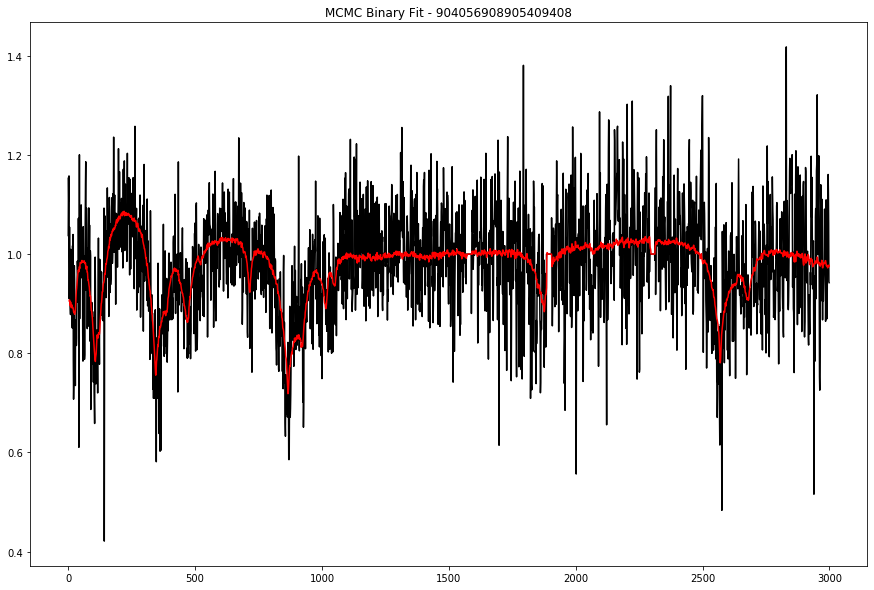

 35%|███▌      | 11/31 [10:28<19:06, 57.32s/it]

Fitting with Powell...


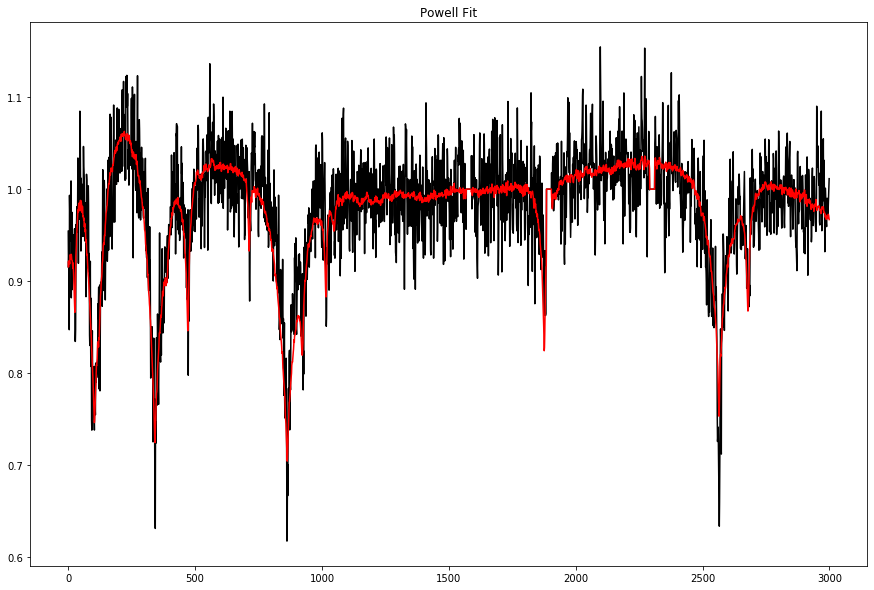

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 542
    # data points      = 2998
    # variables        = 6
    chi-square         = 3.93420693
    reduced chi-square = 0.00131491
    Akaike info crit   = -19882.7021
    Bayesian info crit = -19846.6679
[[Variables]]
    teff1:   17958.2009 +/- 242.218738 (1.35%) (init = 15000)
    logg1:   7.95502467 +/- 0.06211402 (0.78%) (init = 8)
    trans1:  45.0047797 +/- 17.8450051 (39.65%) (init = 0)
    teff2:   15003.8967 +/- 42.6243860 (0.28%) (init = 15000)
    logg2:   8.08320067 +/- 0.01654606 (0.20%) (init = 8)
    trans2:  113.364505 +/- 15.9697123 (14.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, logg1)  =  0.694
    C(trans1, logg2) =  0.122
    C(teff2, logg2)  =  0.110

 Starting Bayesian Sampling................
...Done.


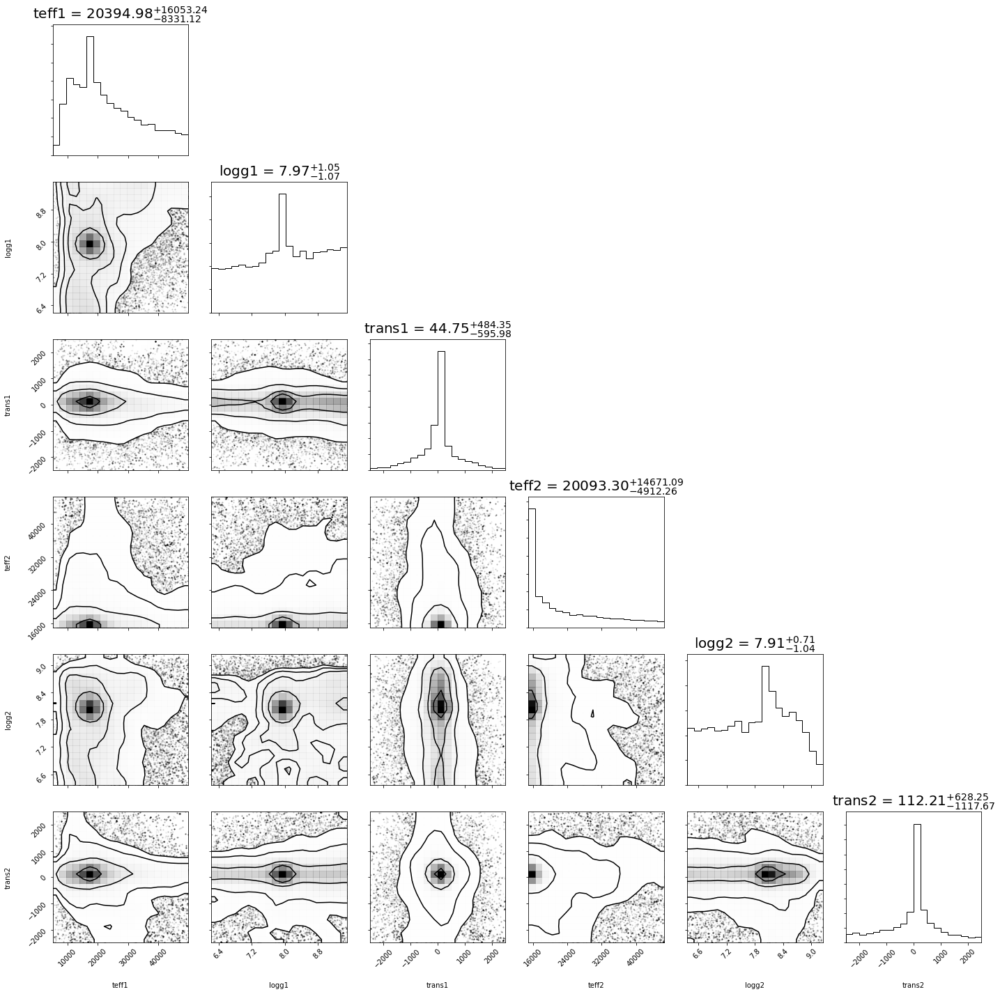

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2998
    # variables        = 6
    chi-square         = 4.73248098
    reduced chi-square = 0.00158171
    Akaike info crit   = -19328.8508
    Bayesian info crit = -19292.8166
[[Variables]]
    teff1:   20394.9845 +/- 12248.9806 (60.06%) (init = 17958.2)
    logg1:   7.96823350 +/- 1.06461759 (13.36%) (init = 7.955025)
    trans1:  44.7534934 +/- 545.295415 (1218.44%) (init = 45.00578)
    teff2:   20093.2963 +/- 9826.87550 (48.91%) (init = 15003.9)
    logg2:   7.91002945 +/- 0.87546211 (11.07%) (init = 8.083201)
    trans2:  112.211666 +/- 878.712254 (783.08%) (init = 113.3645)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, logg1)  =  0.202
    C(teff1, trans2) = -0.144
    C(teff1, teff2)  =  0.107


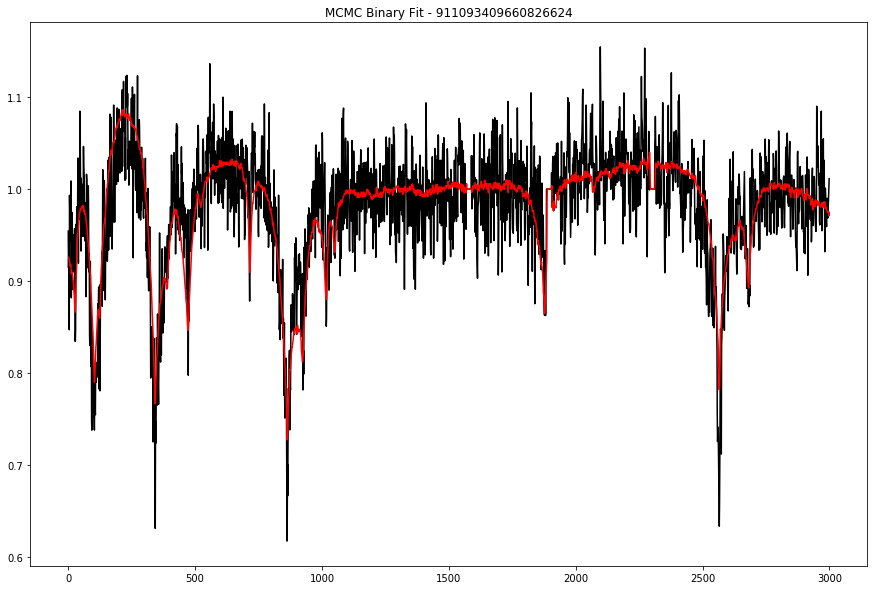

 39%|███▊      | 12/31 [11:27<18:17, 57.75s/it]

Fitting with Powell...


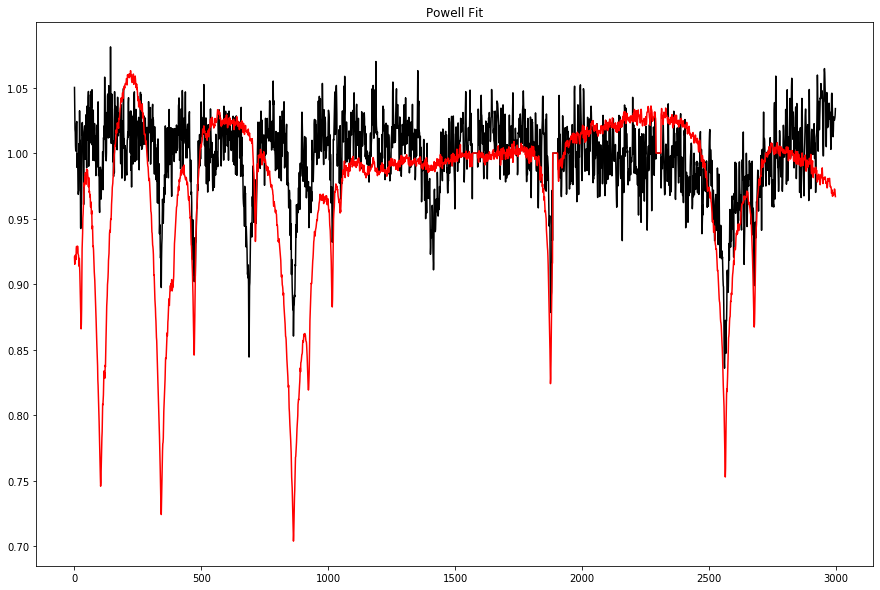

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 375
    # data points      = 2998
    # variables        = 6
    chi-square         = 1.71425808
    reduced chi-square = 5.7295e-04
    Akaike info crit   = -22373.2275
    Bayesian info crit = -22337.1933
##  Warning: uncertainties could not be estimated:
    teff2:   at initial value
    teff2:   at boundary
[[Variables]]
    teff1:   49961.2192 +/-        nan (nan%) (init = 15000)
    logg1:   7.36053395 +/- 0.04099998 (0.56%) (init = 8)
    trans1:  25.4795843 +/- 39.8487448 (156.39%) (init = 0)
    teff2:   15000.0000 +/- 0.02866539 (0.00%) (init = 15000)
    logg2:   8.33729258 +/- 0.00954788 (0.11%) (init = 8)
    trans2:  65.0104410 +/- 16.1695216 (24.87%) (init = 0)

 Starting Bayesian Sampling................
...Done.


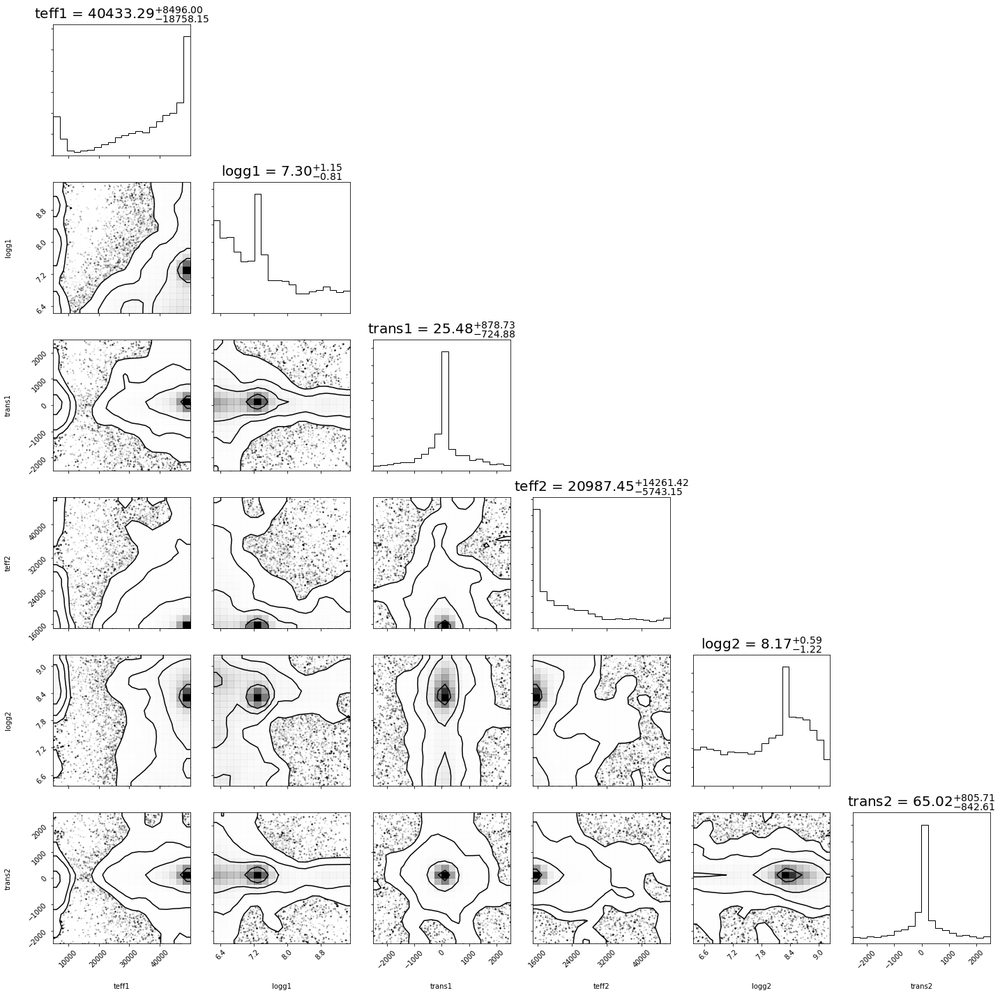

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2999
    # variables        = 6
    chi-square         = 3.28379564
    reduced chi-square = 0.00109716
    Akaike info crit   = -20432.2856
    Bayesian info crit = -20396.2494
[[Variables]]
    teff1:   40433.2853 +/- 13677.5068 (33.83%) (init = 49961.22)
    logg1:   7.30482998 +/- 0.98615096 (13.50%) (init = 7.360534)
    trans1:  25.4807979 +/- 808.864181 (3174.41%) (init = 25.48058)
    teff2:   20987.4543 +/- 10037.3111 (47.83%) (init = 15000)
    logg2:   8.17102923 +/- 0.90880520 (11.12%) (init = 8.337293)
    trans2:  65.0152815 +/- 833.192757 (1281.53%) (init = 65.01044)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, teff2) = -0.268
    C(teff2, logg2) = -0.178


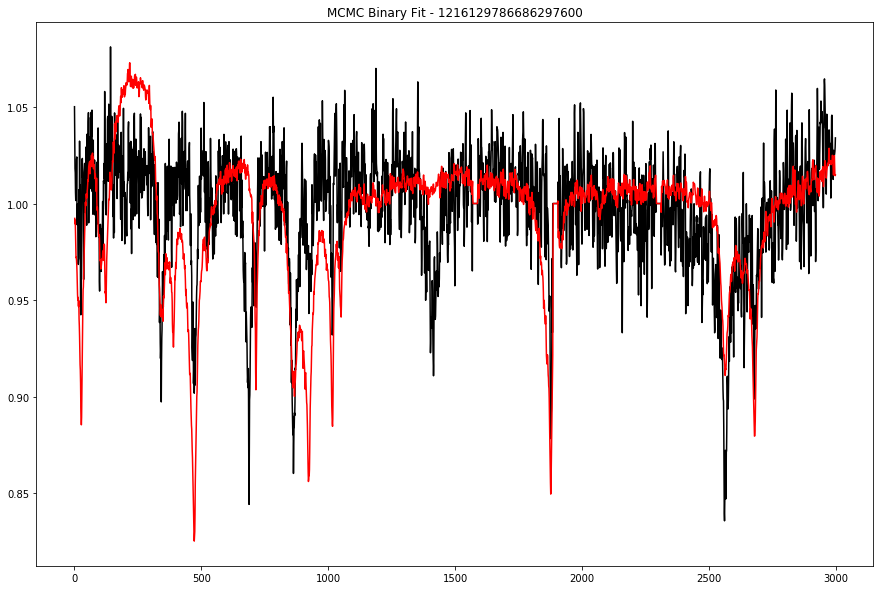

 42%|████▏     | 13/31 [12:23<17:06, 57.03s/it]

Fitting with Powell...


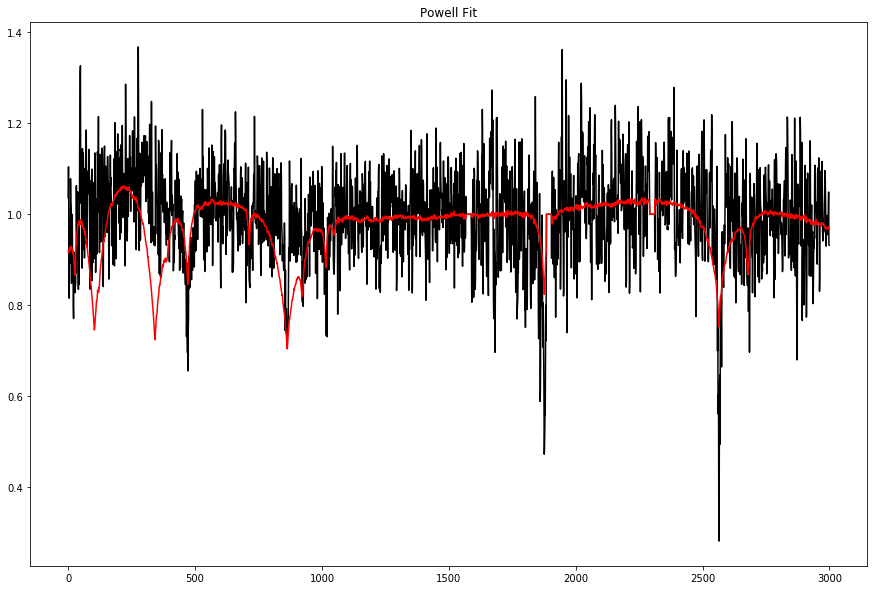

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 365
    # data points      = 2997
    # variables        = 6
    chi-square         = 22.9048946
    reduced chi-square = 0.00765794
    Akaike info crit   = -14595.4273
    Bayesian info crit = -14559.3951
##  Warning: uncertainties could not be estimated:
[[Variables]]
    teff1:   6959.07940 +/- 155.590693 (2.24%) (init = 15000)
    logg1:   8.34124051 +/- 0.10456962 (1.25%) (init = 8)
    trans1: -11.5932553 +/- 23.1586262 (199.76%) (init = 0)
    teff2:   18442.1198 +/-        nan (nan%) (init = 15000)
    logg2:   8.04026728 +/-        nan (nan%) (init = 8)
    trans2:  61.0792932 +/- 31.7031164 (51.90%) (init = 0)

 Starting Bayesian Sampling................
...Done.


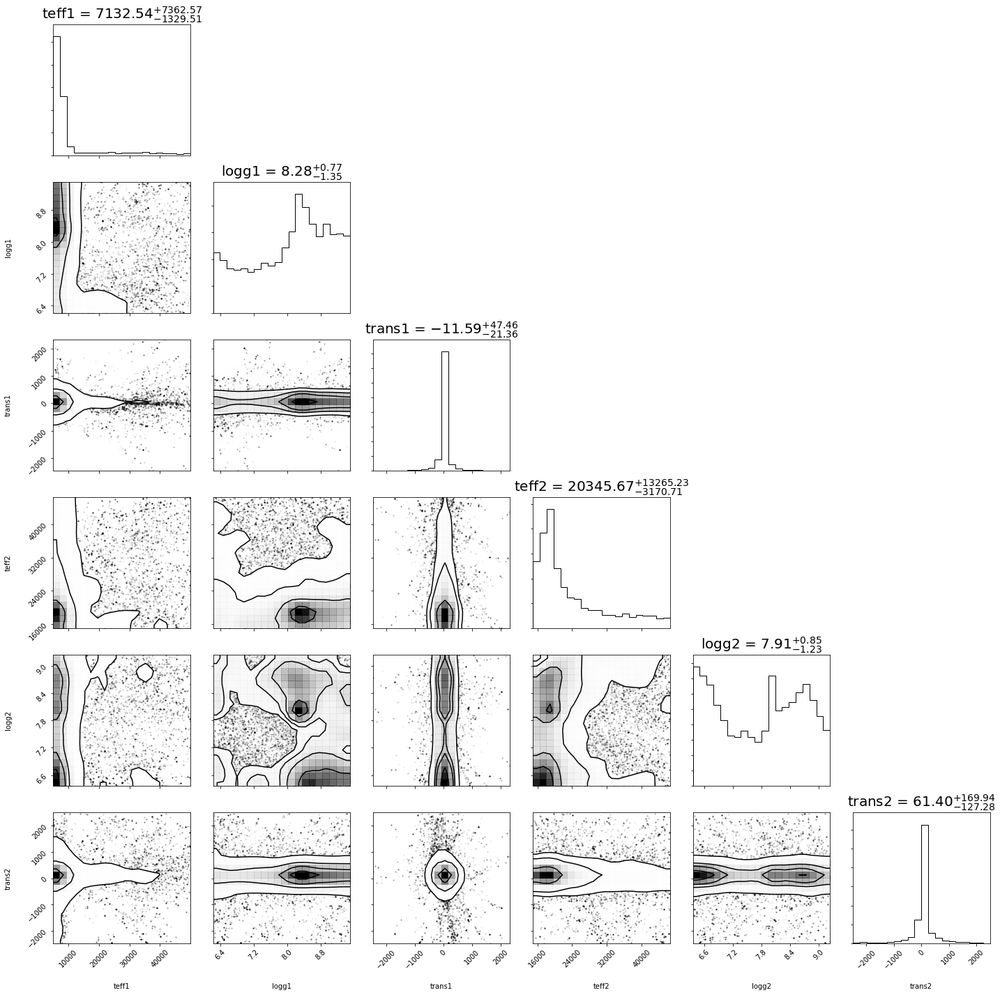

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2998
    # variables        = 6
    chi-square         = 23.1627272
    reduced chi-square = 0.00774155
    Akaike info crit   = -14567.7425
    Bayesian info crit = -14531.7083
[[Variables]]
    teff1:   7132.53837 +/- 4490.08311 (62.95%) (init = 6959.079)
    logg1:   8.27971399 +/- 1.06327433 (12.84%) (init = 8.341241)
    trans1: -11.5886615 +/- 34.7752281 (300.08%) (init = -11.59226)
    teff2:   20345.6652 +/- 8271.27072 (40.65%) (init = 18442.12)
    logg2:   7.90695507 +/- 1.04670096 (13.24%) (init = 8.040267)
    trans2:  61.4023466 +/- 151.533391 (246.79%) (init = 61.07929)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, teff2)   =  0.255
    C(teff1, logg1)   = -0.231
    C(trans1, trans2) = -0.194
    C(logg1, teff2)   = -0.154
    C(teff1, trans2)  =  0.122
    C(teff2, logg2)   =  0.121
    C(logg1, logg2)   = -0.113


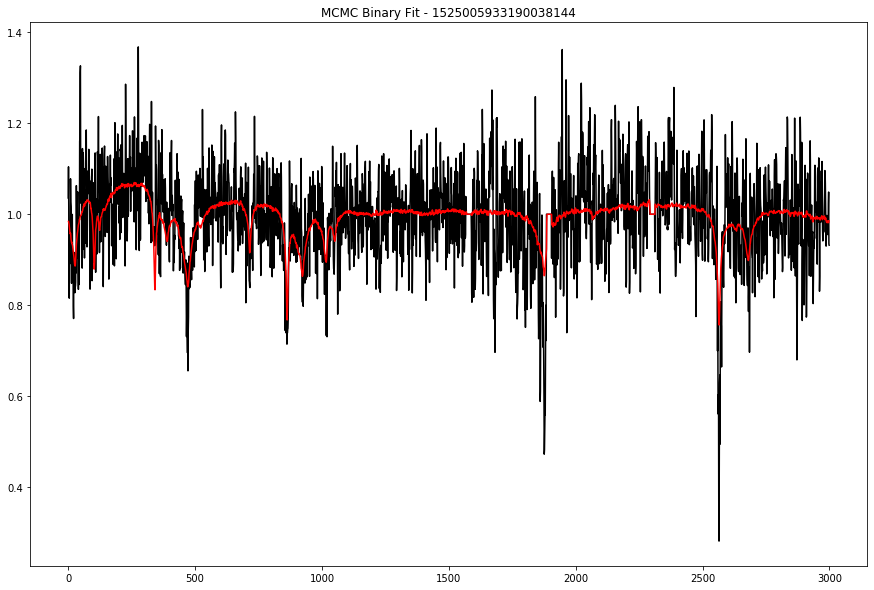

 45%|████▌     | 14/31 [13:20<16:11, 57.12s/it]

Fitting with Powell...


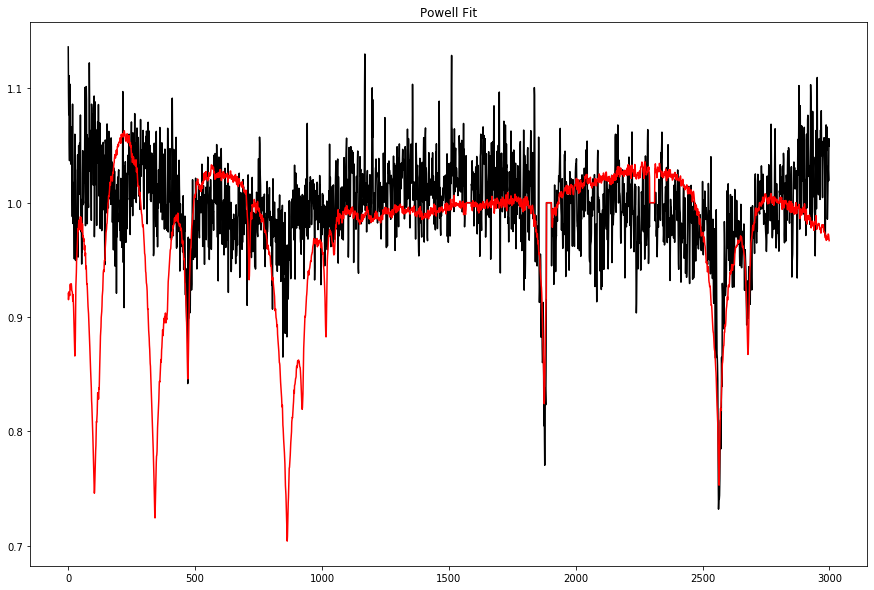

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 535
    # data points      = 2989
    # variables        = 6
    chi-square         = 3.17236973
    reduced chi-square = 0.00106348
    Akaike info crit   = -20457.3156
    Bayesian info crit = -20421.2994
##  Warning: uncertainties could not be estimated:
    teff2:   at initial value
    teff2:   at boundary
[[Variables]]
    teff1:   49600.2464 +/-        nan (nan%) (init = 15000)
    logg1:   6.72823020 +/-        nan (nan%) (init = 8)
    trans1: -343.011059 +/- 96.2114938 (28.05%) (init = 0)
    teff2:   15000.0000 +/- 6.8931e-08 (0.00%) (init = 15000)
    logg2:   8.29446265 +/- 0.03275461 (0.39%) (init = 8)
    trans2:  69.9922879 +/- 25.0119181 (35.74%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(logg2, trans2) =  0.563

 Starting Bayesian Sampling................
...Done.


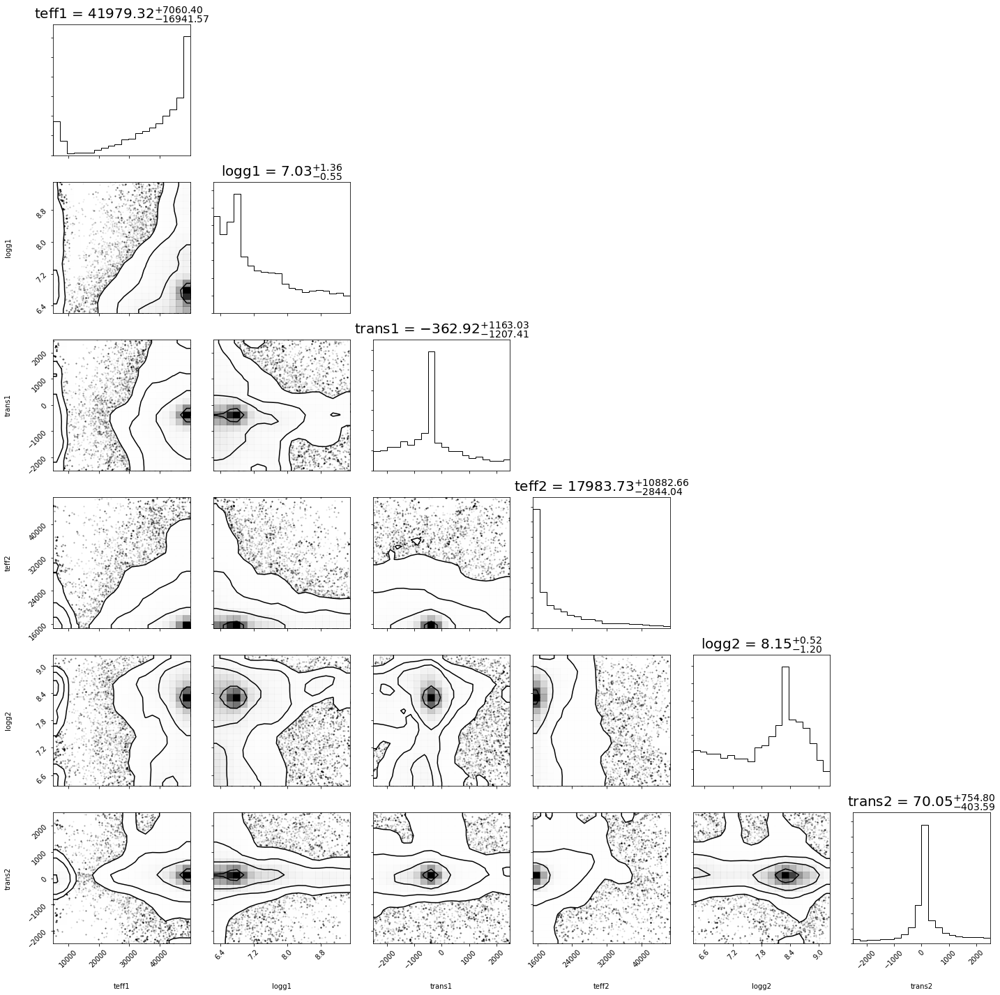

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2990
    # variables        = 6
    chi-square         = 3.83865858
    reduced chi-square = 0.00128641
    Akaike info crit   = -19895.1380
    Bayesian info crit = -19859.1198
[[Variables]]
    teff1:   41979.3242 +/- 12051.2703 (28.71%) (init = 49600.25)
    logg1:   7.02679252 +/- 0.95985439 (13.66%) (init = 6.72823)
    trans1: -362.916785 +/- 1191.80028 (328.39%) (init = -343.0101)
    teff2:   17983.7292 +/- 6898.78438 (38.36%) (init = 15000)
    logg2:   8.14779943 +/- 0.86434224 (10.61%) (init = 8.294463)
    trans2:  70.0478205 +/- 582.680520 (831.83%) (init = 69.99229)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff2, logg2)  = -0.213
    C(teff2, trans2) =  0.177
    C(logg2, trans2) = -0.131
    C(teff1, logg1)  = -0.104


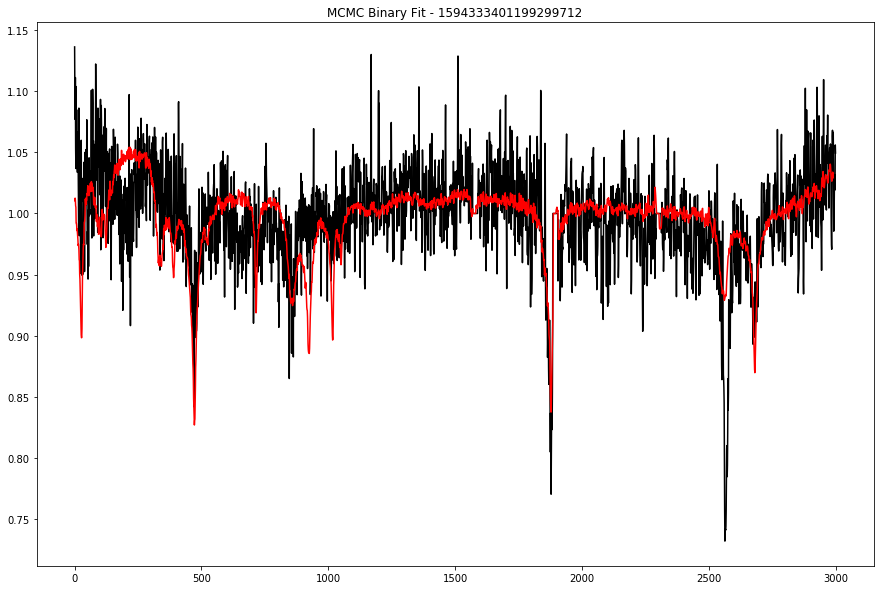

 48%|████▊     | 15/31 [14:17<15:13, 57.09s/it]

Fitting with Powell...


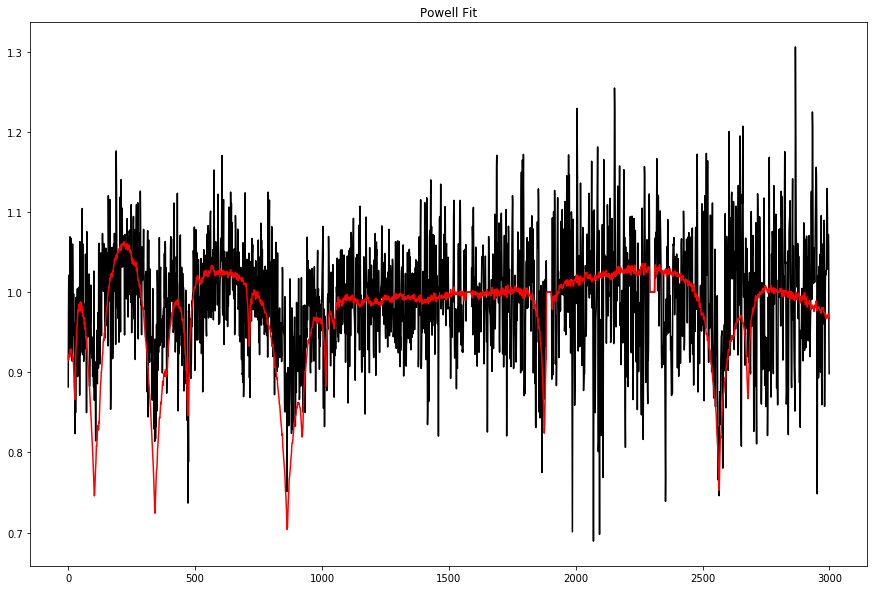

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 659
    # data points      = 2998
    # variables        = 6
    chi-square         = 12.3769300
    reduced chi-square = 0.00413667
    Akaike info crit   = -16446.6195
    Bayesian info crit = -16410.5853
[[Variables]]
    teff1:   33756.9912 +/- 1800.08663 (5.33%) (init = 15000)
    logg1:   7.66532665 +/- 0.17799089 (2.32%) (init = 8)
    trans1: -2.1250e-09 +/- 62.8529295 (2957737077861.08%) (init = 0)
    teff2:   15604.6348 +/- 127.000743 (0.81%) (init = 15000)
    logg2:   8.35443396 +/- 0.04373797 (0.52%) (init = 8)
    trans2:  22.4907889 +/- 16.1604534 (71.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, logg1)  =  0.820
    C(teff2, logg2)  =  0.202
    C(logg2, trans2) =  0.118

 Starting Bayesian Sampling................
...Done.


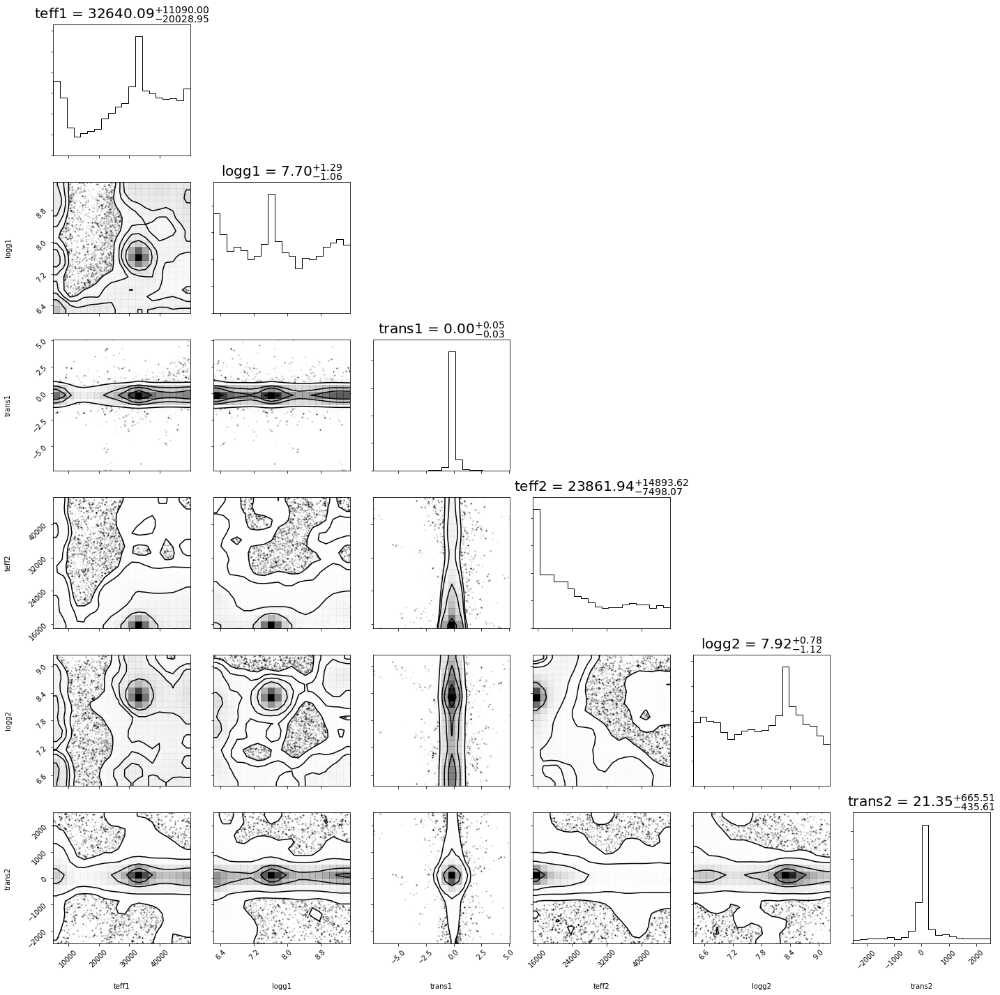

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2999
    # variables        = 6
    chi-square         = 13.4008777
    reduced chi-square = 0.00447741
    Akaike info crit   = -16214.7312
    Bayesian info crit = -16178.6950
[[Variables]]
    teff1:   32640.0947 +/- 15663.6557 (47.99%) (init = 33756.99)
    logg1:   7.70384334 +/- 1.17791297 (15.29%) (init = 7.665327)
    trans1:  0.00100052 +/- 0.04441969 (4439.66%) (init = 0.0009999979)
    teff2:   23861.9381 +/- 11239.4282 (47.10%) (init = 15604.63)
    logg2:   7.91738052 +/- 0.95091074 (12.01%) (init = 8.354434)
    trans2:  21.3512415 +/- 561.283096 (2628.81%) (init = 22.49079)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff2, logg2) = -0.155
    C(teff1, logg1) =  0.140
    C(teff1, teff2) = -0.111


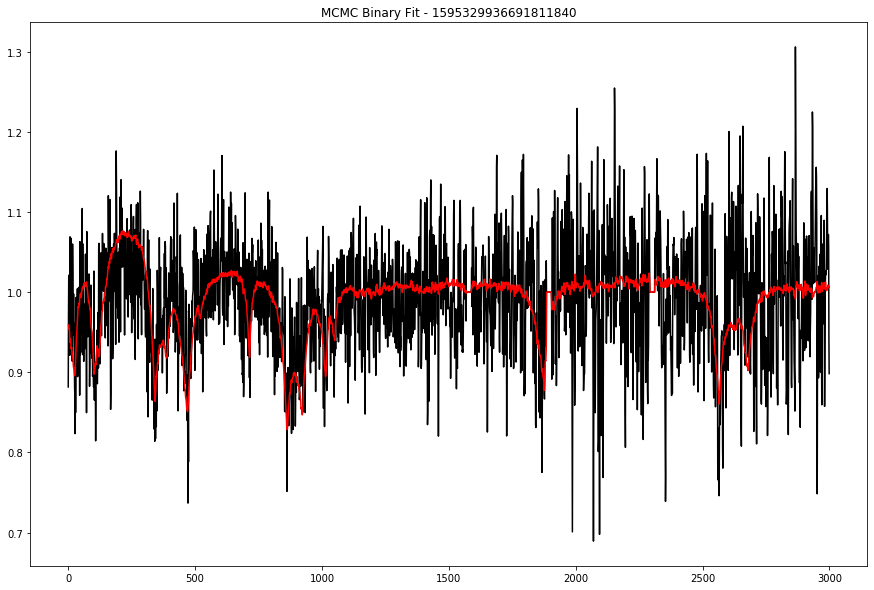

 52%|█████▏    | 16/31 [15:15<14:21, 57.44s/it]

Fitting with Powell...


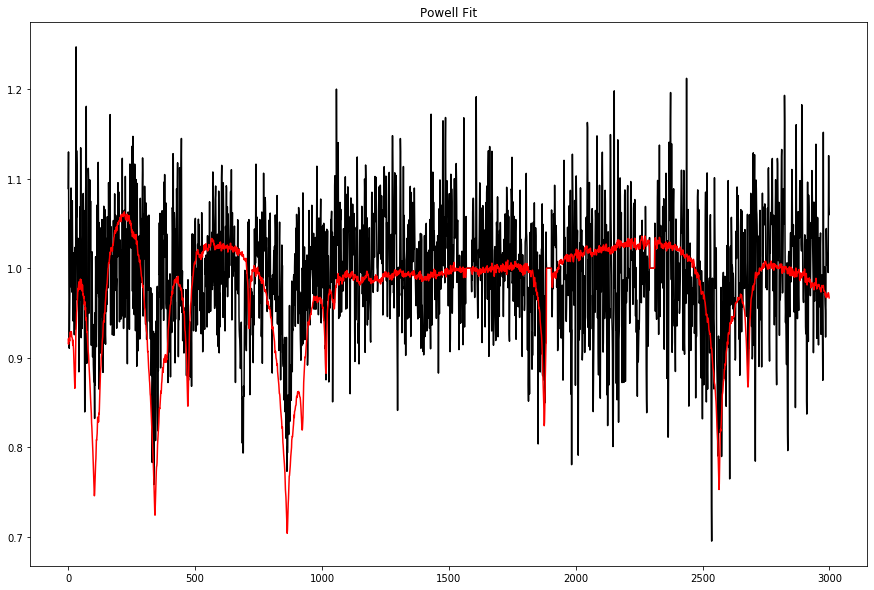

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 626
    # data points      = 2995
    # variables        = 6
    chi-square         = 11.1878219
    reduced chi-square = 0.00374300
    Akaike info crit   = -16729.6716
    Bayesian info crit = -16693.6434
##  Warning: uncertainties could not be estimated:
    teff2:   at initial value
    teff2:   at boundary
[[Variables]]
    teff1:   37819.4793 +/-        nan (nan%) (init = 15000)
    logg1:   7.64158640 +/-        nan (nan%) (init = 8)
    trans1: -128.500904 +/- 74.2847376 (57.81%) (init = 0)
    teff2:   15000.0002 +/- 0.15297869 (0.00%) (init = 15000)
    logg2:   8.34395811 +/- 0.02881075 (0.35%) (init = 8)
    trans2:  3.08460596 +/- 104.318473 (3381.91%) (init = 0)

 Starting Bayesian Sampling................
...Done.


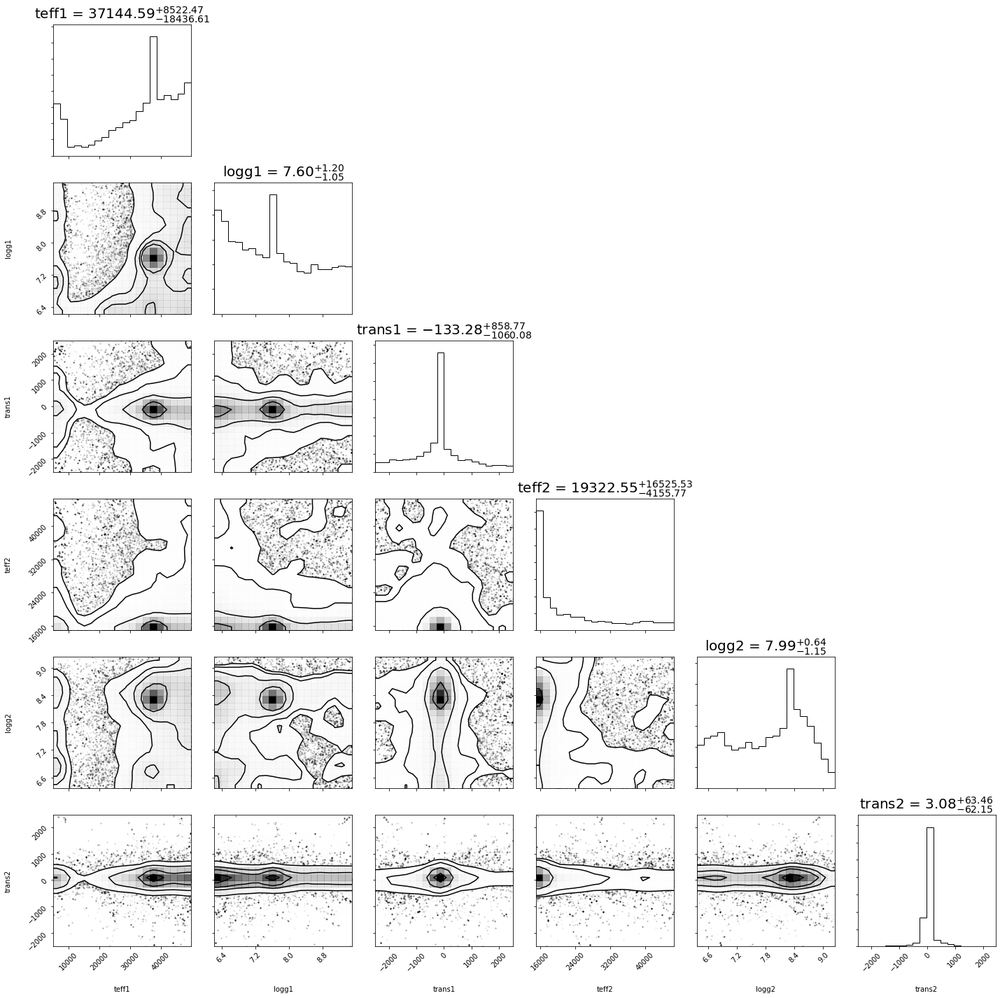

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2995
    # variables        = 6
    chi-square         = 12.7067867
    reduced chi-square = 0.00425118
    Akaike info crit   = -16348.3770
    Bayesian info crit = -16312.3488
[[Variables]]
    teff1:   37144.5862 +/- 13558.1822 (36.50%) (init = 37819.48)
    logg1:   7.60130627 +/- 1.13192524 (14.89%) (init = 7.641586)
    trans1: -133.283322 +/- 968.760466 (726.84%) (init = -128.4999)
    teff2:   19322.5473 +/- 10401.2653 (53.83%) (init = 15000)
    logg2:   7.99144614 +/- 0.89802094 (11.24%) (init = 8.343958)
    trans2:  3.08212620 +/- 64.1317257 (2080.76%) (init = 3.084606)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff2, logg2)   = -0.255
    C(teff1, logg2)   =  0.131
    C(trans1, trans2) =  0.106
    C(teff1, logg1)   =  0.103


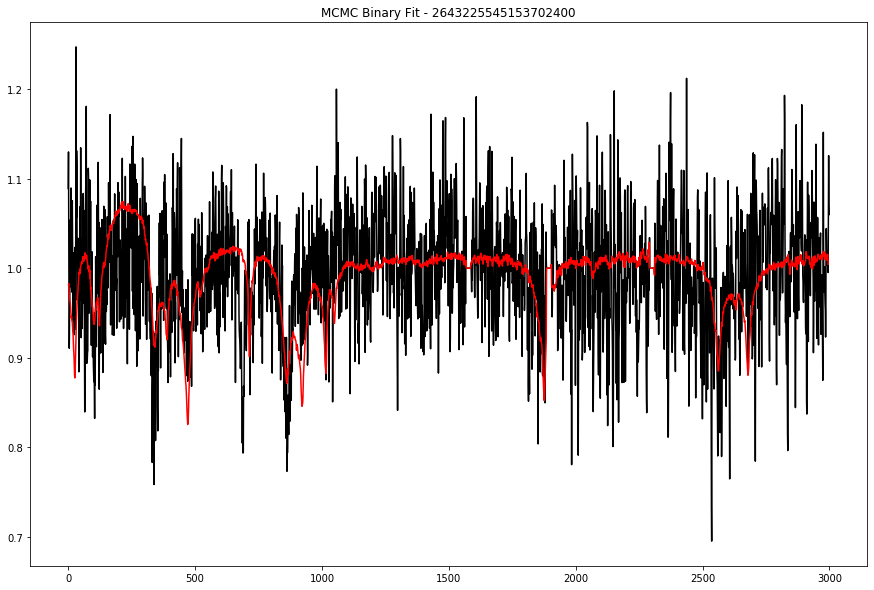

 55%|█████▍    | 17/31 [16:13<13:26, 57.62s/it]

Fitting with Powell...


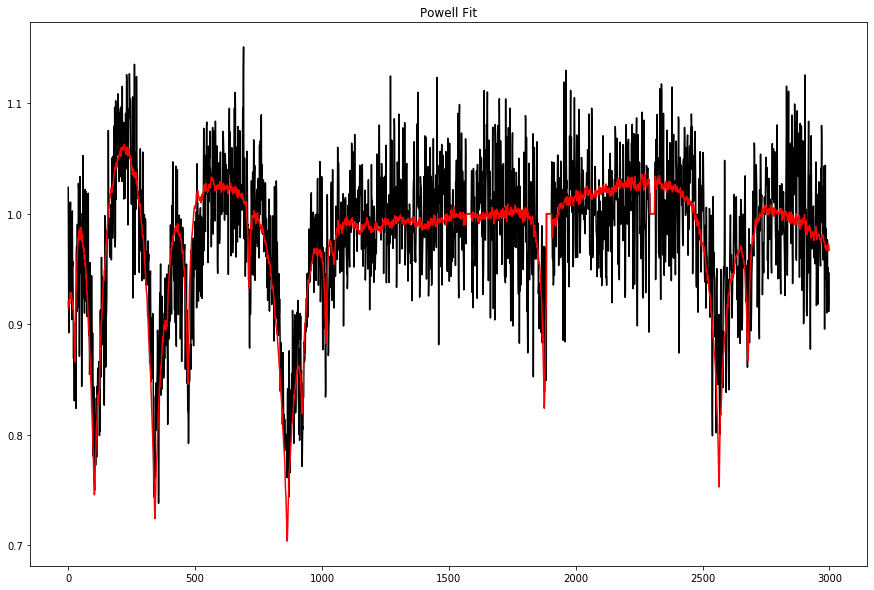

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 664
    # data points      = 2997
    # variables        = 6
    chi-square         = 5.14270265
    reduced chi-square = 0.00171939
    Akaike info crit   = -19072.2616
    Bayesian info crit = -19036.2294
[[Variables]]
    teff1:   23126.7385 +/- 666.243508 (2.88%) (init = 15000)
    logg1:   8.31582670 +/- 0.11254967 (1.35%) (init = 8)
    trans1:  54.8838072 +/- 35.2542404 (64.23%) (init = 0)
    teff2:   30086.6430 +/- 835.808754 (2.78%) (init = 15000)
    logg2:   8.02762500 +/- 0.04430744 (0.55%) (init = 8)
    trans2:  153.476631 +/- 38.5671244 (25.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff2, logg2)   =  0.825
    C(teff1, logg1)   =  0.667
    C(teff2, trans2)  = -0.584
    C(logg2, trans2)  = -0.494
    C(trans1, teff2)  =  0.252
    C(logg1, teff2)   =  0.158
    C(logg1, trans2)  = -0.143
    C(teff1, trans2)  = -0.142
    C(logg1, logg2)   =  0.118
    C(trans

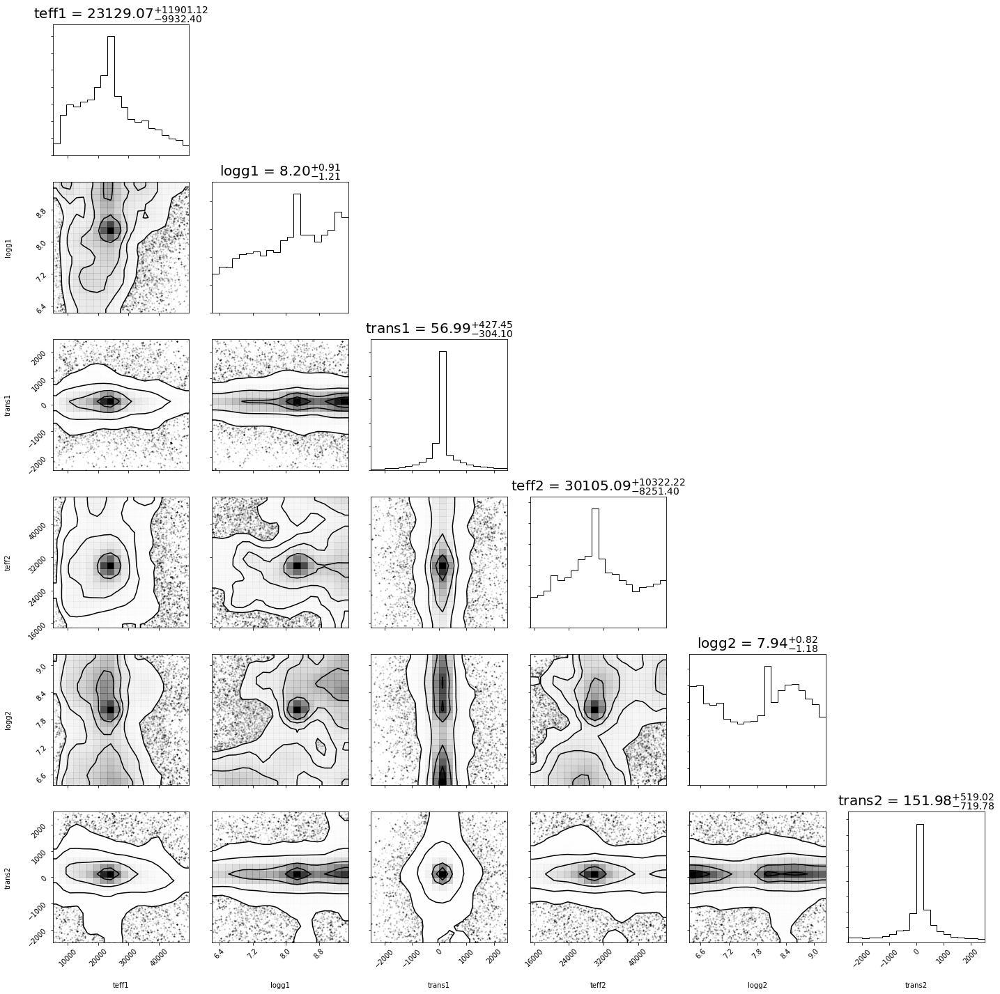

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2997
    # variables        = 6
    chi-square         = 5.16425878
    reduced chi-square = 0.00172660
    Akaike info crit   = -19059.7256
    Bayesian info crit = -19023.6934
[[Variables]]
    teff1:   23129.0675 +/- 10963.9325 (47.40%) (init = 23126.74)
    logg1:   8.20384041 +/- 1.06667328 (13.00%) (init = 8.315827)
    trans1:  56.9883445 +/- 371.527471 (651.94%) (init = 54.88481)
    teff2:   30105.0883 +/- 9334.20792 (31.01%) (init = 30086.64)
    logg2:   7.94196927 +/- 1.00221576 (12.62%) (init = 8.027625)
    trans2:  151.983342 +/- 626.517072 (412.23%) (init = 153.4766)
[[Correlations]] (unreported correlations are < 0.100)
    C(logg1, logg2)  =  0.209
    C(teff1, logg1)  =  0.172
    C(teff2, logg2)  =  0.163
    C(trans1, logg2) = -0.104


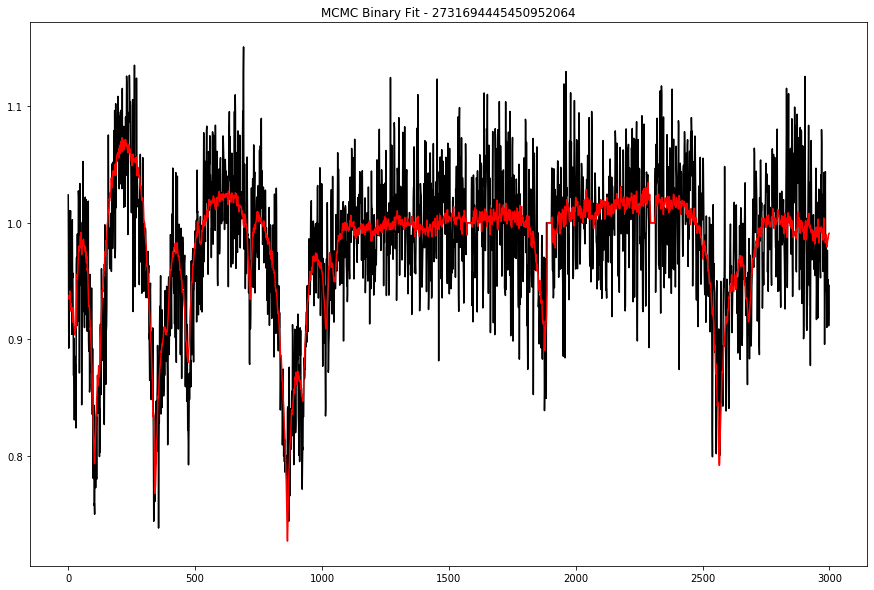

 58%|█████▊    | 18/31 [17:12<12:34, 58.07s/it]

Fitting with Powell...


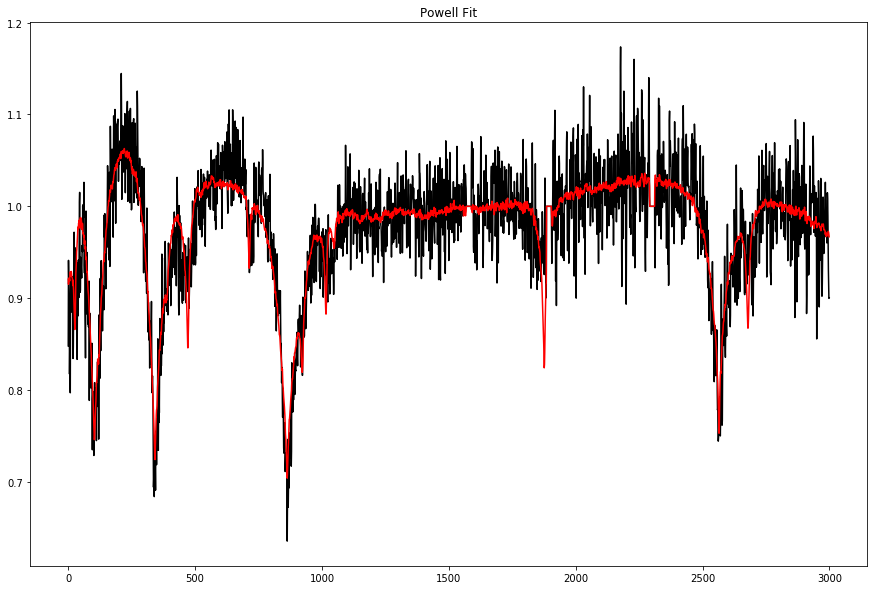

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 481
    # data points      = 2998
    # variables        = 6
    chi-square         = 3.54200284
    reduced chi-square = 0.00118382
    Akaike info crit   = -20197.5430
    Bayesian info crit = -20161.5088
[[Variables]]
    teff1:   14266.2551 +/- 451.835576 (3.17%) (init = 15000)
    logg1:   7.87147306 +/- 0.04814900 (0.61%) (init = 8)
    trans1: -3.73432480 +/- 26.9495118 (721.67%) (init = 0)
    teff2:   31284.2757 +/- 964.477623 (3.08%) (init = 15000)
    logg2:   7.97401951 +/- 0.04586423 (0.58%) (init = 8)
    trans2:  17.0426363 +/- 70.6322274 (414.44%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, logg1)   =  0.804
    C(teff2, trans2)  =  0.753
    C(teff2, logg2)   =  0.750
    C(logg2, trans2)  =  0.576
    C(trans1, teff2)  =  0.567
    C(trans1, trans2) =  0.466
    C(trans1, logg2)  =  0.382
    C(teff1, teff2)   = -0.249
    C(teff1, trans2)  = -0.225
    C(tef

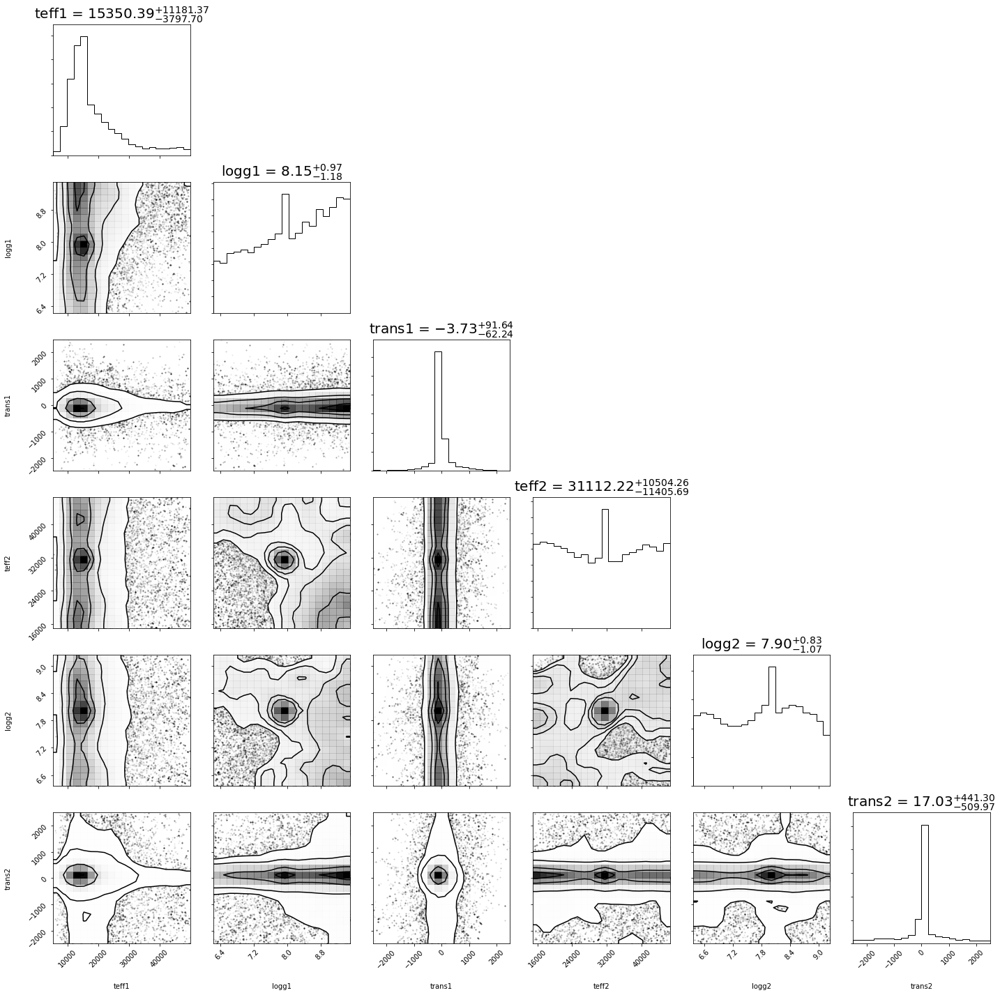

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2998
    # variables        = 6
    chi-square         = 3.57349764
    reduced chi-square = 0.00119435
    Akaike info crit   = -20171.0032
    Bayesian info crit = -20134.9690
[[Variables]]
    teff1:   15350.3895 +/- 7542.63199 (49.14%) (init = 14266.26)
    logg1:   8.15155482 +/- 1.08148469 (13.27%) (init = 7.871473)
    trans1: -3.73357534 +/- 79.8055490 (2137.51%) (init = -3.733325)
    teff2:   31112.2171 +/- 11005.1944 (35.37%) (init = 31284.28)
    logg2:   7.89564530 +/- 0.95254645 (12.06%) (init = 7.97402)
    trans2:  17.0336115 +/- 489.472542 (2873.57%) (init = 17.04264)
[[Correlations]] (unreported correlations are < 0.100)
    C(logg1, teff2)   = -0.220
    C(teff1, logg1)   =  0.213
    C(logg1, logg2)   = -0.120
    C(teff2, logg2)   =  0.119
    C(trans1, trans2) =  0.103


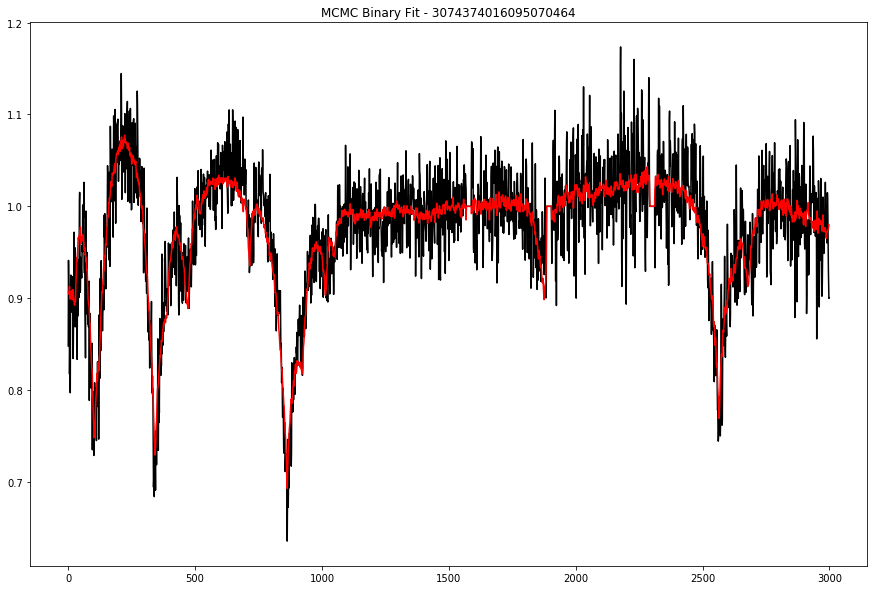

 61%|██████▏   | 19/31 [18:12<11:42, 58.51s/it]

Fitting with Powell...


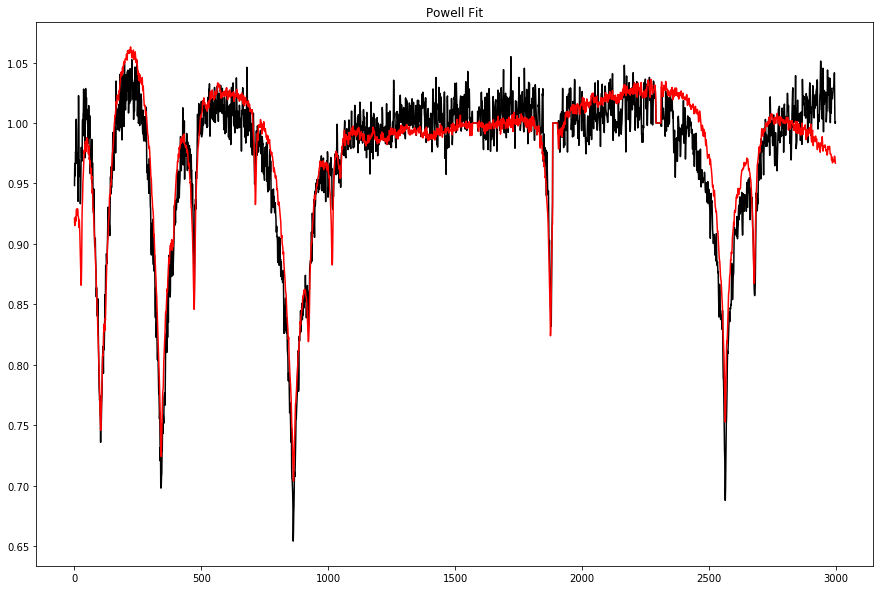

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 455
    # data points      = 2999
    # variables        = 6
    chi-square         = 1.04759778
    reduced chi-square = 3.5002e-04
    Akaike info crit   = -23858.6439
    Bayesian info crit = -23822.6077
[[Variables]]
    teff1:   12818.4770 +/- 202.006179 (1.58%) (init = 15000)
    logg1:   9.35803284 +/- 0.05631938 (0.60%) (init = 8)
    trans1:  20.5351060 +/- 11.8044372 (57.48%) (init = 0)
    teff2:   15000.0000 +/- 0.01015440 (0.00%) (init = 15000)
    logg2:   8.33638109 +/- 0.01378060 (0.17%) (init = 8)
    trans2:  10.3974564 +/- 9.88472988 (95.07%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, logg1) = -0.498

 Starting Bayesian Sampling................
...Done.


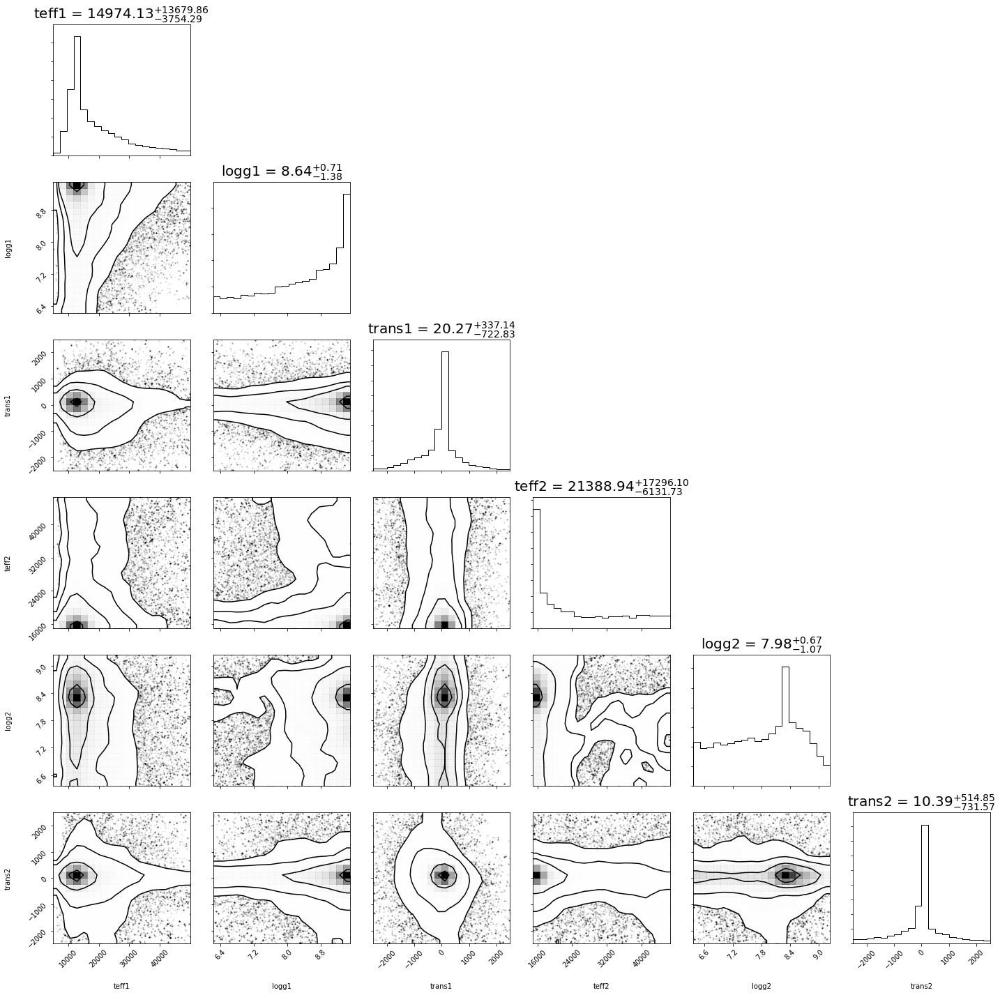

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2999
    # variables        = 6
    chi-square         = 2.60434391
    reduced chi-square = 8.7014e-04
    Akaike info crit   = -21127.5113
    Bayesian info crit = -21091.4751
[[Variables]]
    teff1:   14974.1321 +/- 8766.93203 (58.55%) (init = 12818.48)
    logg1:   8.64139551 +/- 1.04935415 (12.14%) (init = 9.358033)
    trans1:  20.2689641 +/- 537.803956 (2653.34%) (init = 20.53611)
    teff2:   21388.9438 +/- 11746.4610 (54.92%) (init = 15000)
    logg2:   7.97663244 +/- 0.87227825 (10.94%) (init = 8.336381)
    trans2:  10.3929465 +/- 631.085842 (6072.25%) (init = 10.39746)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, teff2)   =  0.240
    C(teff2, logg2)   = -0.207
    C(trans1, trans2) = -0.126
    C(logg1, teff2)   = -0.122
    C(trans1, logg2)  =  0.103


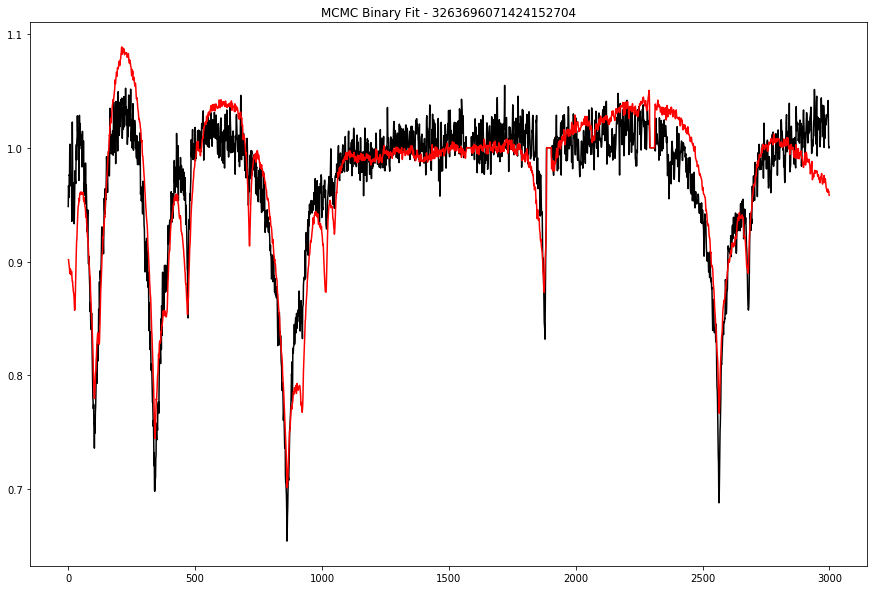

 65%|██████▍   | 20/31 [19:09<10:39, 58.15s/it]

Fitting with Powell...


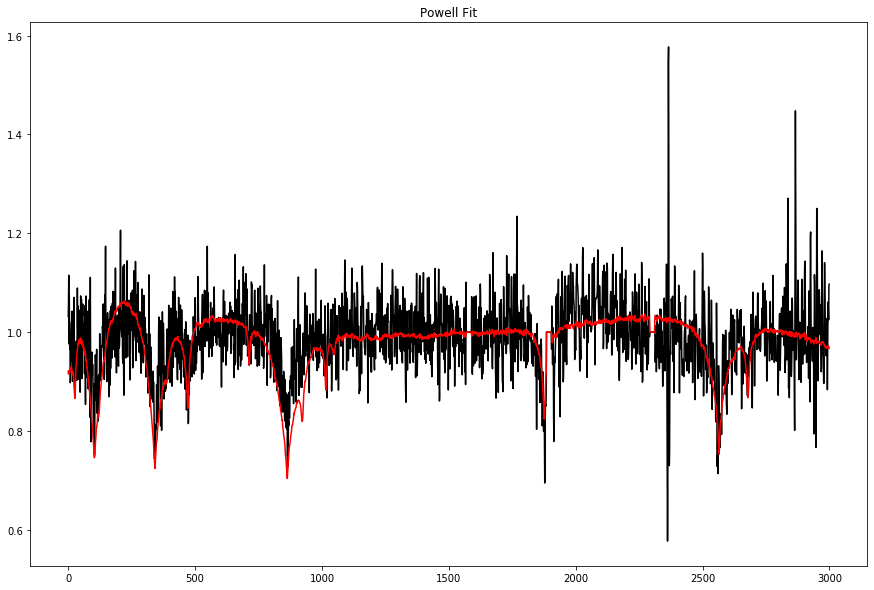

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 505
    # data points      = 2997
    # variables        = 6
    chi-square         = 11.1672434
    reduced chi-square = 0.00373362
    Akaike info crit   = -16748.3697
    Bayesian info crit = -16712.3375
##  Warning: uncertainties could not be estimated:
    teff2:   at initial value
    teff2:   at boundary
[[Variables]]
    teff1:   30187.7446 +/- 1203.30197 (3.99%) (init = 15000)
    logg1:   8.05228293 +/- 0.09169786 (1.14%) (init = 8)
    trans1:  86.2503090 +/- 47.7352606 (55.35%) (init = 0)
    teff2:   15000.0021 +/- 1.14382506 (0.01%) (init = 15000)
    logg2:   8.23571796 +/- 0.01298163 (0.16%) (init = 8)
    trans2:  136.466250 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, logg1) =  0.816

 Starting Bayesian Sampling................
...Done.


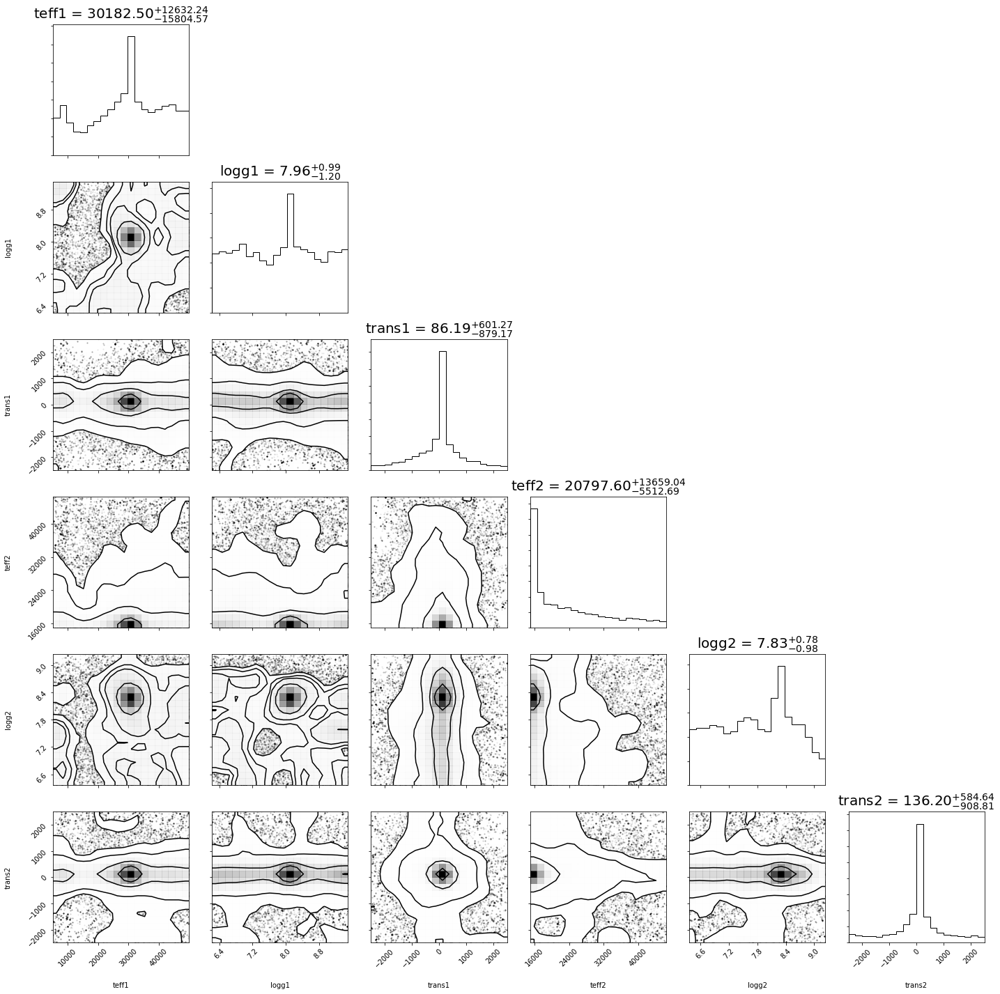

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2998
    # variables        = 6
    chi-square         = 12.4059210
    reduced chi-square = 0.00414636
    Akaike info crit   = -16439.6054
    Bayesian info crit = -16403.5712
[[Variables]]
    teff1:   30182.4987 +/- 14279.3370 (47.31%) (init = 30187.74)
    logg1:   7.96373138 +/- 1.10116074 (13.83%) (init = 8.052283)
    trans1:  86.1890107 +/- 748.868674 (868.87%) (init = 86.25131)
    teff2:   20797.5978 +/- 9627.68137 (46.29%) (init = 15000)
    logg2:   7.82536686 +/- 0.88356098 (11.29%) (init = 8.235718)
    trans2:  136.201635 +/- 755.021192 (554.34%) (init = 136.4663)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff2, logg2) = -0.159


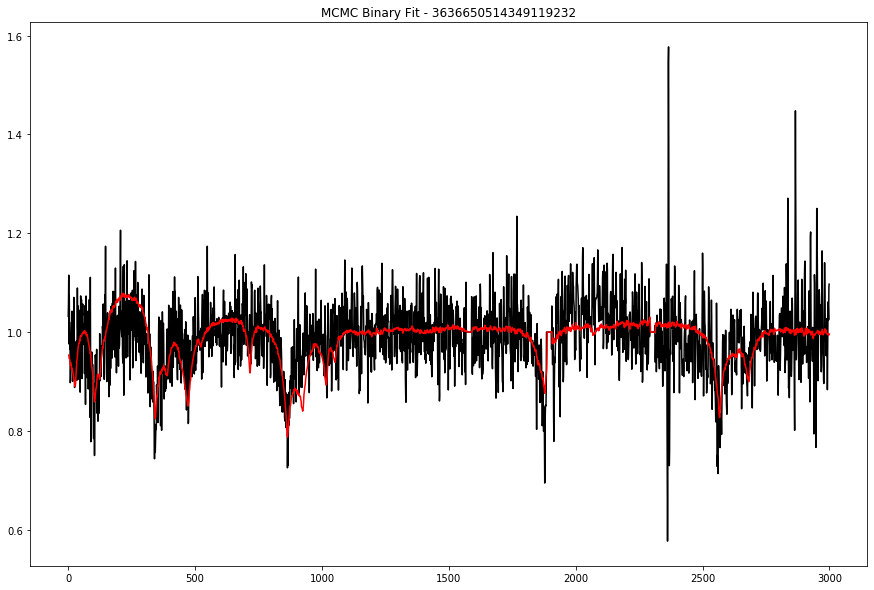

 68%|██████▊   | 21/31 [20:07<09:39, 57.93s/it]

Fitting with Powell...


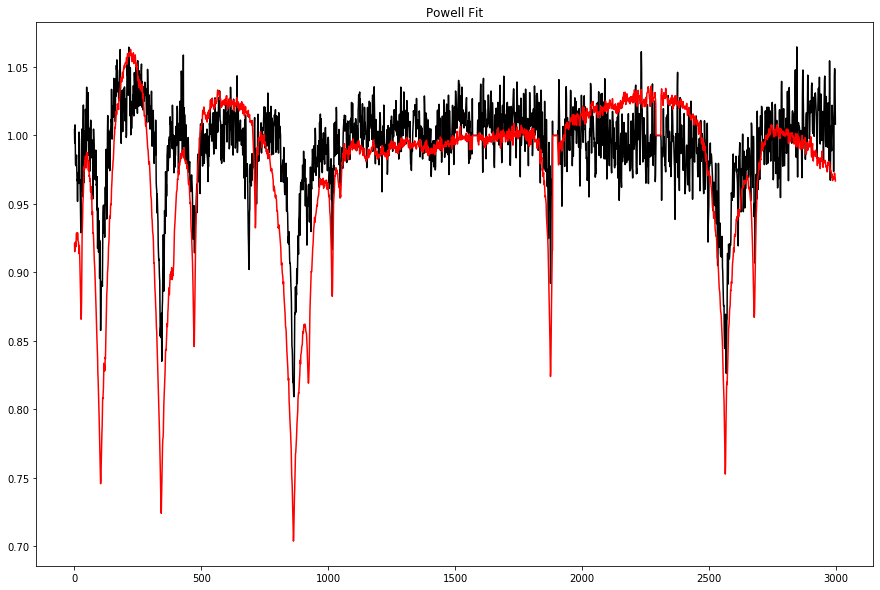

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 1286
    # data points      = 2998
    # variables        = 6
    chi-square         = 0.96449412
    reduced chi-square = 3.2236e-04
    Akaike info crit   = -24097.4730
    Bayesian info crit = -24061.4388
[[Variables]]
    teff1:   22554.7377 +/- 250.368709 (1.11%) (init = 15000)
    logg1:   6.22293276 +/- 0.01003881 (0.16%) (init = 8)
    trans1:  16.6420585 +/- 15.8823404 (95.43%) (init = 0)
    teff2:   15000.0000 +/- 0.01966500 (0.00%) (init = 15000)
    logg2:   8.35211114 +/- 0.01092614 (0.13%) (init = 8)
    trans2:  66.9696883 +/- 17.4148645 (26.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, logg1) =  0.255

 Starting Bayesian Sampling................
...Done.


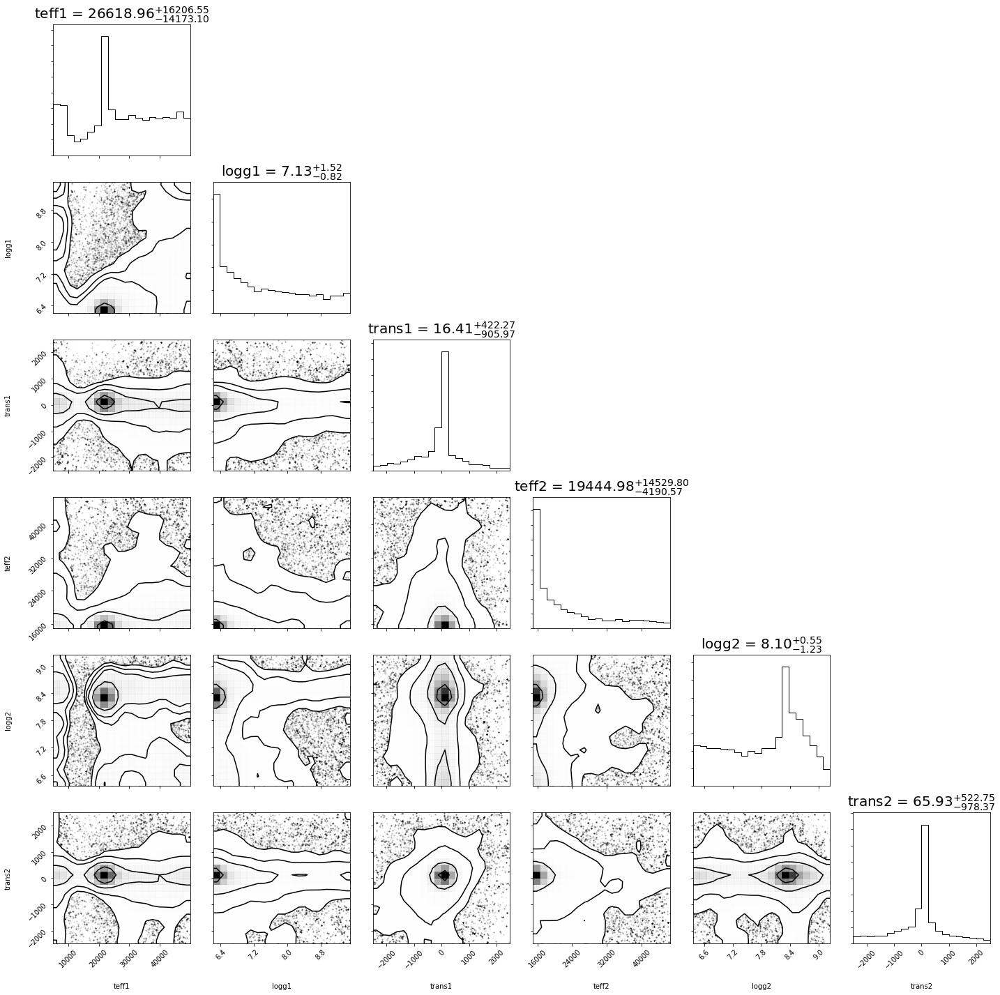

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2999
    # variables        = 6
    chi-square         = 2.08455218
    reduced chi-square = 6.9648e-04
    Akaike info crit   = -21795.1689
    Bayesian info crit = -21759.1327
[[Variables]]
    teff1:   26618.9631 +/- 15257.7979 (57.32%) (init = 22554.74)
    logg1:   7.12852941 +/- 1.17382183 (16.47%) (init = 6.222933)
    trans1:  16.4108067 +/- 672.476548 (4097.77%) (init = 16.64306)
    teff2:   19444.9784 +/- 9411.23154 (48.40%) (init = 15000)
    logg2:   8.10480184 +/- 0.89350649 (11.02%) (init = 8.352111)
    trans2:  65.9332753 +/- 758.983700 (1151.14%) (init = 66.96969)
[[Correlations]] (unreported correlations are < 0.100)
    C(logg1, teff2)   =  0.220
    C(trans1, trans2) =  0.213
    C(teff1, logg1)   =  0.157
    C(teff2, logg2)   = -0.104


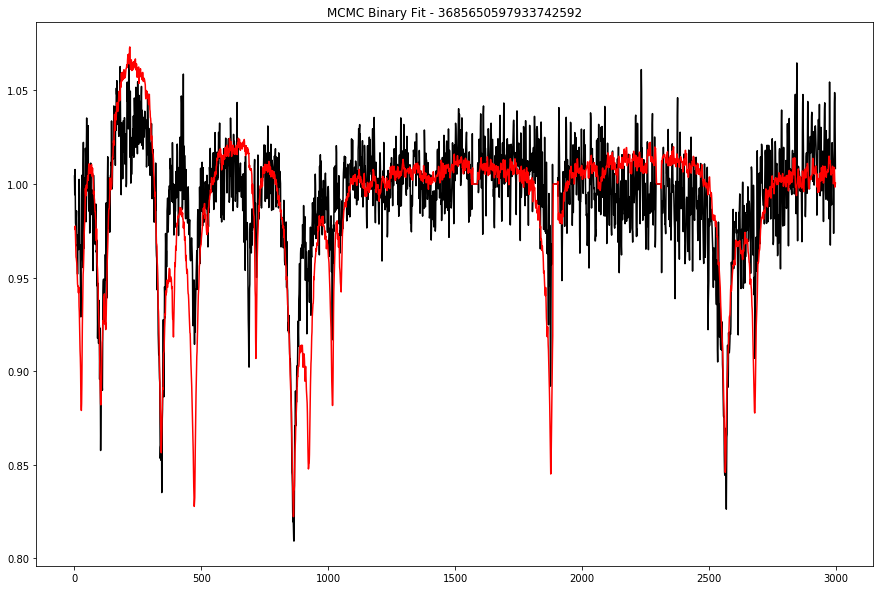

 71%|███████   | 22/31 [21:03<08:38, 57.58s/it]

Fitting with Powell...


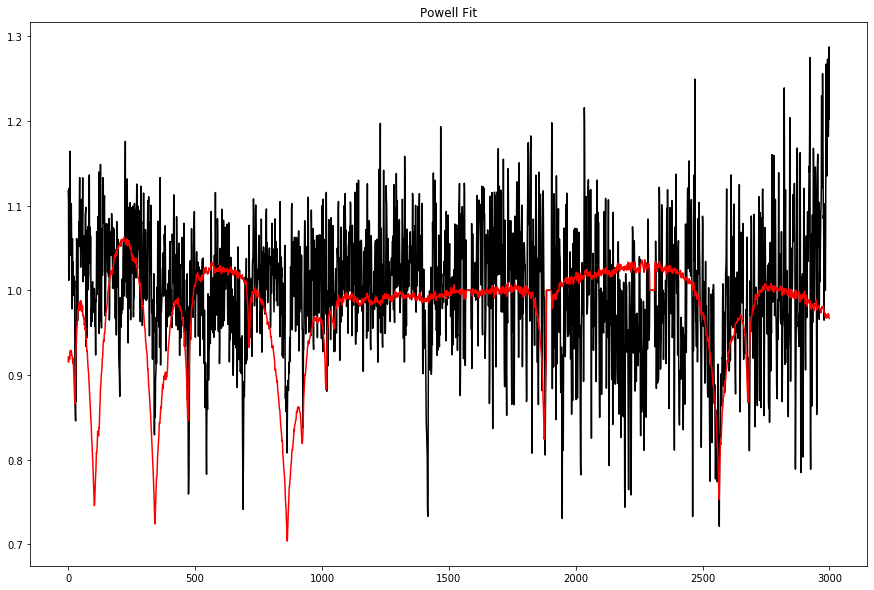

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 528
    # data points      = 2965
    # variables        = 6
    chi-square         = 14.0610493
    reduced chi-square = 0.00475196
    Akaike info crit   = -15854.3786
    Bayesian info crit = -15818.4108
##  Warning: uncertainties could not be estimated:
    teff2:   at initial value
    teff2:   at boundary
[[Variables]]
    teff1:   49961.0067 +/- 40.1864793 (0.08%) (init = 15000)
    logg1:   6.57621166 +/- 0.10565284 (1.61%) (init = 8)
    trans1: -1285.00845 +/- 142.391981 (11.08%) (init = 0)
    teff2:   15000.0000 +/- 5.0920e-08 (0.00%) (init = 15000)
    logg2:   8.33198851 +/-        nan (nan%) (init = 8)
    trans2:  211.019414 +/-        nan (nan%) (init = 0)

 Starting Bayesian Sampling................
...Done.


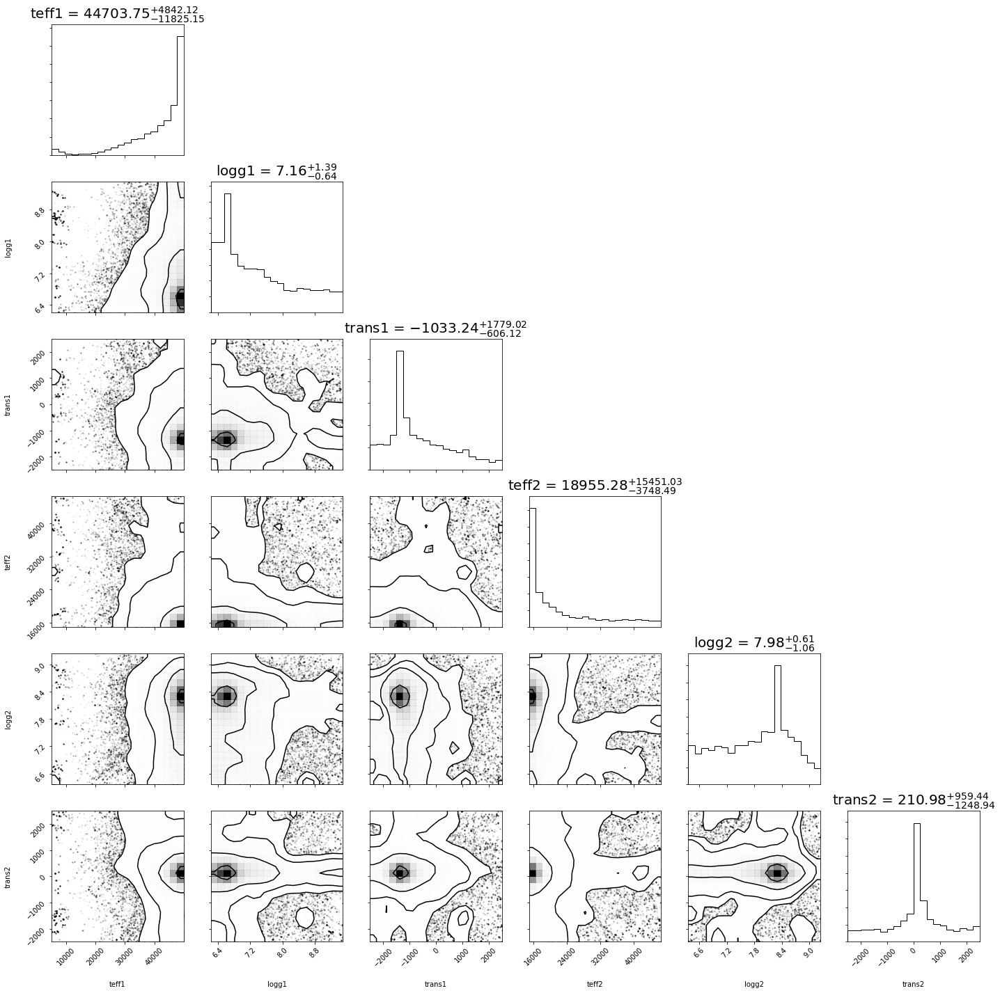

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2972
    # variables        = 6
    chi-square         = 16.0777163
    reduced chi-square = 0.00542067
    Akaike info crit   = -15500.5209
    Bayesian info crit = -15464.5390
[[Variables]]
    teff1:   44703.7491 +/- 8359.74328 (18.70%) (init = 49961.01)
    logg1:   7.15860859 +/- 1.01976387 (14.25%) (init = 6.576212)
    trans1: -1033.23836 +/- 1200.04857 (116.14%) (init = -1285.007)
    teff2:   18955.2800 +/- 9669.11398 (51.01%) (init = 15000)
    logg2:   7.97787098 +/- 0.83710063 (10.49%) (init = 8.331989)
    trans2:  210.975590 +/- 1119.13861 (530.46%) (init = 211.0194)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, teff2)  = -0.403
    C(trans1, teff2) =  0.310
    C(teff1, trans1) = -0.255
    C(teff2, logg2)  = -0.201
    C(teff1, logg2)  =  0.151


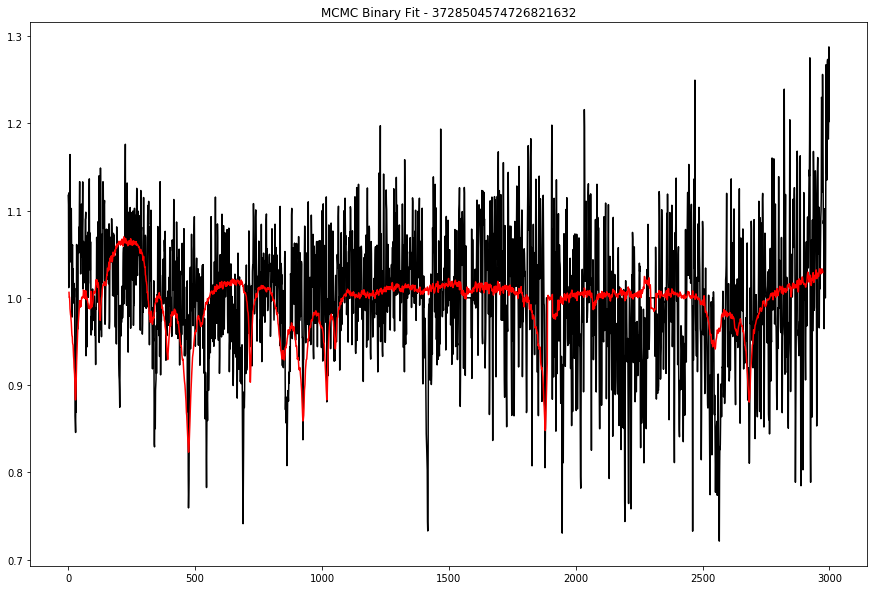

 74%|███████▍  | 23/31 [21:59<07:35, 56.95s/it]

Fitting with Powell...


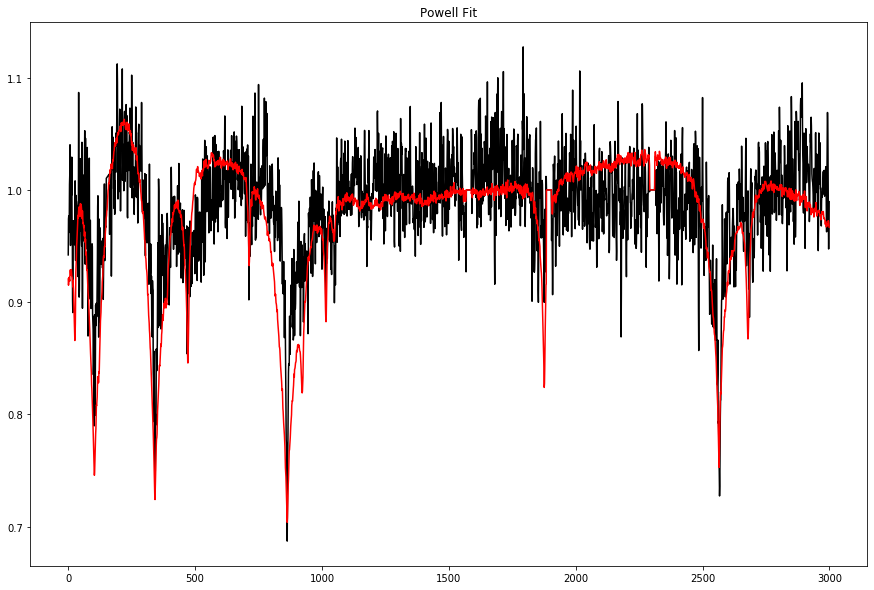

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 504
    # data points      = 2998
    # variables        = 6
    chi-square         = 3.12463598
    reduced chi-square = 0.00104433
    Akaike info crit   = -20573.4159
    Bayesian info crit = -20537.3817
[[Variables]]
    teff1:   31272.4812 +/- 856.420054 (2.74%) (init = 15000)
    logg1:   8.07042116 +/- 0.05674678 (0.70%) (init = 8)
    trans1:  44.4308624 +/- 19.4951977 (43.88%) (init = 0)
    teff2:   15000.0001 +/- 0.06737060 (0.00%) (init = 15000)
    logg2:   8.33196022 +/- 0.02724104 (0.33%) (init = 8)
    trans2:  102.544379 +/- 55.0517755 (53.69%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, logg1)  =  0.895
    C(logg2, trans2) = -0.425

 Starting Bayesian Sampling................
...Done.


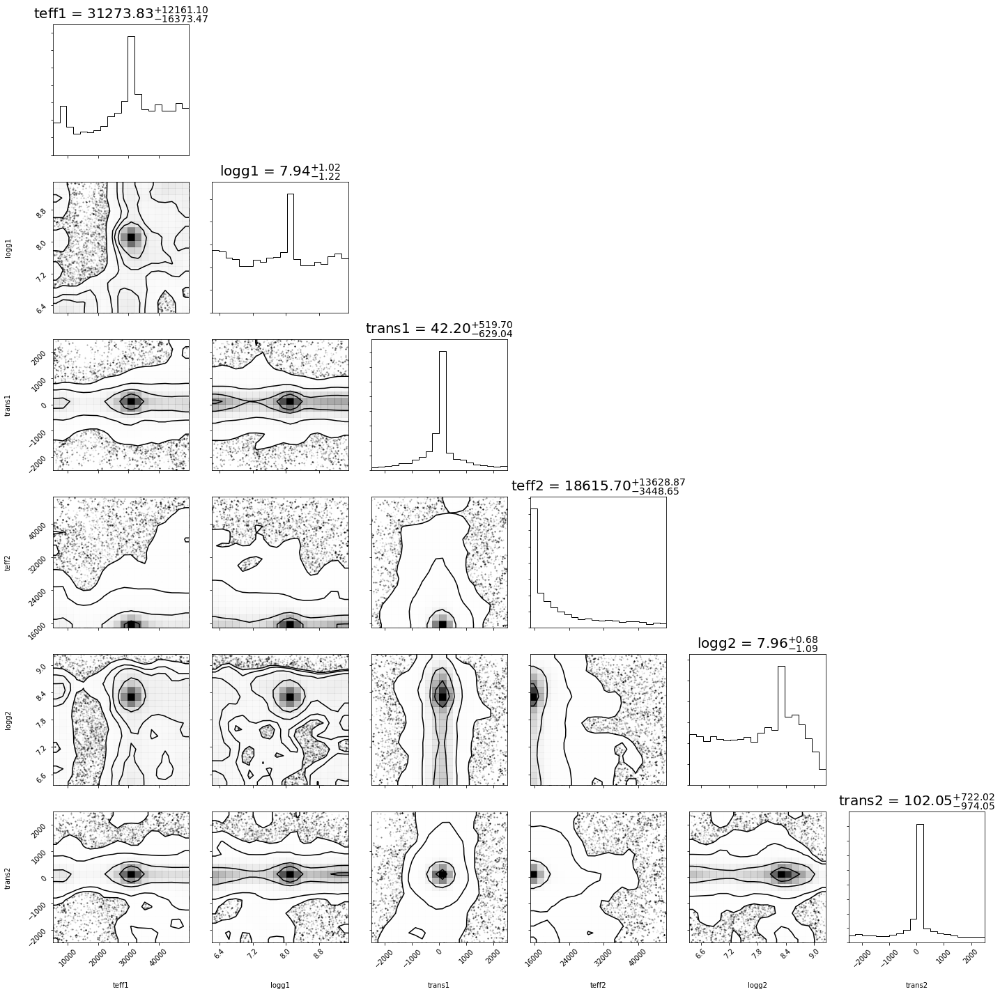

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2998
    # variables        = 6
    chi-square         = 3.90139293
    reduced chi-square = 0.00130394
    Akaike info crit   = -19907.8124
    Bayesian info crit = -19871.7781
[[Variables]]
    teff1:   31273.8342 +/- 14356.6739 (45.91%) (init = 31272.48)
    logg1:   7.94381723 +/- 1.12425468 (14.15%) (init = 8.070421)
    trans1:  42.1997512 +/- 581.798020 (1378.68%) (init = 44.43186)
    teff2:   18615.7004 +/- 8591.07736 (46.15%) (init = 15000)
    logg2:   7.95646528 +/- 0.89102500 (11.20%) (init = 8.33196)
    trans2:  102.049783 +/- 861.134309 (843.84%) (init = 102.5444)
[[Correlations]] (unreported correlations are < 0.100)
    C(trans1, trans2) =  0.165
    C(teff1, logg1)   =  0.159
    C(teff2, logg2)   = -0.104


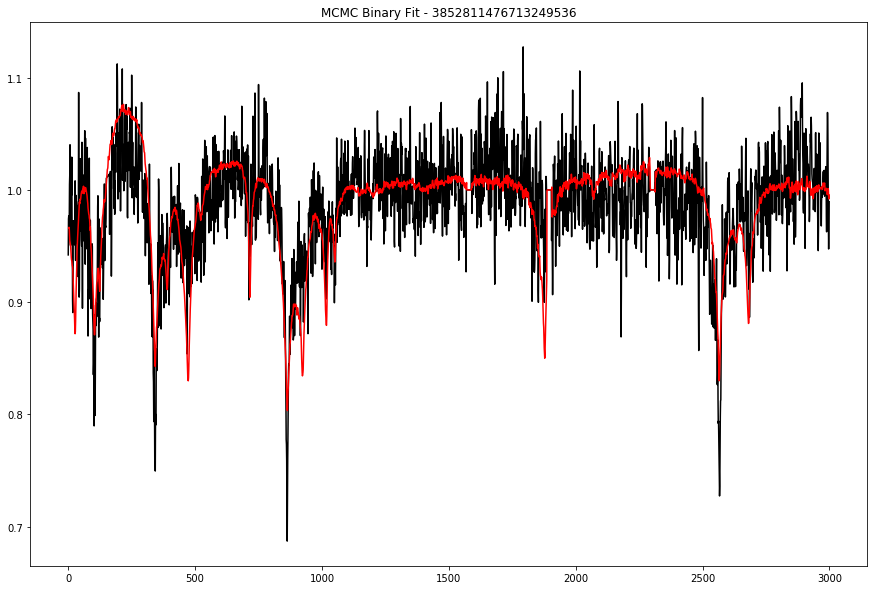

 77%|███████▋  | 24/31 [22:55<06:37, 56.82s/it]

Fitting with Powell...


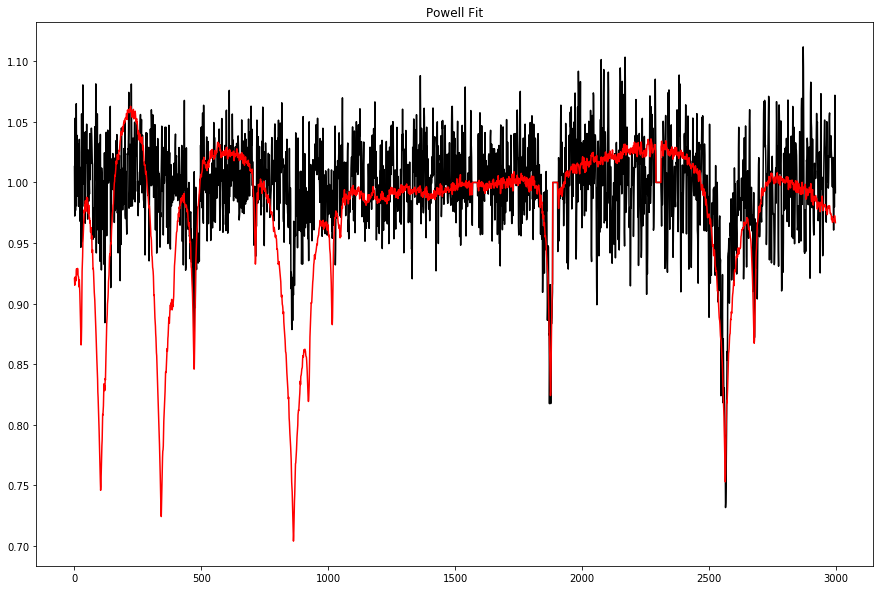

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 420
    # data points      = 2989
    # variables        = 6
    chi-square         = 3.30377043
    reduced chi-square = 0.00110753
    Akaike info crit   = -20336.0054
    Bayesian info crit = -20299.9893
##  Warning: uncertainties could not be estimated:
    teff2:   at initial value
    teff2:   at boundary
[[Variables]]
    teff1:   49935.8887 +/-        nan (nan%) (init = 15000)
    logg1:   7.33436197 +/- 0.05707676 (0.78%) (init = 8)
    trans1: -385.502655 +/- 60.7451134 (15.76%) (init = 0)
    teff2:   15000.0002 +/- 0.18900323 (0.00%) (init = 15000)
    logg2:   8.35119369 +/- 0.01931108 (0.23%) (init = 8)
    trans2:  7.66776016 +/- 20.7156760 (270.17%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(logg2, trans2) =  0.165
    C(logg1, trans1) =  0.149

 Starting Bayesian Sampling................
...Done.


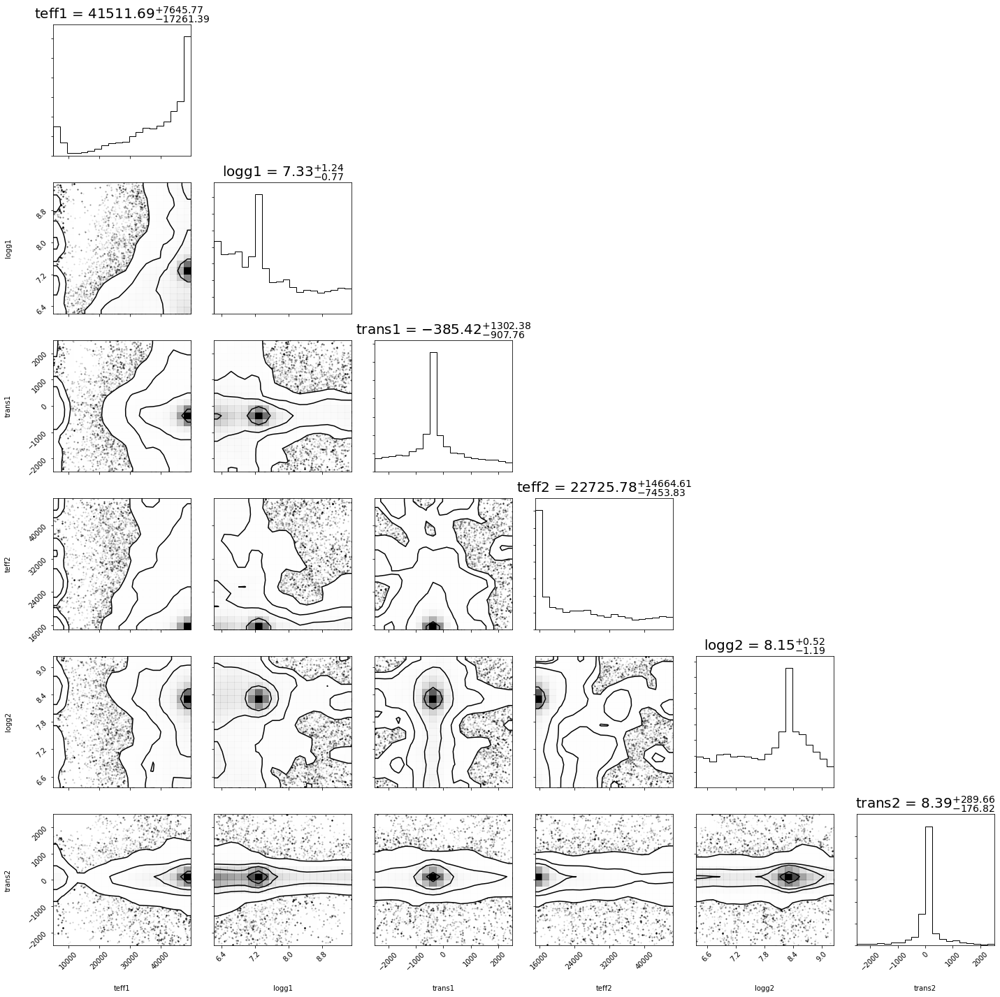

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2990
    # variables        = 6
    chi-square         = 4.75584798
    reduced chi-square = 0.00159378
    Akaike info crit   = -19254.5244
    Bayesian info crit = -19218.5062
[[Variables]]
    teff1:   41511.6941 +/- 12501.0842 (30.11%) (init = 49935.89)
    logg1:   7.32580888 +/- 1.00799342 (13.76%) (init = 7.334362)
    trans1: -385.417127 +/- 1113.09963 (288.80%) (init = -385.5017)
    teff2:   22725.7759 +/- 11078.4929 (48.75%) (init = 15000)
    logg2:   8.14934041 +/- 0.85871451 (10.54%) (init = 8.351194)
    trans2:  8.38708684 +/- 239.297569 (2853.17%) (init = 7.66776)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, teff2) = -0.311
    C(teff2, logg2) = -0.114


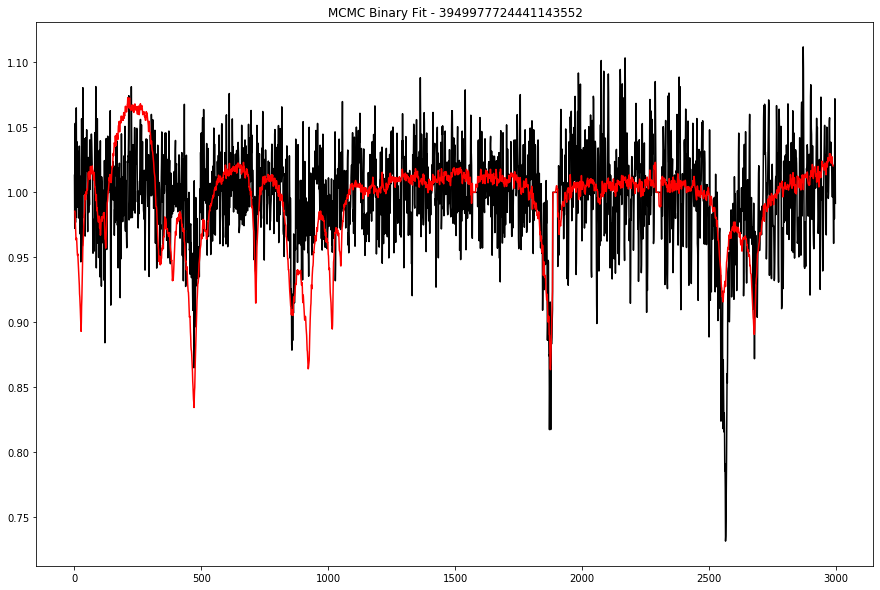

 81%|████████  | 25/31 [23:51<05:38, 56.34s/it]

Fitting with Powell...


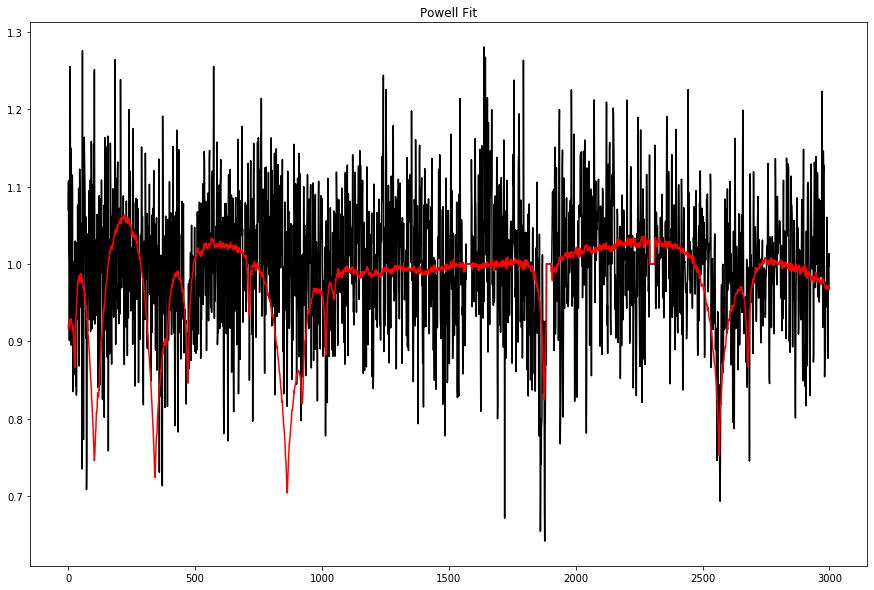

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 365
    # data points      = 2989
    # variables        = 6
    chi-square         = 19.1802209
    reduced chi-square = 0.00642984
    Akaike info crit   = -15078.9068
    Bayesian info crit = -15042.8906
##  Warning: uncertainties could not be estimated:
    teff2:   at initial value
    teff2:   at boundary
[[Variables]]
    teff1:   49957.5040 +/-        nan (nan%) (init = 15000)
    logg1:   6.98515548 +/- 0.14678211 (2.10%) (init = 8)
    trans1:  800.596068 +/- 826.898533 (103.29%) (init = 0)
    teff2:   15000.0001 +/- 0.24046097 (0.00%) (init = 15000)
    logg2:   8.12795216 +/- 0.07508541 (0.92%) (init = 8)
    trans2:  1.38131971 +/- 90.0310680 (6517.76%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(logg2, trans2) =  0.818
    C(logg1, trans1) = -0.321
    C(trans1, logg2) =  0.250

 Starting Bayesian Sampling................
...Done.


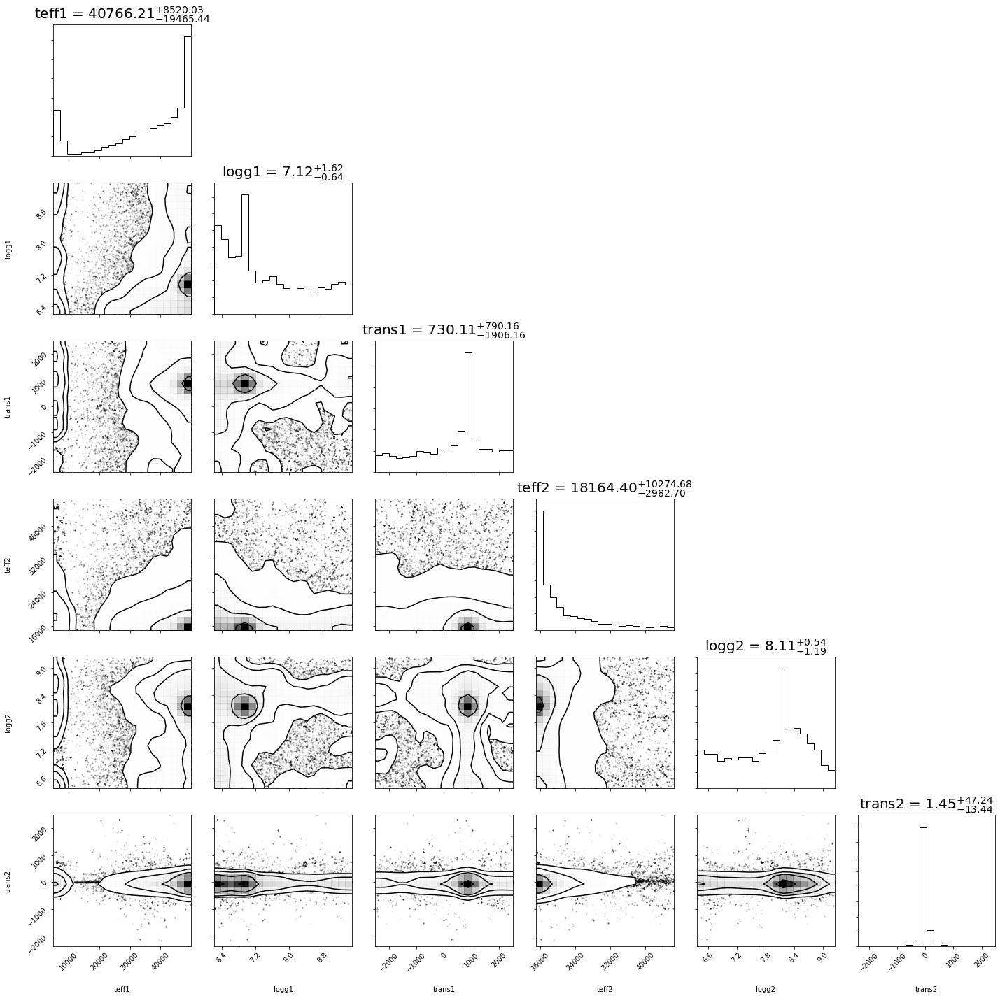

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2990
    # variables        = 6
    chi-square         = 19.7271377
    reduced chi-square = 0.00661097
    Akaike info crit   = -15000.8900
    Bayesian info crit = -14964.8718
[[Variables]]
    teff1:   40766.2145 +/- 14070.6428 (34.52%) (init = 49957.5)
    logg1:   7.11852882 +/- 1.13388979 (15.93%) (init = 6.985155)
    trans1:  730.111786 +/- 1357.53472 (185.94%) (init = 800.5971)
    teff2:   18164.3954 +/- 6648.03157 (36.60%) (init = 15000)
    logg2:   8.10575581 +/- 0.87115021 (10.75%) (init = 8.127952)
    trans2:  1.44794349 +/- 31.1068950 (2148.35%) (init = 1.38132)
[[Correlations]] (unreported correlations are < 0.100)
    C(trans1, teff2) = -0.203
    C(teff1, teff2)  = -0.199
    C(teff2, trans2) =  0.120


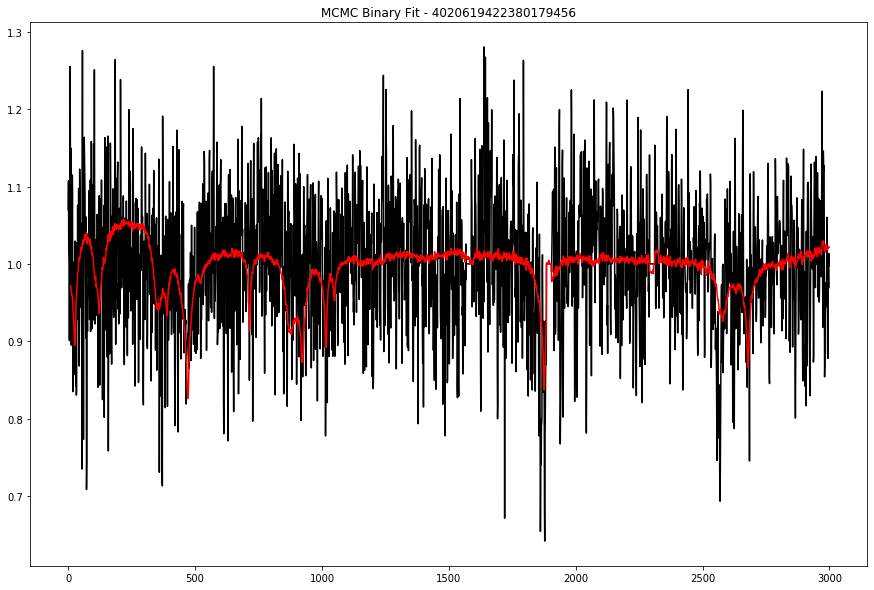

 84%|████████▍ | 26/31 [24:45<04:38, 55.64s/it]

Fitting with Powell...


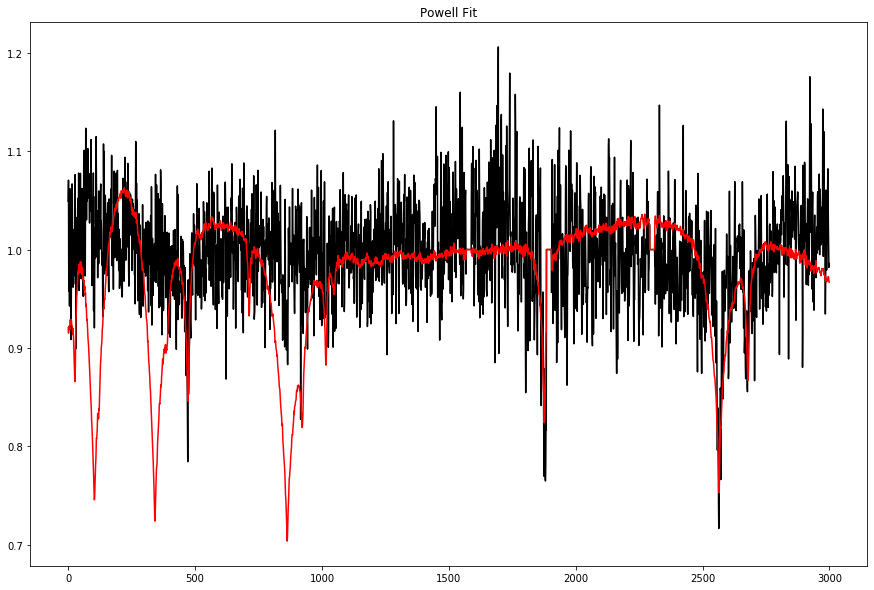

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 322
    # data points      = 2998
    # variables        = 6
    chi-square         = 6.00131286
    reduced chi-square = 0.00200579
    Akaike info crit   = -18616.7398
    Bayesian info crit = -18580.7056
##  Warning: uncertainties could not be estimated:
    teff2:   at initial value
    teff2:   at boundary
[[Variables]]
    teff1:   49942.6406 +/-        nan (nan%) (init = 15000)
    logg1:   6.96046339 +/- 0.07398245 (1.06%) (init = 8)
    trans1: -1.7908e-08 +/- 112.755645 (629640138123.66%) (init = 0)
    teff2:   15000.0000 +/- 4.0531e-08 (0.00%) (init = 15000)
    logg2:   8.20588023 +/- 0.03272594 (0.40%) (init = 8)
    trans2:  20.0428073 +/- 27.2959348 (136.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(logg2, trans2) = -0.404
    C(logg1, logg2)  = -0.164
    C(trans1, logg2) =  0.123

 Starting Bayesian Sampling................
...Done.


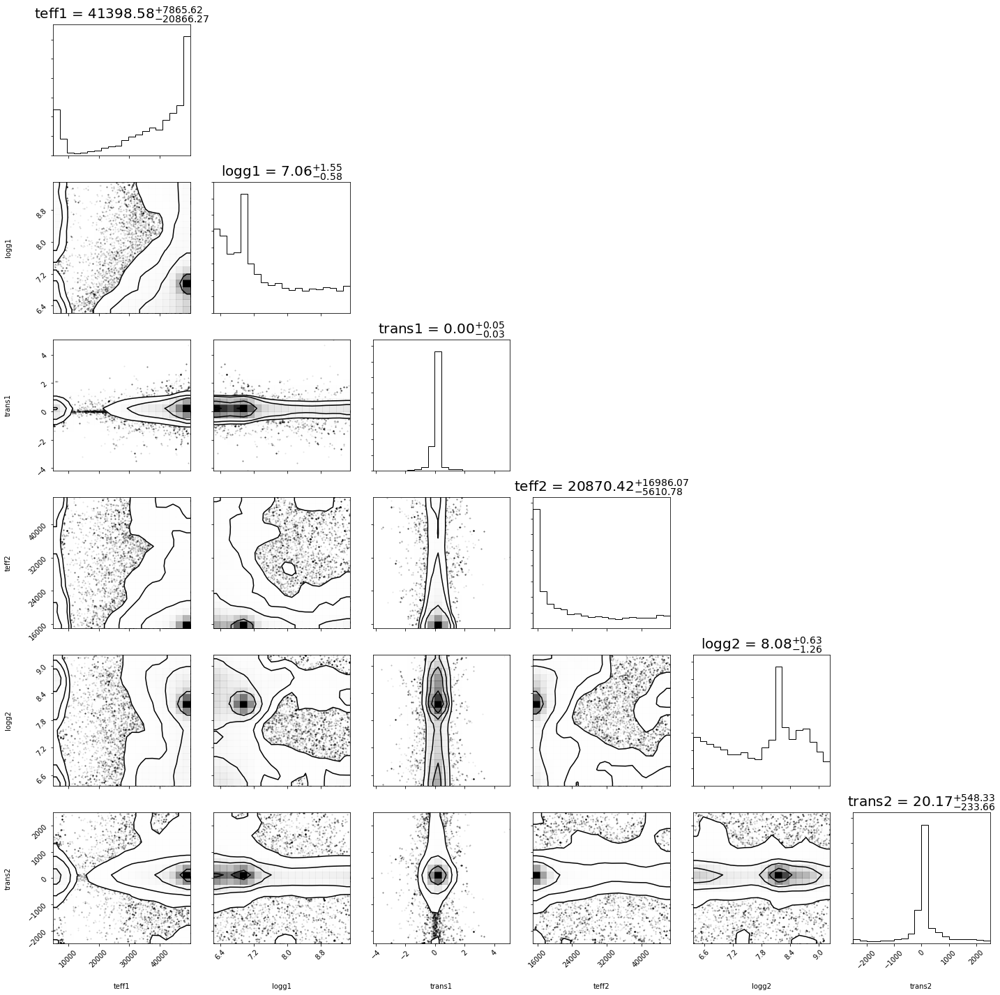

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2999
    # variables        = 6
    chi-square         = 7.38334634
    reduced chi-square = 0.00246687
    Akaike info crit   = -18002.4148
    Bayesian info crit = -17966.3786
[[Variables]]
    teff1:   41398.5754 +/- 14509.6825 (35.05%) (init = 49942.64)
    logg1:   7.06471870 +/- 1.07007618 (15.15%) (init = 6.960463)
    trans1:  0.00100030 +/- 0.04196838 (4195.57%) (init = 0.0009999821)
    teff2:   20870.4239 +/- 11358.6624 (54.42%) (init = 15000)
    logg2:   8.07548335 +/- 0.94929986 (11.76%) (init = 8.20588)
    trans2:  20.1725287 +/- 398.241189 (1974.18%) (init = 20.04281)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, teff2)  = -0.273
    C(teff2, logg2)  = -0.153
    C(teff1, logg1)  = -0.139
    C(teff2, trans2) =  0.117


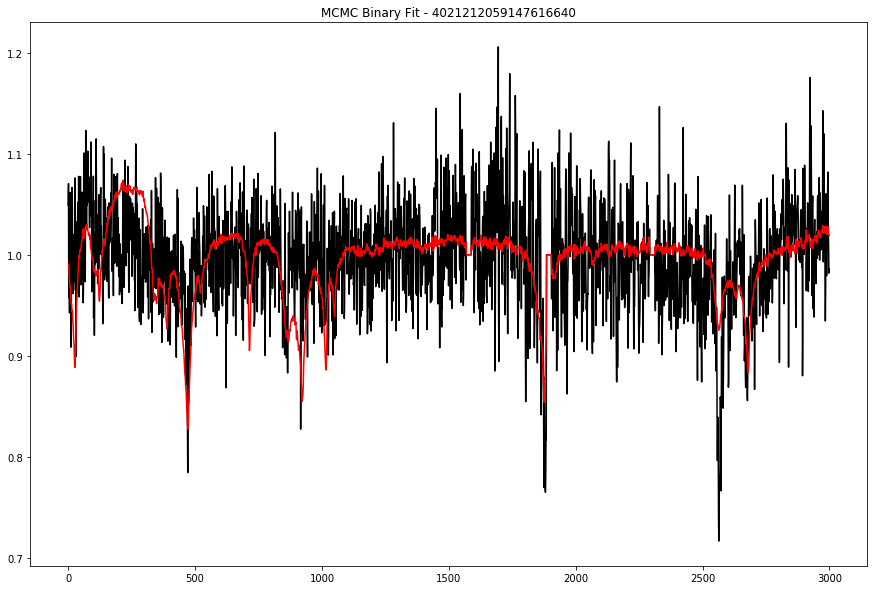

 87%|████████▋ | 27/31 [25:39<03:41, 55.33s/it]

Fitting with Powell...


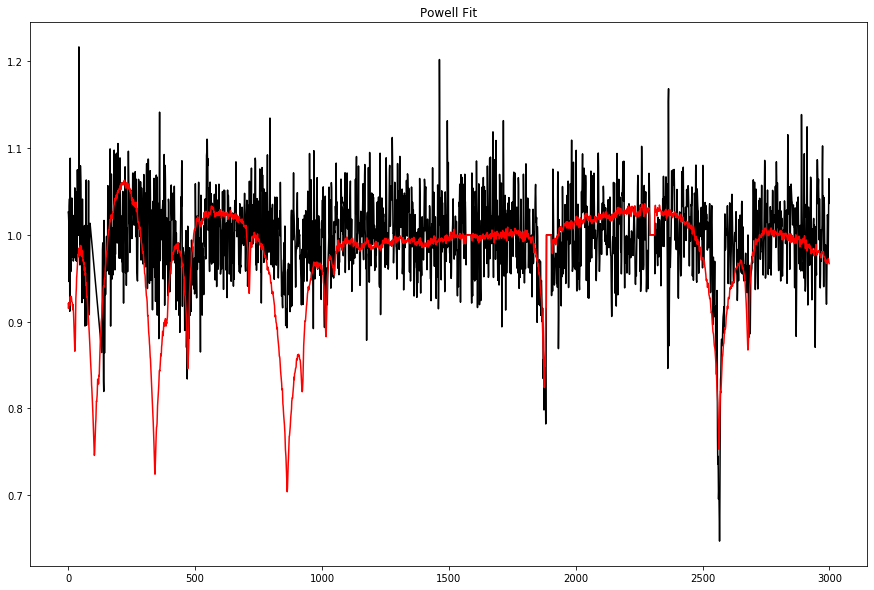

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 682
    # data points      = 2995
    # variables        = 6
    chi-square         = 5.79771124
    reduced chi-square = 0.00193968
    Akaike info crit   = -18698.4727
    Bayesian info crit = -18662.4445
[[Variables]]
    teff1:   39193.8338 +/- 963.371715 (2.46%) (init = 15000)
    logg1:   7.32666761 +/- 0.09598867 (1.31%) (init = 8)
    trans1: -57.9844921 +/- 57.8720491 (99.81%) (init = 0)
    teff2:   15000.0008 +/- 0.59939834 (0.00%) (init = 15000)
    logg2:   8.29790276 +/- 0.03853984 (0.46%) (init = 8)
    trans2:  177.340375 +/- 31.0466749 (17.51%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, logg1)  =  0.559
    C(logg1, trans1) =  0.185

 Starting Bayesian Sampling................
...Done.


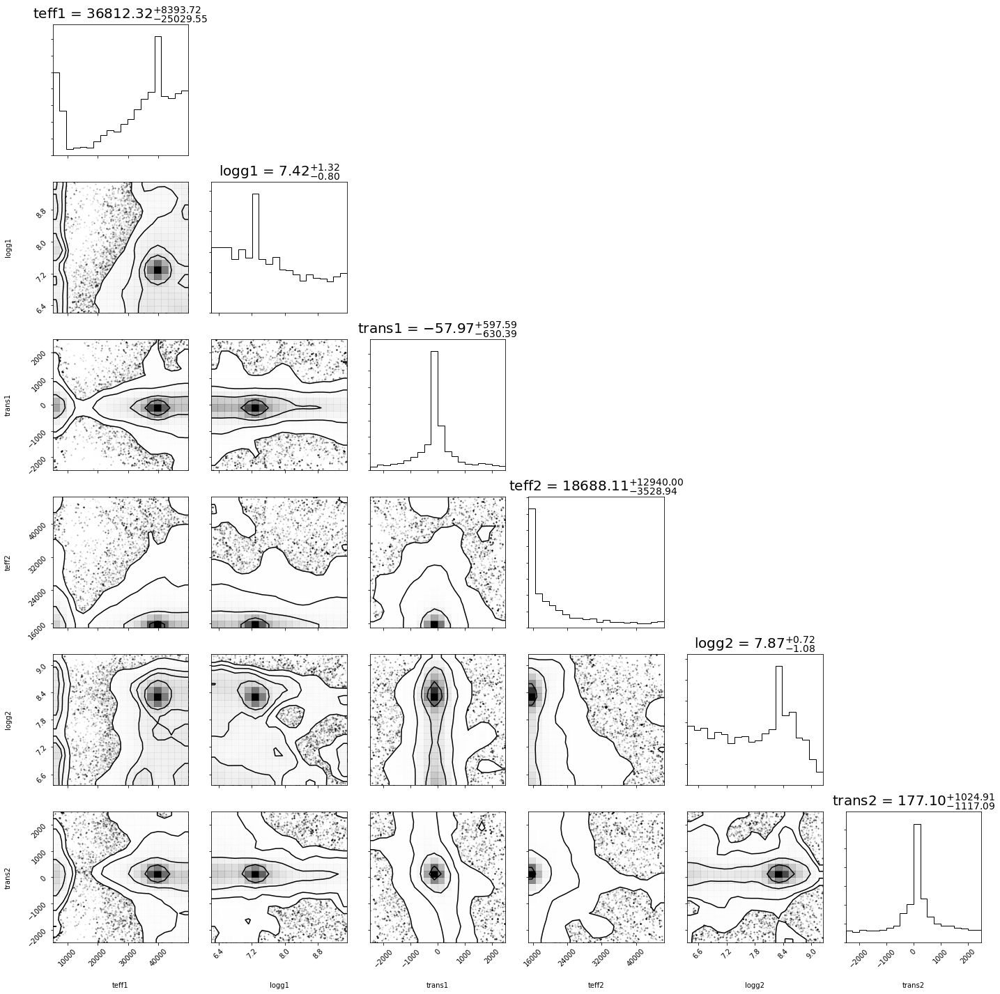

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2995
    # variables        = 6
    chi-square         = 7.07635908
    reduced chi-square = 0.00236747
    Akaike info crit   = -18101.5803
    Bayesian info crit = -18065.5521
[[Variables]]
    teff1:   36812.3249 +/- 16888.4792 (45.88%) (init = 39193.83)
    logg1:   7.42302201 +/- 1.06406022 (14.33%) (init = 7.326668)
    trans1: -57.9663873 +/- 620.052469 (1069.68%) (init = -57.98349)
    teff2:   18688.1073 +/- 8287.02829 (44.34%) (init = 15000)
    logg2:   7.87046660 +/- 0.90552601 (11.51%) (init = 8.297903)
    trans2:  177.095031 +/- 1084.37785 (612.31%) (init = 177.3404)
[[Correlations]] (unreported correlations are < 0.100)
    C(trans1, trans2) = -0.188
    C(teff2, logg2)   = -0.171


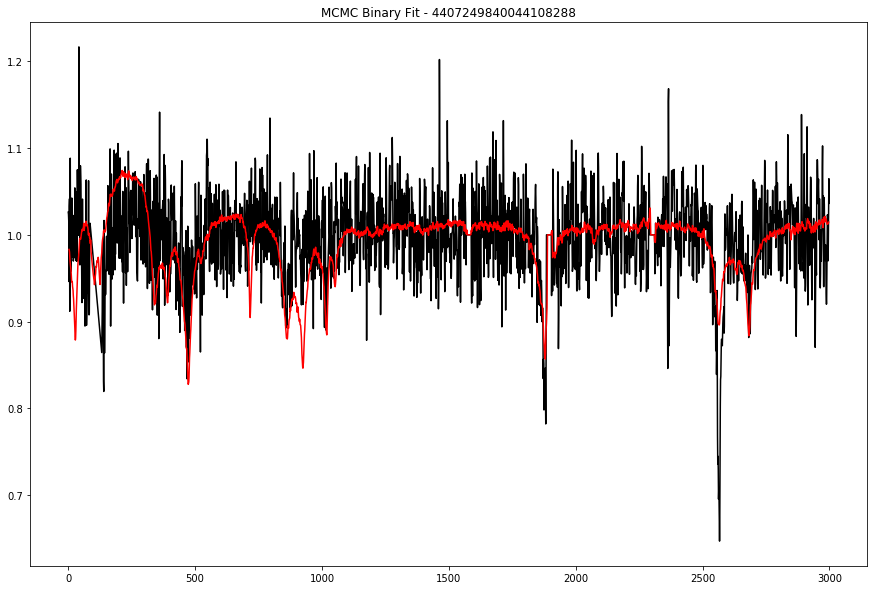

 90%|█████████ | 28/31 [26:34<02:45, 55.06s/it]

Fitting with Powell...


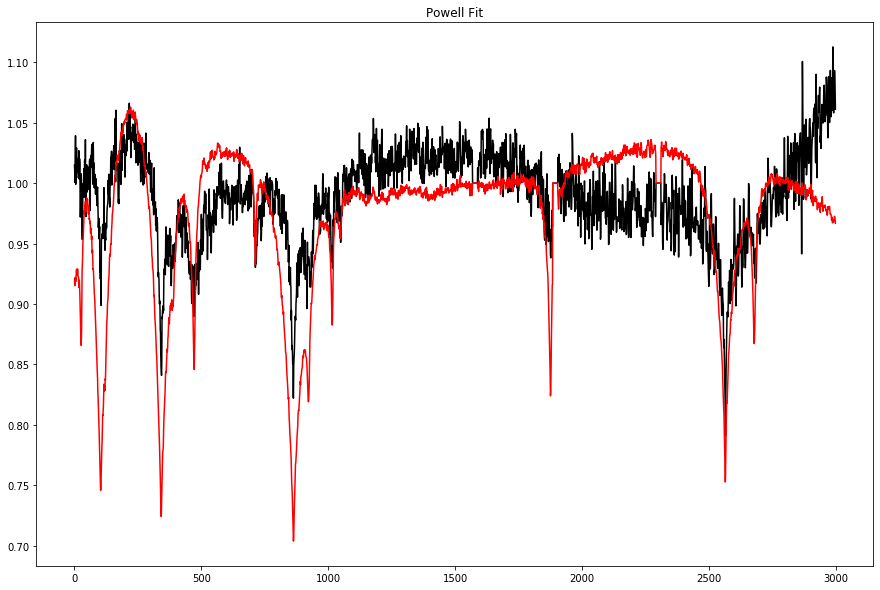

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 355
    # data points      = 2998
    # variables        = 6
    chi-square         = 1.64282637
    reduced chi-square = 5.4907e-04
    Akaike info crit   = -22500.8290
    Bayesian info crit = -22464.7948
[[Variables]]
    teff1:   49961.2659 +/- 0.28543347 (0.00%) (init = 15000)
    logg1:   8.05471137 +/- 0.02829855 (0.35%) (init = 8)
    trans1:  26.4709389 +/- 23.0366171 (87.03%) (init = 0)
    teff2:   15000.0000 +/- 2.2071e-08 (0.00%) (init = 15000)
    logg2:   8.38940669 +/- 0.02311523 (0.28%) (init = 8)
    trans2:  64.2889837 +/- 23.8572188 (37.11%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(logg1, logg2)  = -0.145
    C(trans1, logg2) = -0.107

 Starting Bayesian Sampling................
...Done.


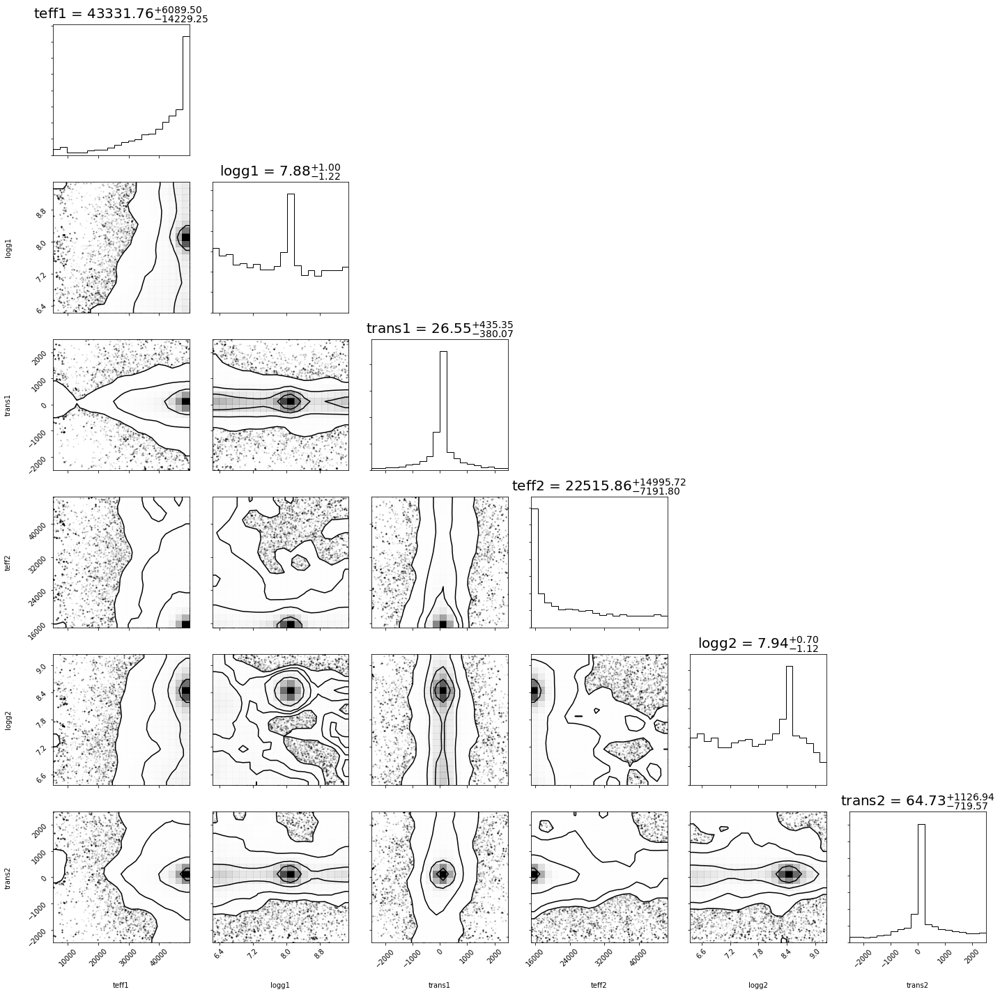

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2999
    # variables        = 6
    chi-square         = 2.50262433
    reduced chi-square = 8.3616e-04
    Akaike info crit   = -21246.9941
    Bayesian info crit = -21210.9579
[[Variables]]
    teff1:   43331.7589 +/- 10202.3879 (23.54%) (init = 49961.27)
    logg1:   7.88405530 +/- 1.11343849 (14.12%) (init = 8.054711)
    trans1:  26.5464552 +/- 413.281186 (1556.82%) (init = 26.47194)
    teff2:   22515.8619 +/- 11124.1258 (49.41%) (init = 15000)
    logg2:   7.93851405 +/- 0.91362327 (11.51%) (init = 8.389407)
    trans2:  64.7306138 +/- 929.361797 (1435.74%) (init = 64.28898)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, teff2)   = -0.364
    C(teff1, logg2)   =  0.187
    C(teff2, logg2)   = -0.183
    C(teff1, logg1)   =  0.137
    C(trans1, teff2)  =  0.132
    C(teff1, trans2)  = -0.120
    C(teff1, trans1)  = -0.120
    C(trans1, trans2) =  0.112


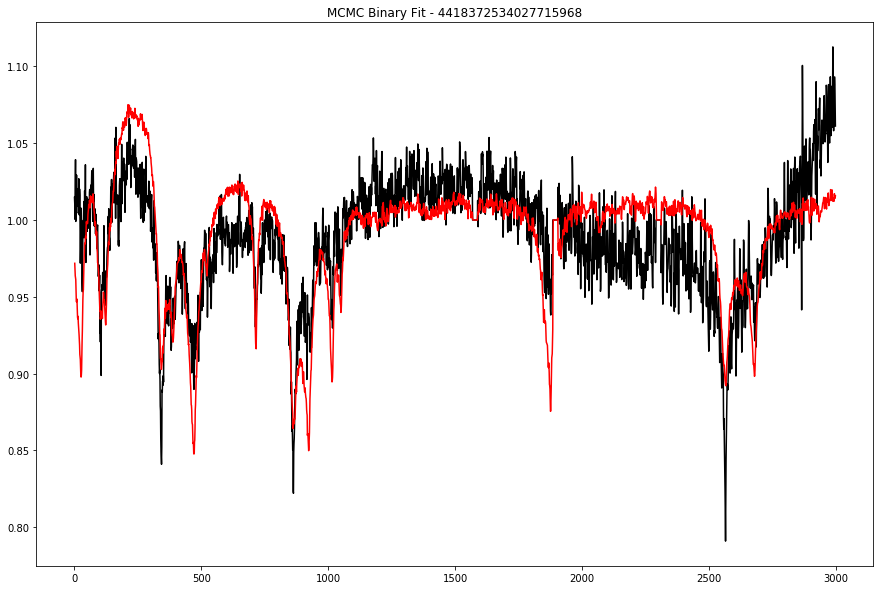

 94%|█████████▎| 29/31 [27:28<01:49, 54.95s/it]

Fitting with Powell...


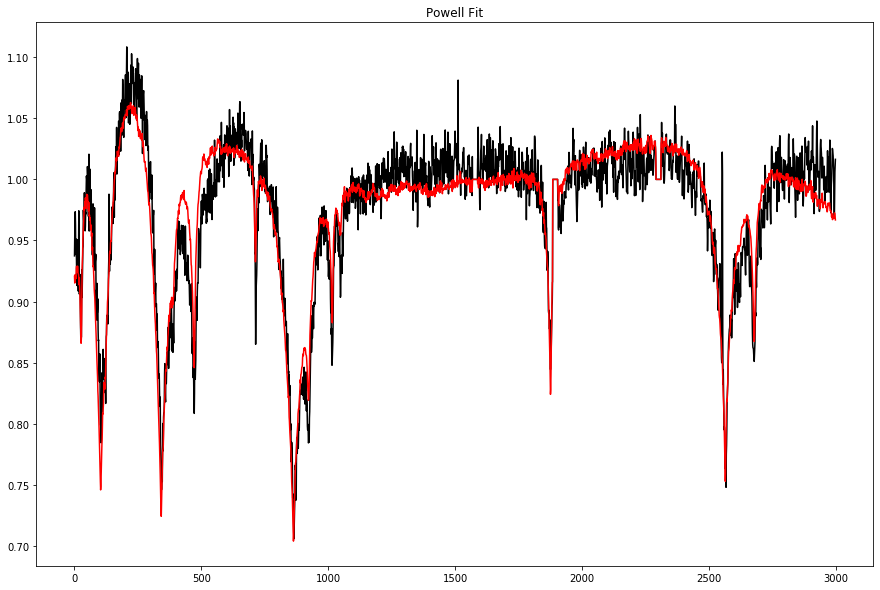

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 1115
    # data points      = 2997
    # variables        = 6
    chi-square         = 0.91967364
    reduced chi-square = 3.0748e-04
    Akaike info crit   = -24231.0431
    Bayesian info crit = -24195.0109
[[Variables]]
    teff1:   21153.6745 +/- 284.738018 (1.35%) (init = 15000)
    logg1:   8.81150590 +/- 0.04542196 (0.52%) (init = 8)
    trans1:  149.896458 +/- 12.5375159 (8.36%) (init = 0)
    teff2:   21643.0991 +/- 277.380424 (1.28%) (init = 15000)
    logg2:   8.21337235 +/- 0.02145554 (0.26%) (init = 8)
    trans2:  12.8435597 +/- 7.96876738 (62.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff2, logg2)  =  0.821
    C(teff1, logg1)  =  0.792
    C(trans1, logg2) =  0.250
    C(teff2, trans2) =  0.174
    C(trans1, teff2) =  0.118

 Starting Bayesian Sampling................
...Done.


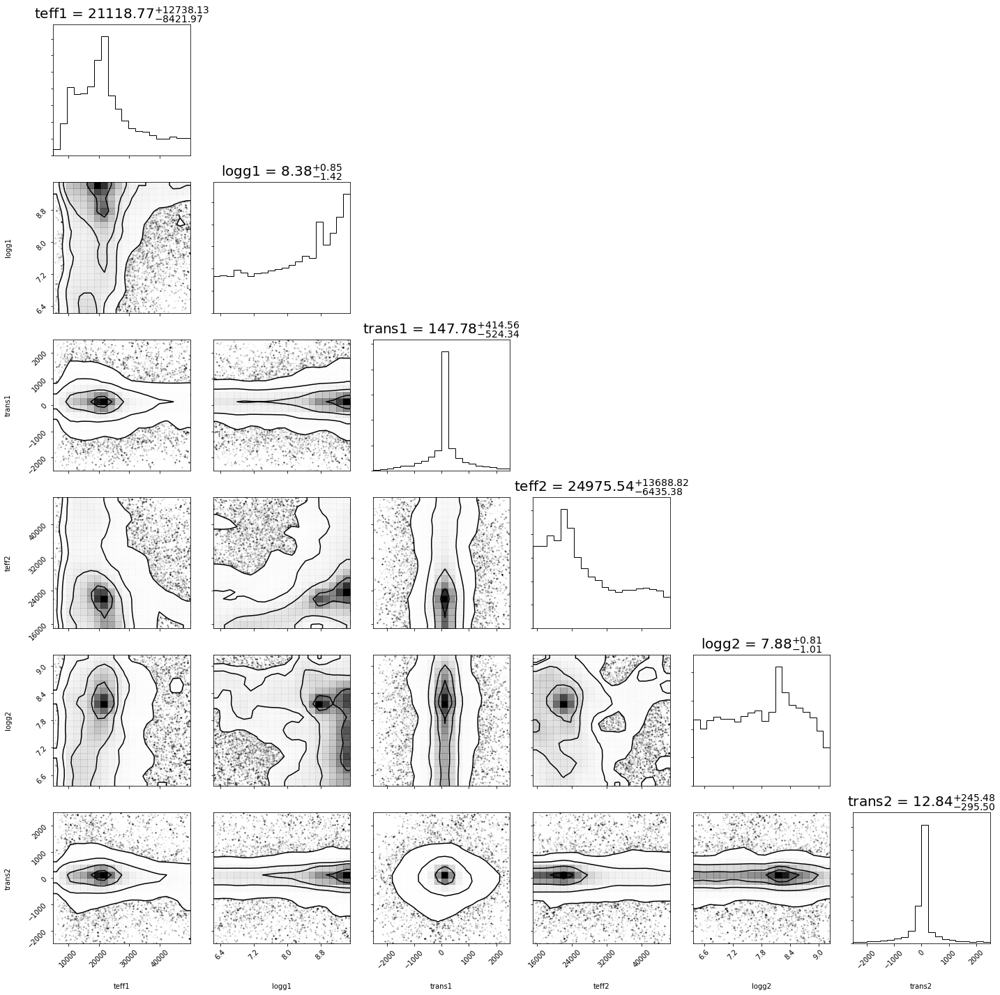

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2998
    # variables        = 6
    chi-square         = 1.05291447
    reduced chi-square = 3.5191e-04
    Akaike info crit   = -23834.5077
    Bayesian info crit = -23798.4735
[[Variables]]
    teff1:   21118.7660 +/- 10638.1579 (50.37%) (init = 21153.67)
    logg1:   8.38180316 +/- 1.13849214 (13.58%) (init = 8.811506)
    trans1:  147.778074 +/- 473.937577 (320.71%) (init = 149.8975)
    teff2:   24975.5397 +/- 10093.0595 (40.41%) (init = 21643.1)
    logg2:   7.87607987 +/- 0.90965670 (11.55%) (init = 8.213372)
    trans2:  12.8394218 +/- 274.868571 (2140.82%) (init = 12.84356)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, logg1) =  0.145


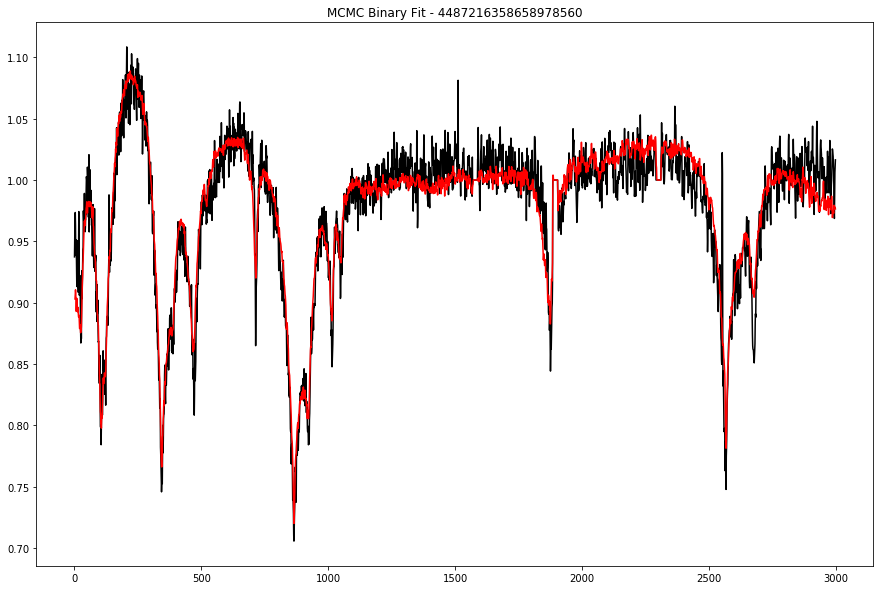

 97%|█████████▋| 30/31 [28:28<00:56, 56.39s/it]

Fitting with Powell...


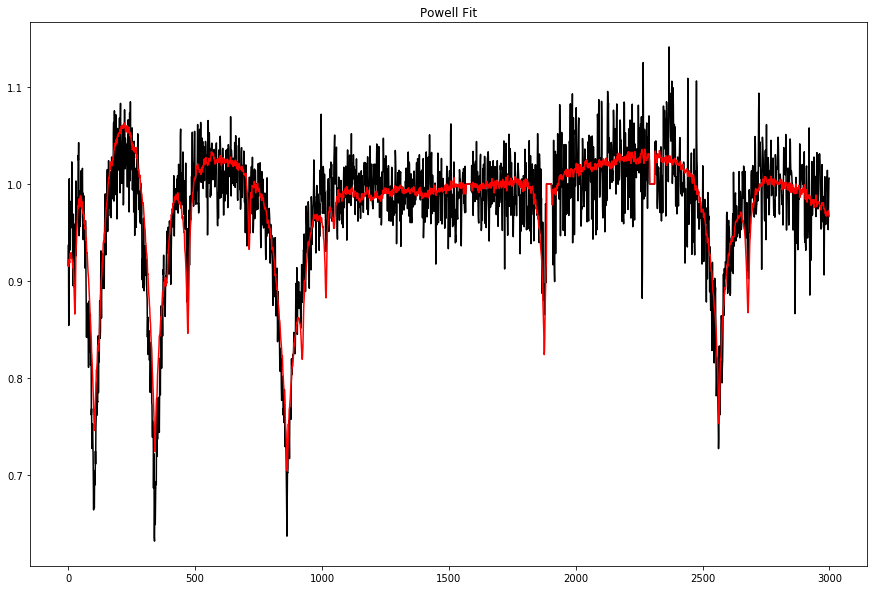

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 347
    # data points      = 2996
    # variables        = 6
    chi-square         = 2.61224784
    reduced chi-square = 8.7366e-04
    Akaike info crit   = -21094.2875
    Bayesian info crit = -21058.2573
##  Warning: uncertainties could not be estimated:
    teff2:   at initial value
    teff2:   at boundary
[[Variables]]
    teff1:   12823.9261 +/-        nan (nan%) (init = 15000)
    logg1:   7.90487908 +/-        nan (nan%) (init = 8)
    trans1: -89.3851962 +/- 15.1160608 (16.91%) (init = 0)
    teff2:   15000.0001 +/- 0.04434027 (0.00%) (init = 15000)
    logg2:   8.35970280 +/- 0.01279197 (0.15%) (init = 8)
    trans2:  11.2307609 +/- 26.2293760 (233.55%) (init = 0)

 Starting Bayesian Sampling................
...Done.


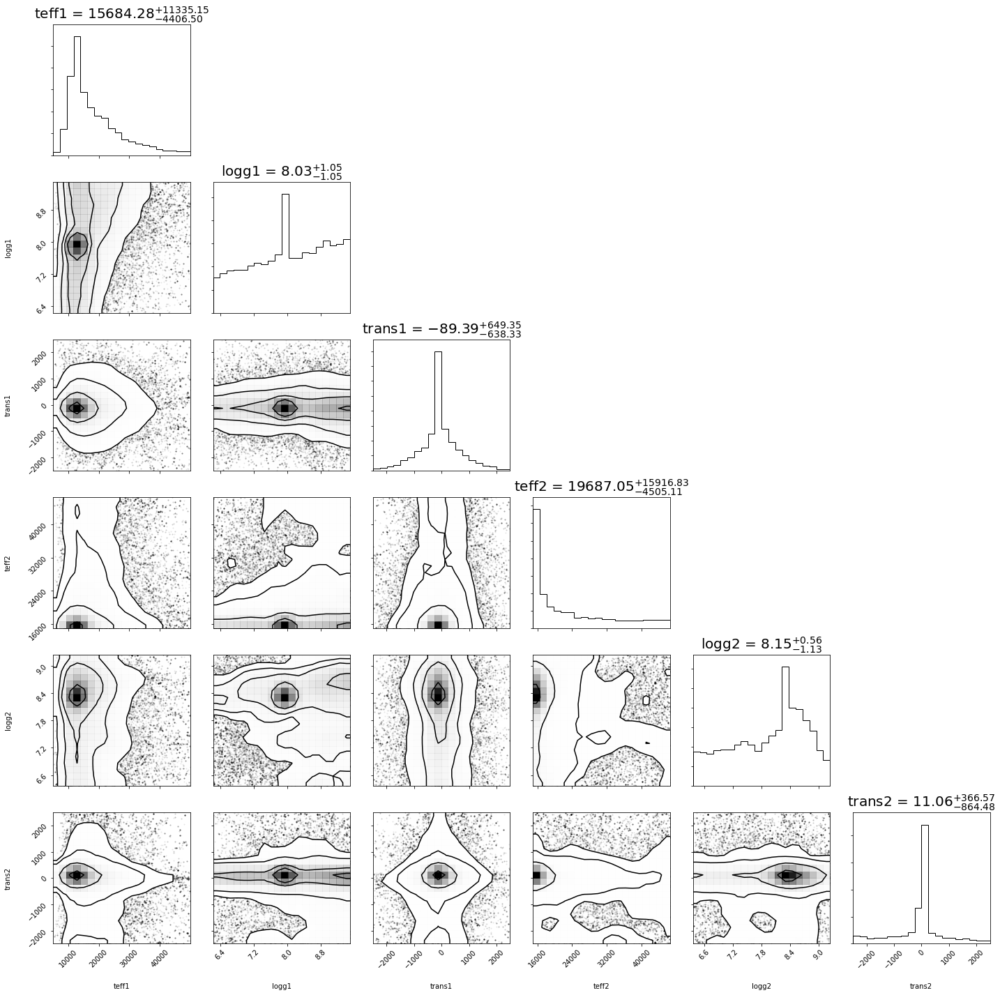

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 50000
    # data points      = 2996
    # variables        = 6
    chi-square         = 4.01660329
    reduced chi-square = 0.00134335
    Akaike info crit   = -19805.3319
    Bayesian info crit = -19769.3017
[[Variables]]
    teff1:   15684.2765 +/- 7897.96580 (50.36%) (init = 12823.93)
    logg1:   8.02574590 +/- 1.05481847 (13.14%) (init = 7.904879)
    trans1: -89.3850720 +/- 648.908847 (725.97%) (init = -89.3842)
    teff2:   19687.0501 +/- 10274.0877 (52.19%) (init = 15000)
    logg2:   8.14964698 +/- 0.85091996 (10.44%) (init = 8.359703)
    trans2:  11.0623014 +/- 623.797857 (5638.95%) (init = 11.23076)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, logg1) =  0.250
    C(teff1, teff2) =  0.204
    C(teff2, logg2) = -0.155


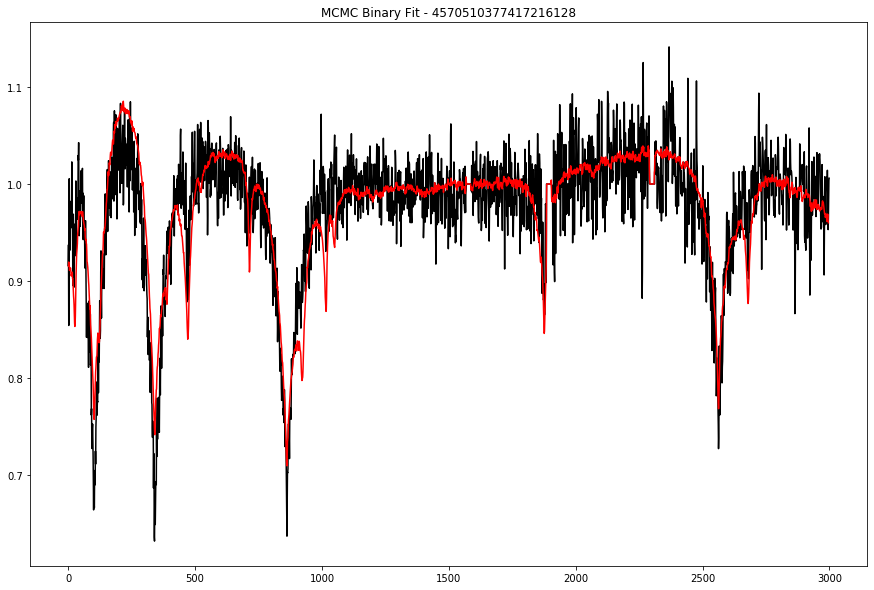

100%|██████████| 31/31 [29:26<00:00, 56.87s/it]


In [77]:
fitter = lmfit.Model(binary_sampler)
params = fitter.make_params(teff1 = 15000,logg1=8,trans1=0.,teff2 = 15000.,logg2=8.,trans2=0.)

params['teff1'].set(min=np.min(DAteffs),max=np.max(DAteffs))
params['logg1'].set(min=np.min(DAloggs),max=np.max(DAloggs))
params['teff2'].set(min=15000,max=np.max(DBteffs))
params['logg2'].set(min=np.min(DBloggs),max=np.max(DBloggs))
params['trans1'].set(min=-2500,max=2500)
params['trans2'].set(min=-2500,max=2500)
#params['prop'].set(min=0,max=1)

bayesparams = fitter.make_params(teff1 = 0.,logg1=8.,trans1=0.,teff2 = 0.,logg2=8.,trans2=0.)
bayesparams['teff1'].set(min=np.min(DAteffs),max=np.max(DAteffs))
bayesparams['logg1'].set(min=np.min(DAloggs),max=np.max(DAloggs))
bayesparams['teff2'].set(min=15000,max=np.max(DBteffs))
bayesparams['logg2'].set(min=np.min(DBloggs),max=np.max(DBloggs))
bayesparams['trans1'].set(min=-2500,max=2500)
bayesparams['trans2'].set(min=-2500,max=2500)
#bayesparams['prop'].set(min=0,max=1)

fitoutput = np.zeros((len(normspec),9))
bayesoutput = np.zeros((len(normspec),13))
for i in tqdm(range(len(normspec))):
    spec = normspec[i]
    fitoutput[i,0] = candidates[i]
    bayesoutput[i,0] = candidates[i]
    print('Fitting with Powell...')
    result = fitter.fit(spec*modelscaling,params,wl=lamgrid,method="powell",nan_policy='omit',calc_covar=True,)
                       #fit_kws={'reduce_fcn':chisquare})
    
    fitoutput[i,1] = result.params['teff1'].value
    fitoutput[i,2] = result.params['teff1'].stderr
    fitoutput[i,3] = result.params['logg1'].value
    fitoutput[i,4] = result.params['logg1'].stderr
    fitoutput[i,5] = result.params['teff2'].value
    fitoutput[i,6] = result.params['teff2'].stderr
    fitoutput[i,7] = result.params['logg2'].value
    fitoutput[i,8] = result.params['logg2'].stderr
    
    plt.figure(figsize=(15,10))
    plt.plot(spec*modelscaling,'k')
    plt.plot(result.eval(params,wl=lamgrid),'r')
    plt.title('Powell Fit')
    plt.show()
    print(lmfit.fit_report(result))
    
    # BAYESIAN FITTING ##
    
    bayesparams['teff1'].set(value = result.params['teff1'].value)
    bayesparams['logg1'].set(value = result.params['logg1'].value)
    bayesparams['teff2'].set(value = result.params['teff2'].value)
    bayesparams['logg2'].set(value = result.params['logg2'].value)
    bayesparams['trans1'].set(value = result.params['trans1'].value+0.001,vary=True)
    bayesparams['trans2'].set(value = result.params['trans2'].value)
    #bayesparams['prop'].set(value = result.params['prop'].value)
    print('\n Starting Bayesian Sampling................')
    bayesresult = fitter.fit(spec*modelscaling,bayesparams,wl=lamgrid,method="emcee",nan_policy='omit',\
                             calc_covar=True, fit_kws={'nwalkers':100,'steps':500,'reduce_fcn':chisquare})
    print('...Done.')
    fig,axs = plt.subplots(len(params),len(params),figsize=(20,20))
    f = corner.corner(bayesresult.flatchain[['teff1','logg1','trans1','teff2','logg2','trans2']],\
                      smooth=1,show_titles=True,fig=fig,title_kwargs={'fontsize':20})
    plt.tight_layout()
    plt.savefig('plots/doublestars/'+str(candidates[i])+'_corner.png')
    plt.show()
    print(lmfit.fit_report(bayesresult))
    plt.figure(figsize=(15,10))
    plt.plot(spec*modelscaling,'k')
    plt.plot(fitter.eval(bayesresult.params,wl=lamgrid),'r')    
    plt.title('MCMC Binary Fit - '+str(candidates[i]))
    plt.savefig('plots/doublestars/'+str(candidates[i])+'_fit.png')
    plt.show()
    bayesoutput[i,1] = bayesresult.params['teff1'].value
    bayesoutput[i,2] = bayesresult.params['teff1'].stderr
    bayesoutput[i,3] = bayesresult.params['logg1'].value
    bayesoutput[i,4] = bayesresult.params['logg1'].stderr
    bayesoutput[i,5] = bayesresult.params['teff2'].value
    bayesoutput[i,6] = bayesresult.params['teff2'].stderr
    bayesoutput[i,7] = bayesresult.params['logg2'].value
    bayesoutput[i,8] = bayesresult.params['logg2'].stderr
    bayesoutput[i,9] = bayesresult.params['trans1'].value
    bayesoutput[i,10] = bayesresult.params['trans1'].stderr
    bayesoutput[i,11] = bayesresult.params['trans2'].value
    bayesoutput[i,12] = bayesresult.params['trans2'].stderr

In [81]:
df = pd.DataFrame(bayesoutput)

In [84]:
df=df.rename(columns = {1:'teff1',3:'logg1',5:'teff2',7:'logg2',9:'trans1',11:'trans2'})

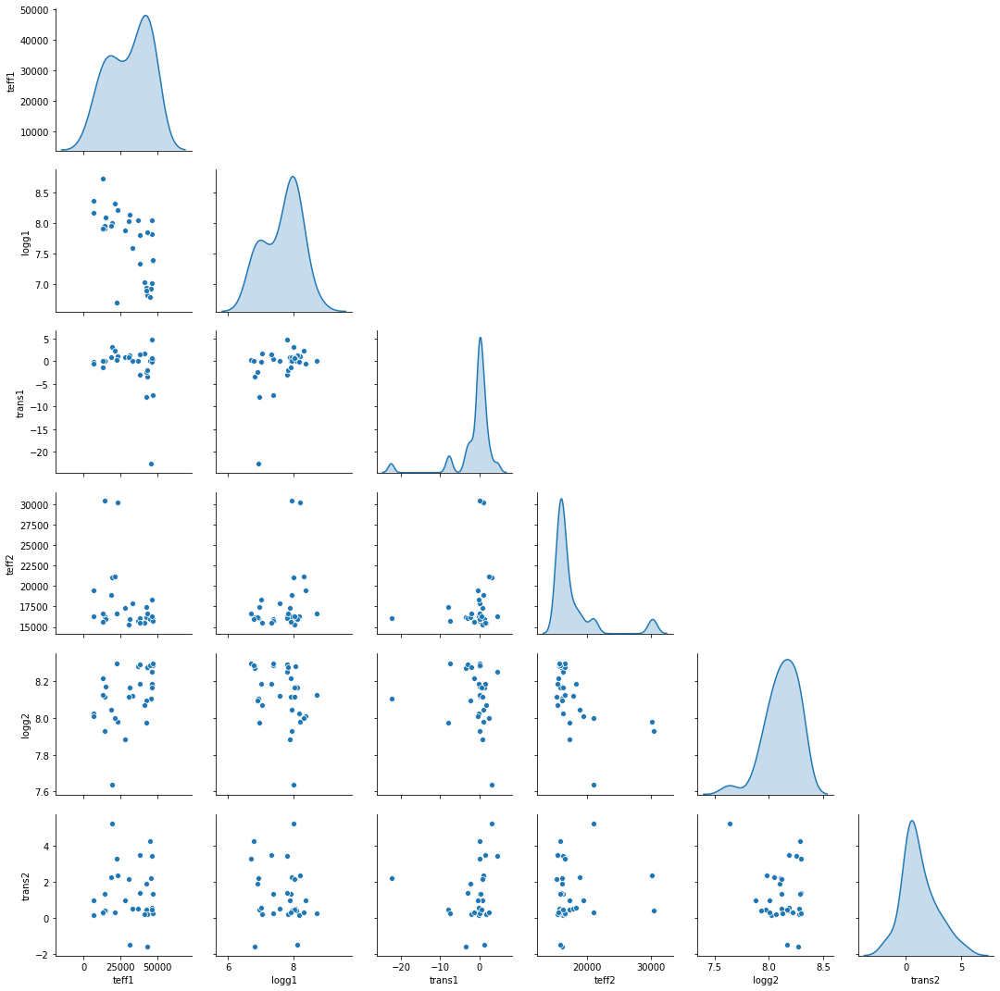

In [85]:
import pandas as pd
import seaborn as sns
g = sns.pairplot(df,diag_kind = 'kde',vars = ['teff1','logg1','trans1','teff2','logg2','trans2'])
for i, j in zip(*np.triu_indices_from(g.axes, 1)):
    g.axes[i, j].set_visible(False)

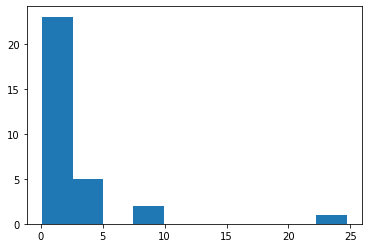

In [89]:
rvdiff = np.abs(df['trans2']  - df['trans1'])
plt.hist(rvdiff,bins=10);

In [91]:
df[rvdiff > 20]

,0,teff1,2,logg1,4,teff2,6,logg2,8,trans1,10,trans2,12
8,8.750890e+17,45936.23883,8965.778363,6.930822,0.978767,16129.532102,2705.973526,8.10633,0.833129,-22.4986,7.089993,2.187634,1.924373


# Convex Combination Binary

In [397]:
def DA_spectrum_sampler(wl,teff,logg,trans):
    label = DAsc.transform(np.asarray(np.stack((teff,logg)).reshape(1,-1)))
    synth = interpolation.shift(np.ravel(
                        DAmsc.inverse_transform(
                                DAmodel.predict(label))[0]
                        ), trans , cval=1
                    )
    return np.ravel(synth).astype('float64')

def DB_spectrum_sampler(wl,teff,logg,trans):
    label = DBsc.transform(np.asarray(np.stack((teff,logg)).reshape(1,-1)))
    synth = interpolation.shift(np.ravel(
        DBmsc.inverse_transform(
            DBmodel.predict(label))[0]
        ),trans,cval=1
    )
    return np.ravel(synth).astype('float64')




modelscaling = 1
from astropy.convolution import Gaussian1DKernel
from scipy.signal import convolve as scipy_convolve

def chisquare(residual):
    return sum(residual**2)

def binary_sampler(wl,teff1,logg1,trans1,teff2,logg2,trans2,prop):
    synth = (prop*DA_spectrum_sampler(wl,teff1,logg1,trans1) + (1-prop)*DA_spectrum_sampler(wl,teff2,logg2,trans2))
    return synth

Text(0.5, 1.0, 'Sample Binary Spectra - H-Beta')

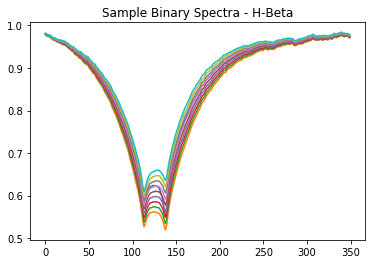

In [405]:
ts = np.linspace(10000,30000,10)

for i in ts:
    plt.plot(binary_sampler(None,15000,8.,0,i,8.,25,0.5)[750:1100])
    
plt.title('Sample Binary Spectra - H-Beta')

In [391]:
candidates = [4487216358658978560]

normspec = [];
for candidate in candidates:
    spec = get_spectrum(candidate)
    lam  = spec[0]
    flux = spec[1]
    func = interp1d(lam,flux,kind='linear',assume_sorted = False,fill_value='extrapolate')
    interpflux = func(lamgrid)
    p,cov = curve_fit(quadratic,lamgrid[mask],interpflux[mask],p0=[-25,1e-2,1e-5,1e-10])
    contcorr = (interpflux/quadratic(lamgrid,p[0],p[1],p[2],p[3]))
    skylinemask = (lamgrid > 5578.5 - 10)*(lamgrid < 5578.5 + 10) + (lamgrid > 5894.6 - 10)*(lamgrid < 5894.6 + 10)\
        + (lamgrid > 6301.7 - 10)*(lamgrid < 6301.7 + 10) + (lamgrid > 7246.0 - 10)*(lamgrid < 7246.0 + 10)
    contcorr[skylinemask] = 1
    where = np.isnan(contcorr)
    contcorr[where] = 1
    normspec.append(contcorr)
len(normspec)

1















  0%|          | 0/1 [00:00<?, ?it/s]

Fitting with Powell...


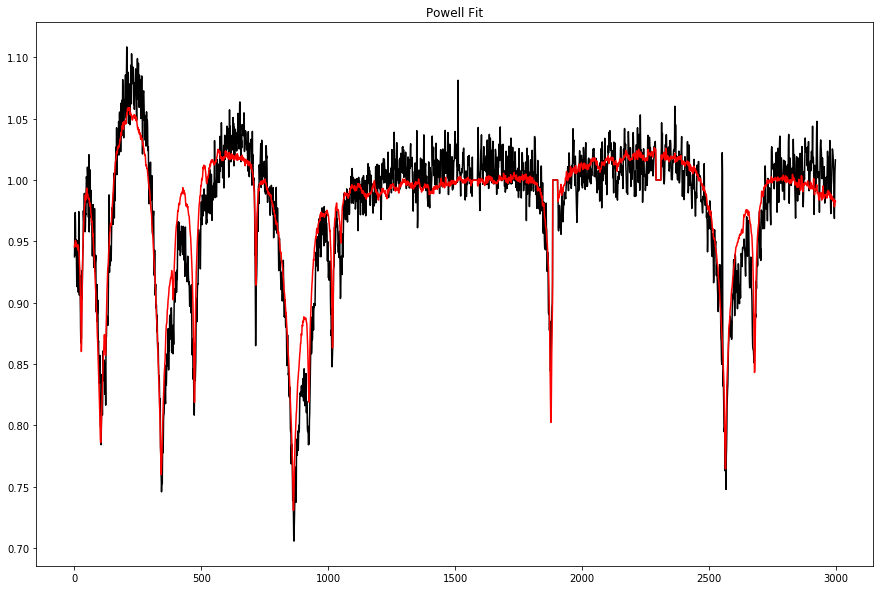

[[Fit Statistics]]
    # fitting method   = Powell
    # function evals   = 905
    # data points      = 3000
    # variables        = 7
    chi-square         = 0.84808206
    reduced chi-square = 2.8336e-04
    Akaike info crit   = -24499.4363
    Bayesian info crit = -24457.3918
[[Variables]]
    teff1:   26684.4360 +/- 309.327667 (1.16%) (init = 20000)
    logg1:   8.91444984 +/- 0.04789660 (0.54%) (init = 8)
    trans1:  1.68754728 +/- 0.18541150 (10.99%) (init = 0)
    teff2:   15503.2693 +/- 117.139491 (0.76%) (init = 15000)
    logg2:   7.55370042 +/- 0.01672846 (0.22%) (init = 8)
    trans2: -1.22193715 +/- 0.13253734 (10.85%) (init = 0)
    prop:    0.56730373 +/- 0.00428817 (0.76%) (init = 0.5)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, prop)   =  0.684
    C(teff2, logg2)  =  0.508
    C(teff1, logg1)  = -0.362
    C(teff1, logg2)  = -0.215
    C(logg2, prop)   = -0.193
    C(teff1, trans1) =  0.146
    C(trans1, prop)  =  0.139
    C(logg1, prop)  

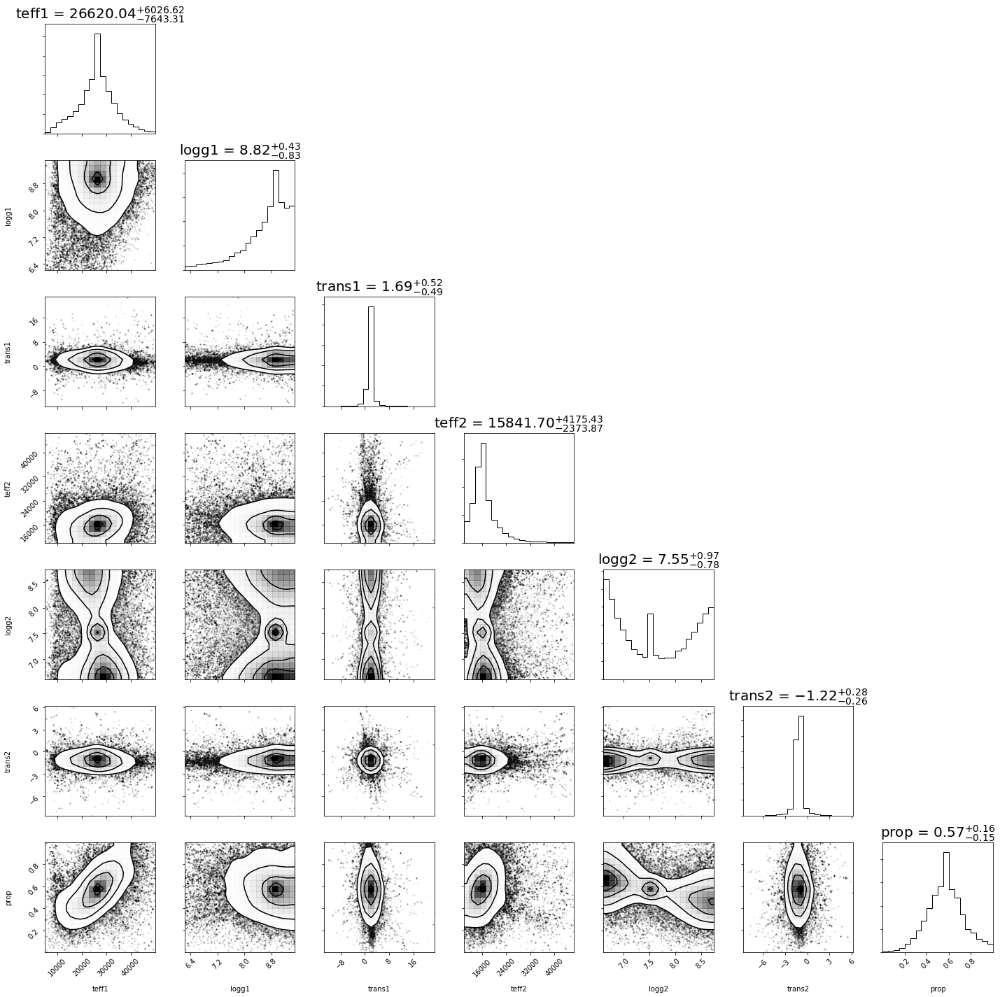

[[Fit Statistics]]
    # fitting method   = emcee
    # function evals   = 125000
    # data points      = 3000
    # variables        = 7
    chi-square         = 0.84922232
    reduced chi-square = 2.8374e-04
    Akaike info crit   = -24495.4055
    Bayesian info crit = -24453.3609
[[Variables]]
    teff1:   26620.0397 +/- 6888.69730 (25.88%) (init = 26684.44)
    logg1:   8.82054477 +/- 0.63307210 (7.18%) (init = 8.91445)
    trans1:  1.68884990 +/- 0.50983349 (30.19%) (init = 1.688547)
    teff2:   15841.6989 +/- 3300.21618 (20.83%) (init = 15503.27)
    logg2:   7.55394467 +/- 0.87663275 (11.60%) (init = 7.5537)
    trans2: -1.22183735 +/- 0.26892266 (22.01%) (init = -1.221937)
    prop:    0.56728388 +/- 0.15593232 (27.49%) (init = 0.5673037)
[[Correlations]] (unreported correlations are < 0.100)
    C(teff1, prop)   =  0.511
    C(logg2, prop)   = -0.443
    C(teff1, logg2)  = -0.256
    C(logg1, teff2)  = -0.194
    C(trans1, prop)  = -0.175
    C(teff1, logg1)  =  0.174
    C(

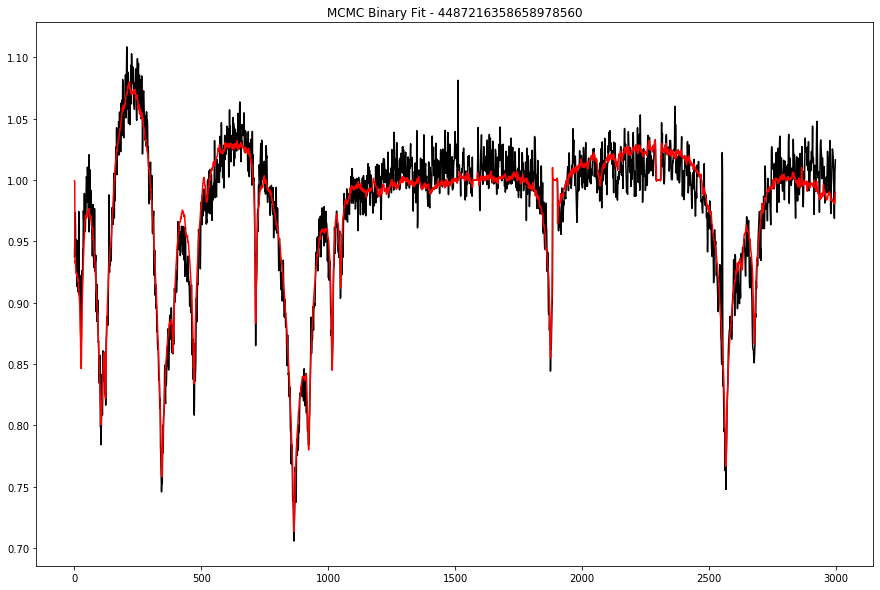















100%|██████████| 1/1 [02:58<00:00, 178.71s/it]

In [393]:
fitter = lmfit.Model(binary_sampler)
params = fitter.make_params(teff1 = 20000,logg1=8,trans1=0.,teff2 = 15000.,logg2=8.,trans2=0.,prop=0.5)

params['teff1'].set(min=np.min(DAteffs),max=np.max(DAteffs))
params['logg1'].set(min=np.min(DAloggs),max=np.max(DAloggs))
params['teff2'].set(min=np.min(DBteffs),max=np.max(DBteffs))
params['logg2'].set(min=np.min(DBloggs),max=np.max(DBloggs))
params['trans1'].set(min=-25,max=25)
params['trans2'].set(min=-25,max=25)
params['prop'].set(min=0,max=1)

bayesparams = fitter.make_params(teff1 = 0.,logg1=10.,trans1=0.,teff2 = 0.,logg2=10.,trans2=0.)
bayesparams['teff1'].set(min=np.min(DAteffs),max=np.max(DAteffs))
bayesparams['logg1'].set(min=np.min(DAloggs),max=np.max(DAloggs))
bayesparams['teff2'].set(min=np.min(DBteffs),max=np.max(DBteffs))
bayesparams['logg2'].set(min=np.min(DBloggs),max=np.max(DBloggs))
bayesparams['trans1'].set(min=-25,max=25)
bayesparams['trans2'].set(min=-25,max=25)
bayesparams['prop'].set(min=0,max=1)

fitoutput = np.zeros((len(normspec),9))
bayesoutput = np.zeros((len(normspec),9))
for i in tqdm(range(len(normspec))):
    spec = normspec[i]
    #fitoutput[i,0] = int(specnames[i][:-12])
    #bayesoutput[i,0] = int(specnames[i][:-12])
    print('Fitting with Powell...')
    result = fitter.fit(spec*modelscaling,params,wl=lamgrid,method="powell",nan_policy='raise',calc_covar=True,)
                       #fit_kws={'reduce_fcn':chisquare})
    
    fitoutput[i,1] = result.params['teff1'].value
    fitoutput[i,2] = result.params['teff1'].stderr
    fitoutput[i,3] = result.params['logg1'].value
    fitoutput[i,4] = result.params['logg1'].stderr
    fitoutput[i,5] = result.params['teff2'].value
    fitoutput[i,6] = result.params['teff2'].stderr
    fitoutput[i,7] = result.params['logg2'].value
    fitoutput[i,8] = result.params['logg2'].stderr
    
    plt.figure(figsize=(15,10))
    plt.plot(spec*modelscaling,'k')
    plt.plot(result.eval(params,wl=lamgrid),'r')
    plt.title('Powell Fit')
    plt.show()
    print(lmfit.fit_report(result))
    
    # BAYESIAN FITTING ##
    
    bayesparams['teff1'].set(value = result.params['teff1'].value)
    bayesparams['logg1'].set(value = result.params['logg1'].value)
    bayesparams['teff2'].set(value = result.params['teff2'].value)
    bayesparams['logg2'].set(value = result.params['logg2'].value)
    bayesparams['trans1'].set(value = result.params['trans1'].value+0.001,vary=True)
    bayesparams['trans2'].set(value = result.params['trans2'].value)
    bayesparams['prop'].set(value = result.params['prop'].value)
    print('\n Starting Bayesian Sampling................')
    bayesresult = fitter.fit(spec*modelscaling,bayesparams,wl=lamgrid,method="emcee",nan_policy='omit',\
                             calc_covar=True, fit_kws={'nwalkers':500,'steps':250,'reduce_fcn':chisquare})
    print('...Done.')
    fig,axs = plt.subplots(len(params),len(params),figsize=(20,20))
    f = corner.corner(bayesresult.flatchain[['teff1','logg1','trans1','teff2','logg2','trans2','prop']],\
                      smooth=1,show_titles=True,fig=fig,title_kwargs={'fontsize':20})
    plt.tight_layout()
    plt.savefig('plots/doublestars/'+str(candidates[i])+'_corner_prop.png')
    plt.show()
    print(lmfit.fit_report(bayesresult))
    plt.figure(figsize=(15,10))
    plt.plot(spec*modelscaling,'k')
    plt.plot(fitter.eval(bayesresult.params,wl=lamgrid),'r')    
    plt.title('MCMC Binary Fit - '+str(candidates[i]))
    plt.savefig('plots/doublestars/'+str(candidates[i])+'_fit_prop.png')
    plt.show()
    bayesoutput[i,1] = bayesresult.params['teff1'].value
    bayesoutput[i,2] = bayesresult.params['teff1'].stderr
    bayesoutput[i,3] = bayesresult.params['logg1'].value
    bayesoutput[i,4] = bayesresult.params['logg1'].stderr
    bayesoutput[i,5] = bayesresult.params['teff2'].value
    bayesoutput[i,6] = bayesresult.params['teff2'].stderr
    bayesoutput[i,7] = bayesresult.params['logg2'].value
    bayesoutput[i,8] = bayesresult.params['logg2'].stderr